In [118]:
library(Signac)
library(Seurat)
library(EnsDb.Hsapiens.v86)
library(BSgenome.Hsapiens.UCSC.hg38)
set.seed(1234)
#library(dplyr)
library(AUCell)
library(GSEABase)
library(ggplot2)
library(future)
library(tidyverse)
library(RCurl)
library(AnnotationHub)
library(ggplot2)
library(ArchR)

In [119]:
options(future.globals.maxSize = 8000 * 1024^2)
library(BiocParallel)
register(SerialParam())

In [120]:
plan("multiprocess", workers = 50)


Warning message:
"Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


In [121]:
load("/disk1/xilu/glioblastoma_single_cell/1.RNA/1.RNA_seq_seurat/glio.int.all.peaks.chromvar.rdata")

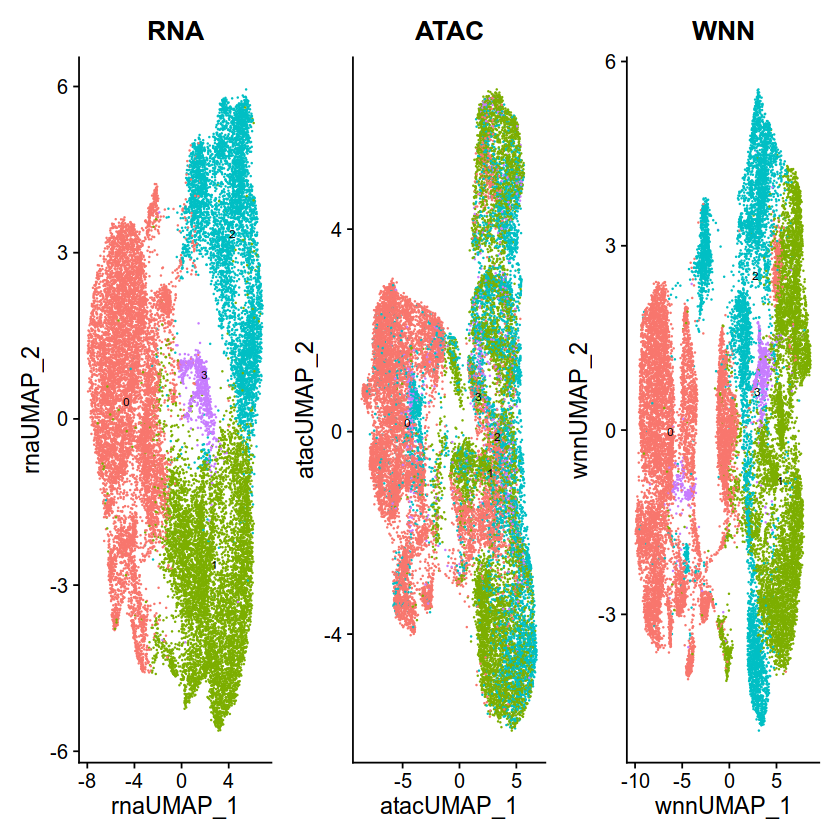

In [122]:
p1 <- DimPlot(glio.int, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.2", label = TRUE, label.size = 2.5, repel = TRUE) + ggtitle("RNA")
p2 <- DimPlot(glio.int, reduction = "umap", group.by = "CCA_RNA_snn_res.0.2", label = TRUE, label.size = 2.5, repel = TRUE) + ggtitle("ATAC")
p3 <- DimPlot(glio.int, reduction = "wnn.umap", group.by = "CCA_RNA_snn_res.0.2",label = TRUE, label.size = 2.5, repel = TRUE) + ggtitle("WNN")
p1 + p2 + p3 & NoLegend() & theme(plot.title = element_text(hjust = 0.5))

In [123]:
col<-c("#B3CDE3","#FCCDE5","#B2DF8A","#E6AB02","#FDBF6F")

In [124]:
getwd()

[1] "/disk1/xilu/glioblastoma_single_cell/1.RNA/5.figure"

In [125]:
write.table(glio.int$`CCA_RNA_snn_res.0.2`,file="scRNA-seq.name.cluster.xls",quote=F,sep="\t")

In [126]:
glio.int

An object of class Seurat 
510659 features across 22741 samples within 5 assays 
Active assay: peaks (258425 features, 258424 variable features)
 4 other assays present: RNA, ATAC_common_peak, CCA_RNA, chromvar
 6 dimensional reductions calculated: pca, rna.umap, lsi, umap, harmony, wnn.umap

In [127]:
cluster<-read.table("/disk1/xilu/glioblastoma_single_cell/11.joint/merged_cluster/fame.atac.seq.cluser.scRNA-seq.merged.xls",header=T,sep="\t")
colnames(cluster)<-c("file_barcode","ATAC")
cluster2<-data.frame(cluster[,2])
rownames(cluster2)<-cluster[,1]
glio.int<-AddMetaData(glio.int,metadata=cluster2)
glio.int$ATAC<-cluster2

In [128]:
cluster3<-cluster
cluster3$ATAC<-gsub("5","3",cluster3$ATAC)
cluster3$ATAC<-gsub("4","2",cluster3$ATAC)

In [129]:
cluster4<-data.frame(cluster3[,2])
rownames(cluster4)<-cluster3[,1]
glio.int<-AddMetaData(glio.int,metadata=cluster4)
glio.int$ATAC2<-cluster4

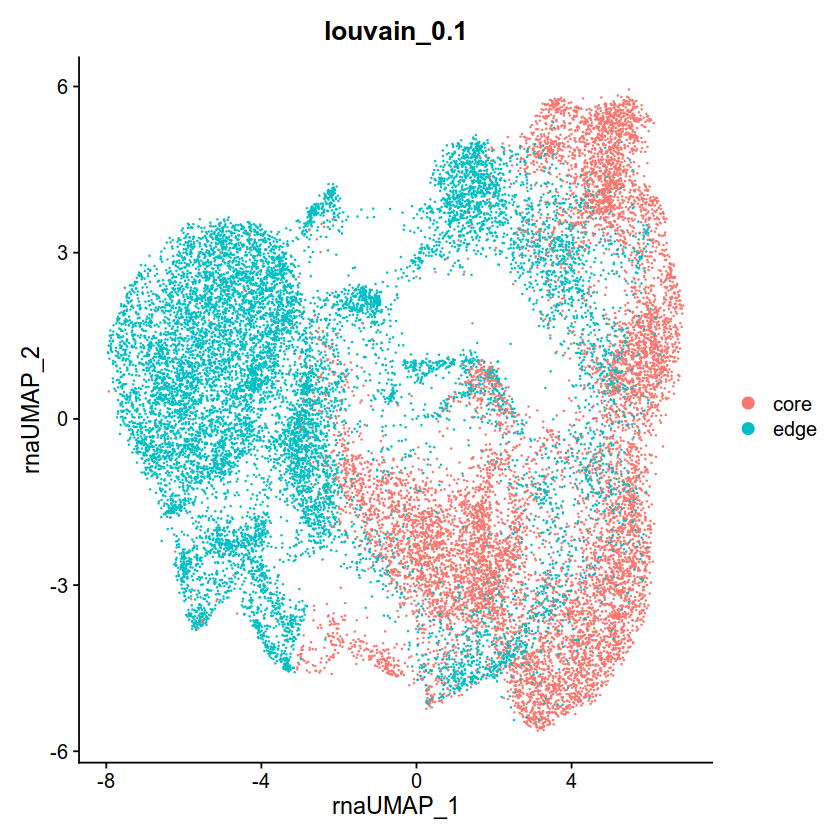

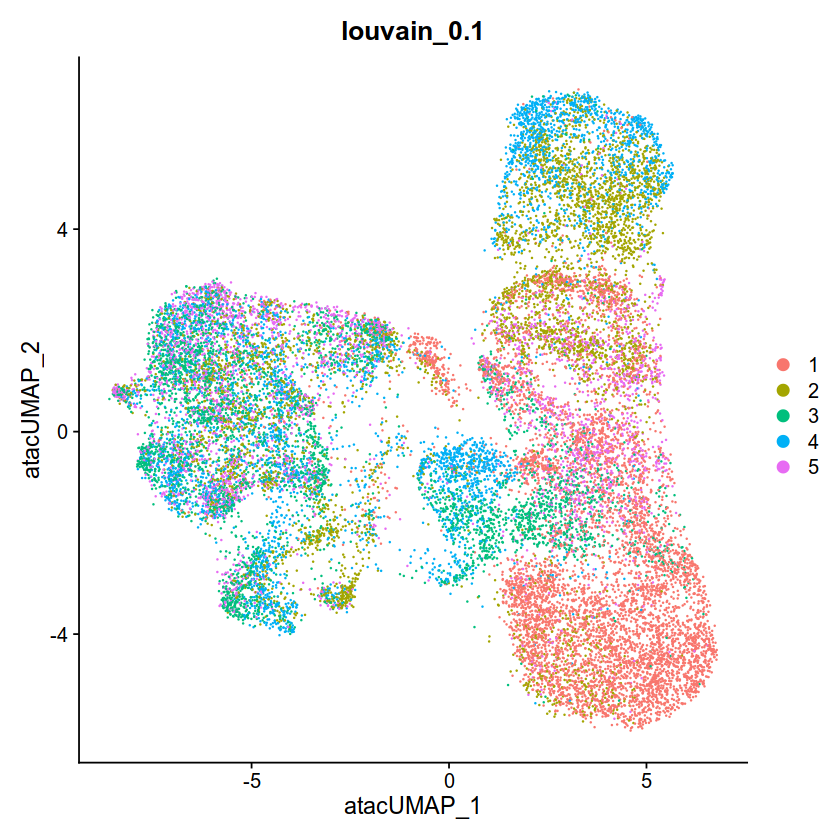

In [130]:
DimPlot(glio.int, reduction = "rna.umap", group.by = "type") + ggtitle("louvain_0.1")
DimPlot(glio.int, reduction = "umap", group.by = "ATAC") + ggtitle("louvain_0.1")

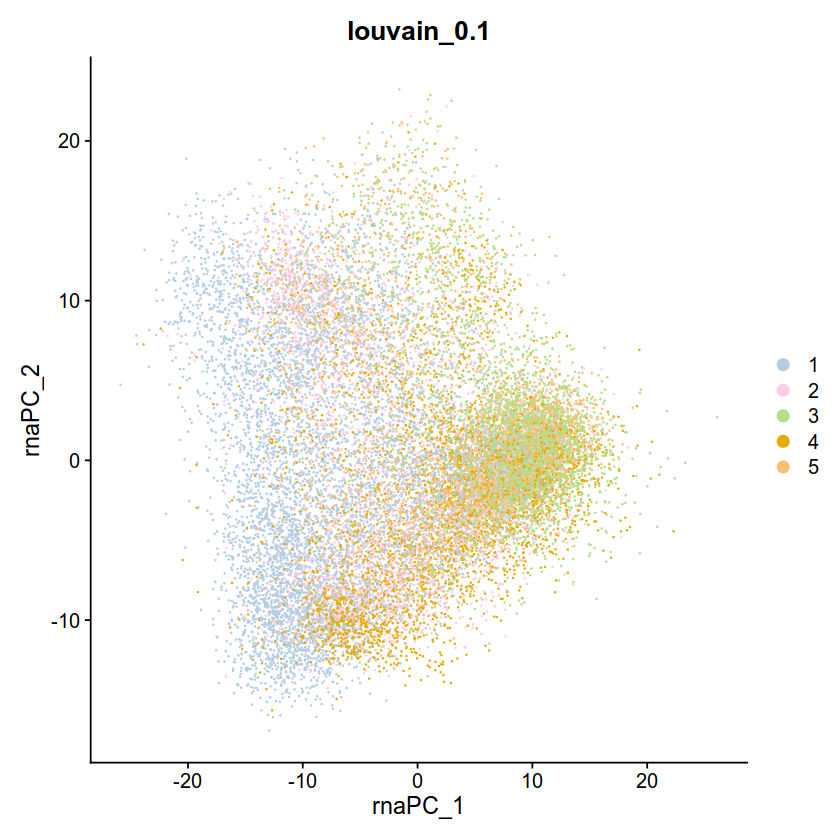

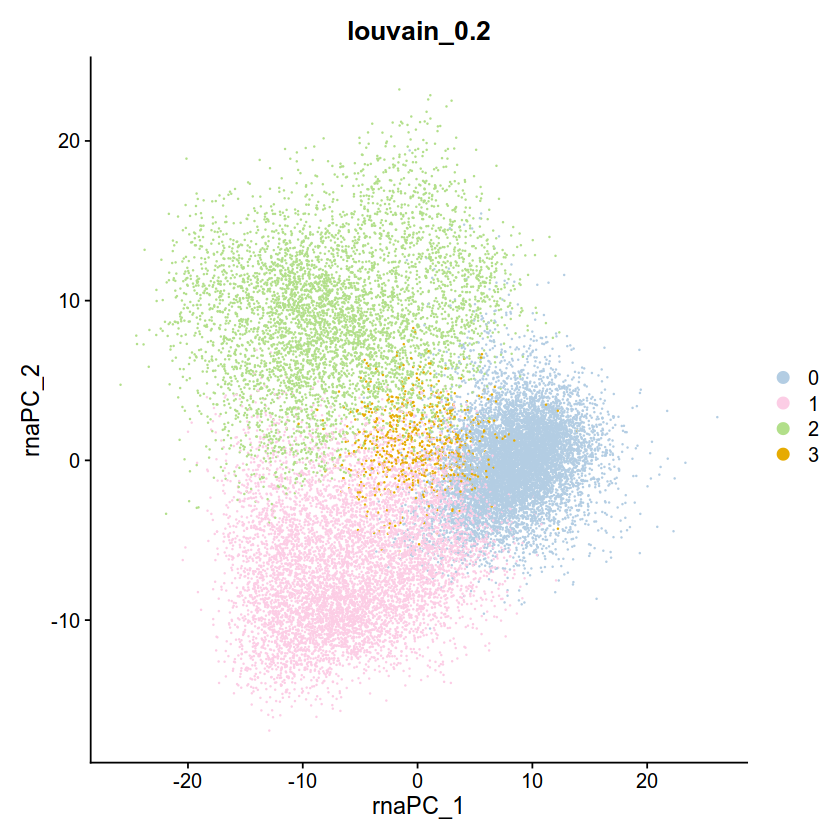

In [131]:
DimPlot(glio.int, reduction = "pca", group.by = "ATAC",cols = col) + ggtitle("louvain_0.1")
DimPlot(glio.int, reduction = "pca", group.by = "CCA_RNA_snn_res.0.2",cols = col) + ggtitle("louvain_0.2")


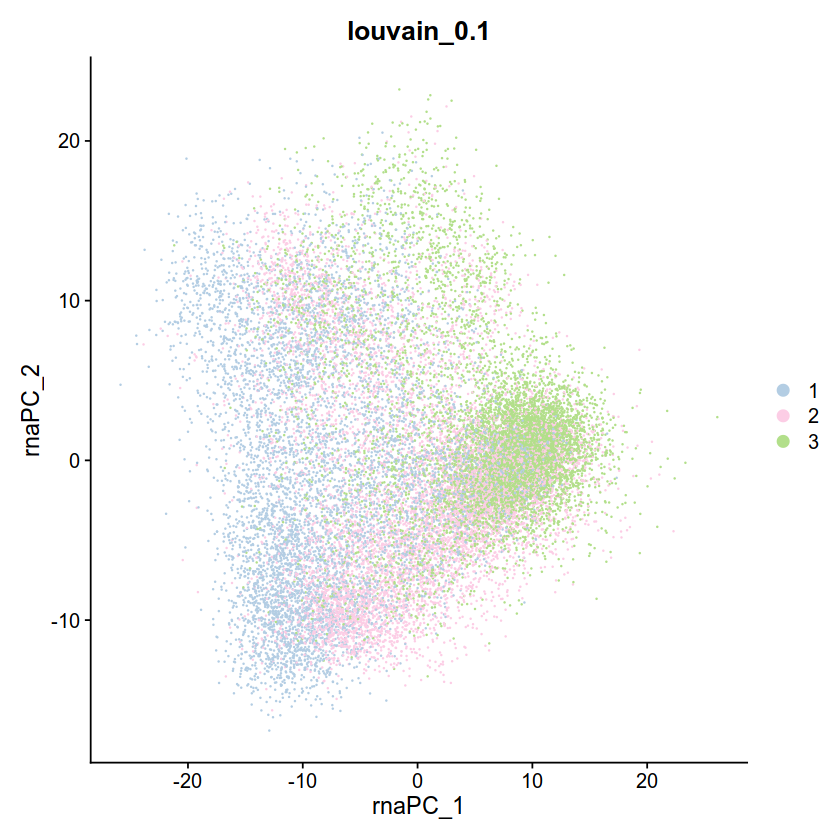

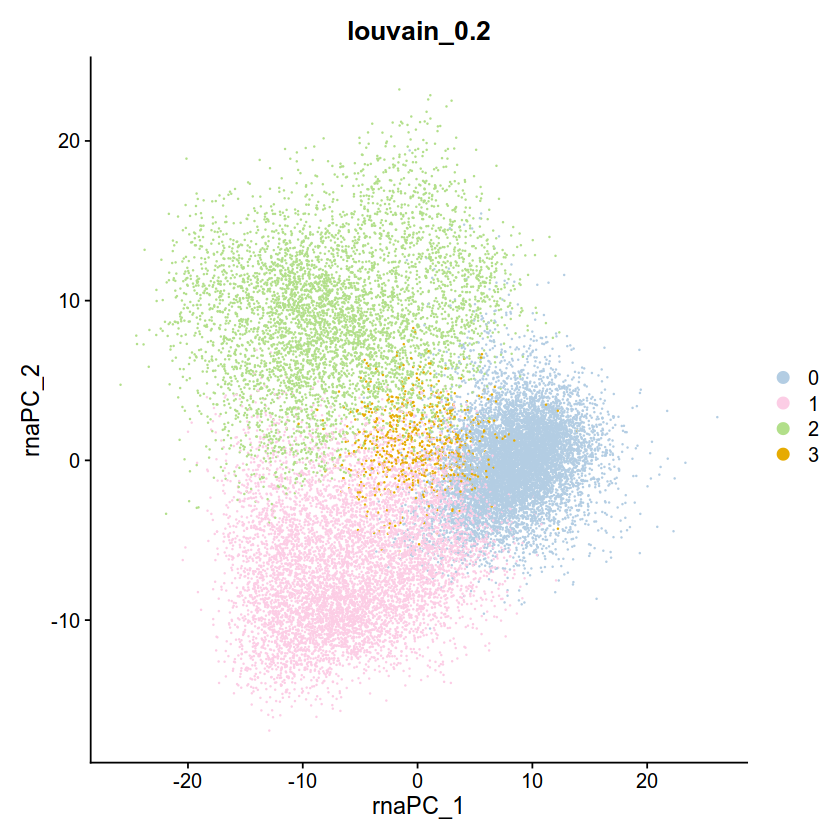

In [132]:
DimPlot(glio.int, reduction = "pca", group.by = "ATAC2",cols = col) + ggtitle("louvain_0.1")
DimPlot(glio.int, reduction = "pca", group.by = "CCA_RNA_snn_res.0.2",cols = col) + ggtitle("louvain_0.2")


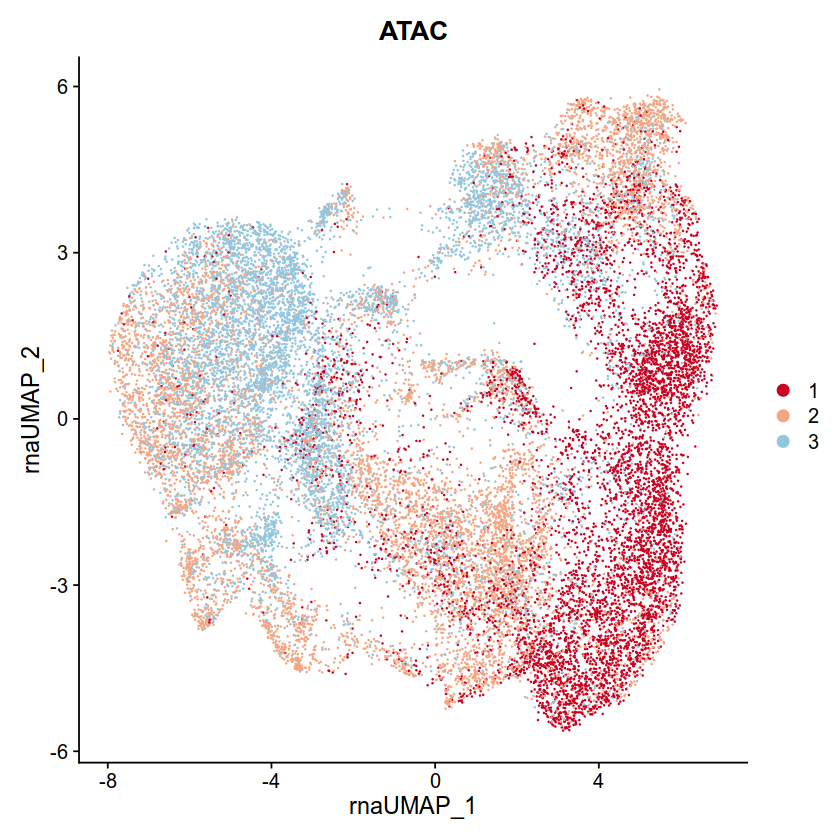

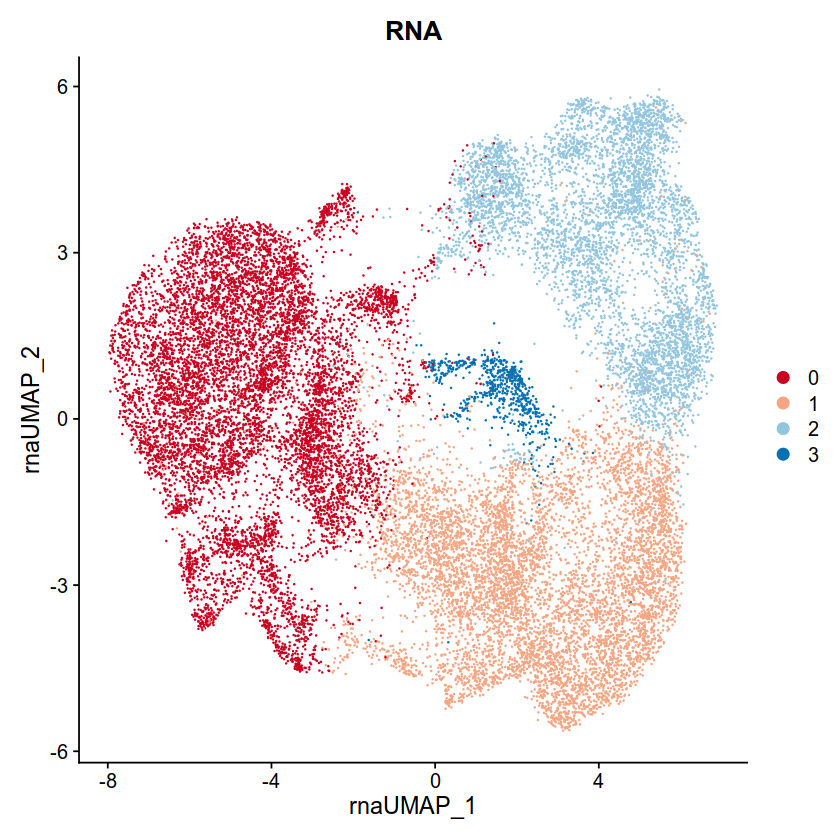

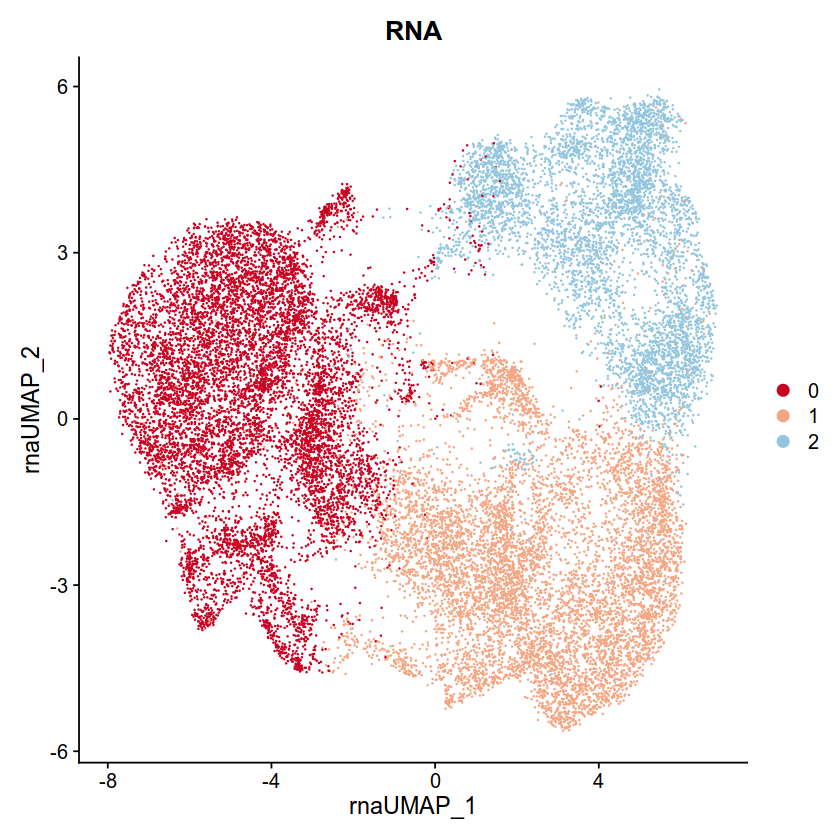

In [227]:
DimPlot(glio.int, reduction = "rna.umap", group.by = "ATAC2",cols = col) + ggtitle("ATAC")
DimPlot(glio.int, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.2",cols = col ) + ggtitle("RNA")
DimPlot(glio.int, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.1",cols = col ) + ggtitle("RNA")


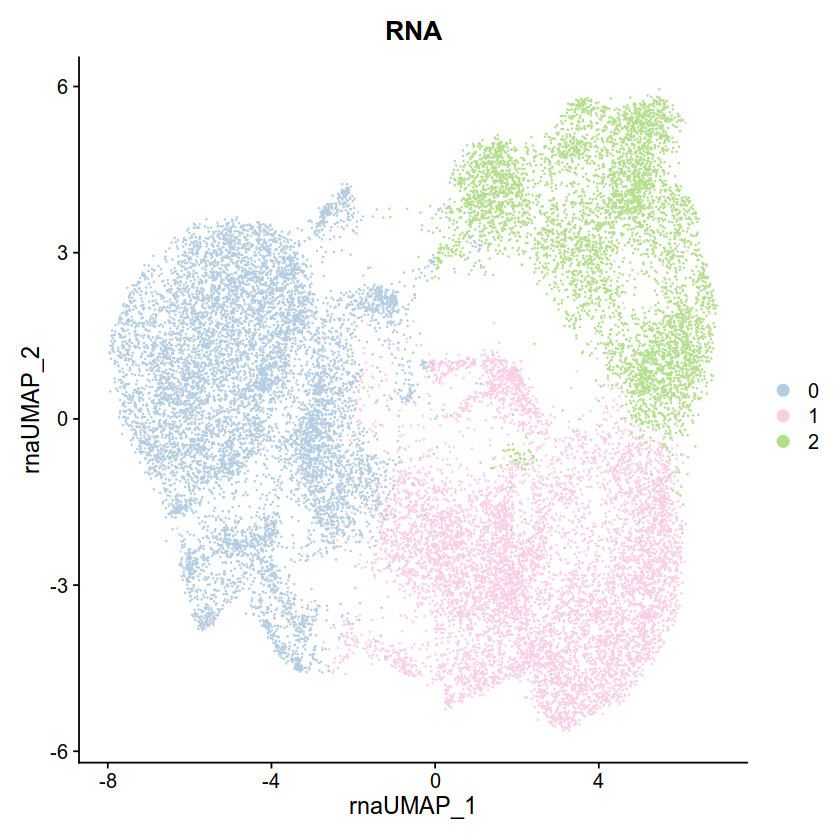

In [134]:
DimPlot(glio.int, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.1",cols = col ) + ggtitle("RNA")


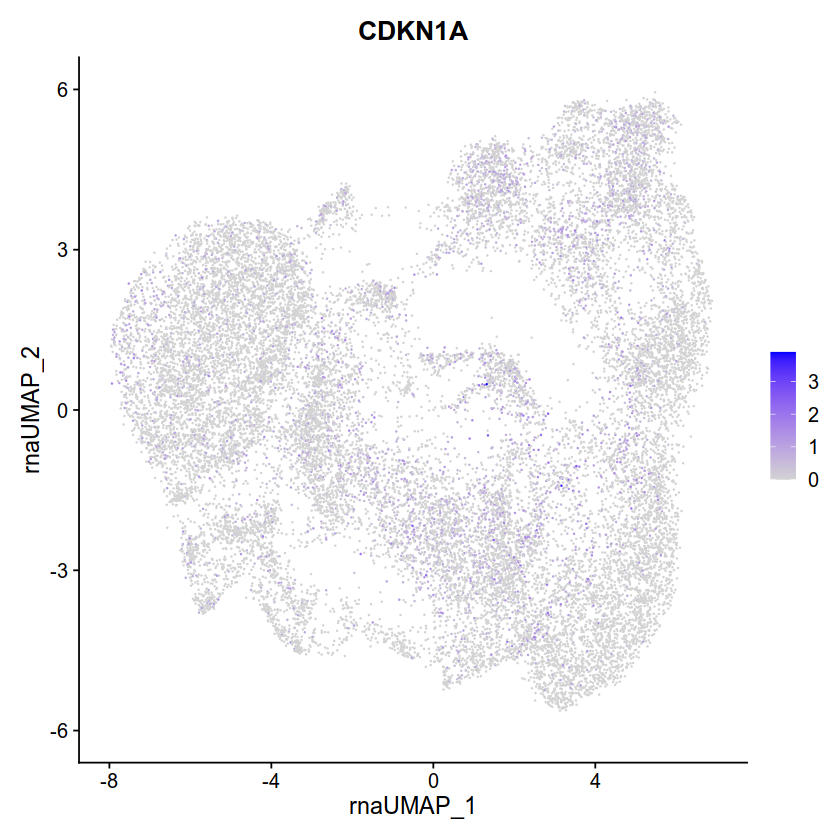

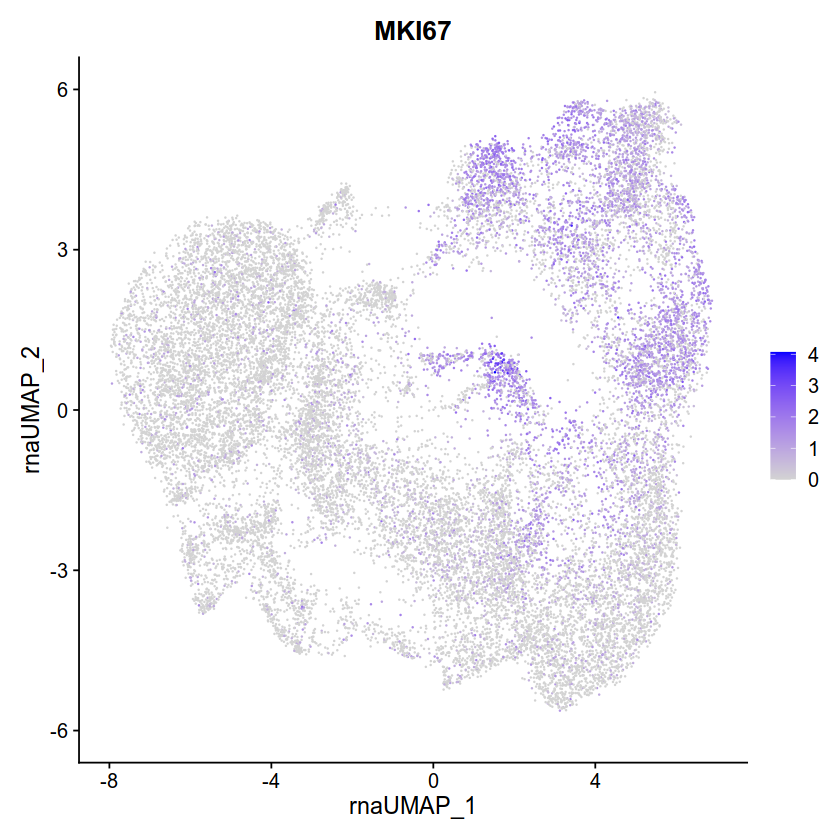

In [135]:
DefaultAssay(glio.int) <- "RNA"
FeaturePlot(object = glio.int, features = 'CDKN1A')
FeaturePlot(object = glio.int, features = 'MKI67')


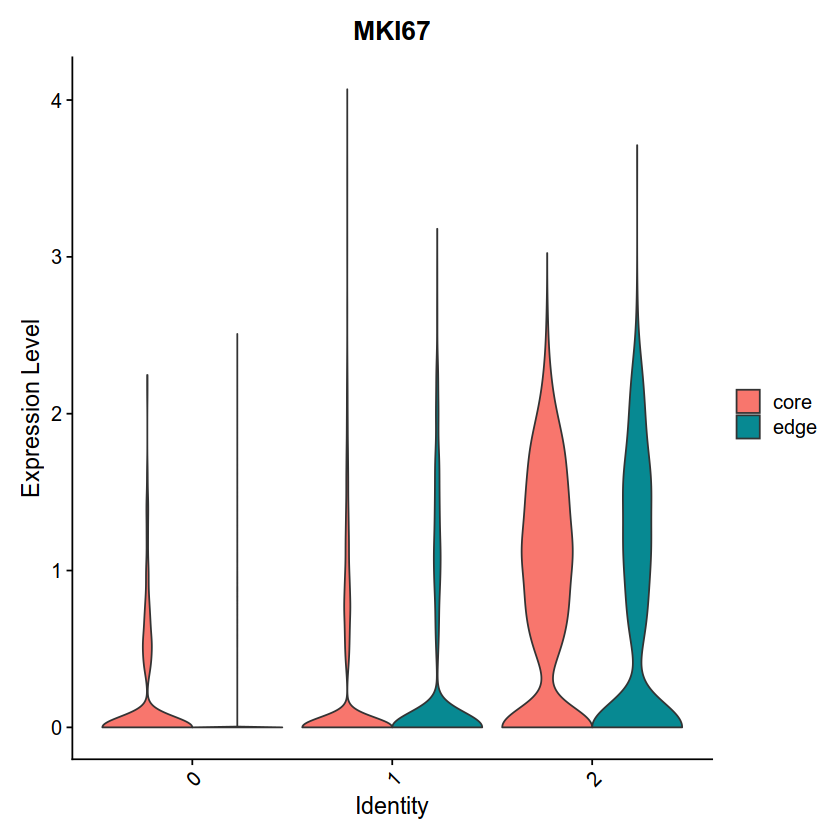

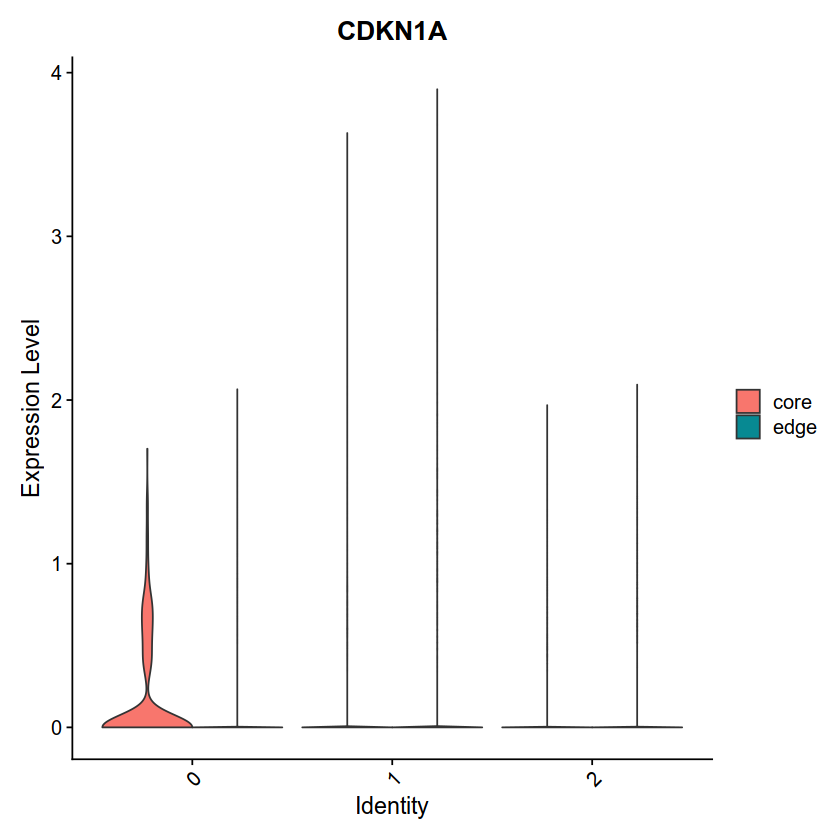

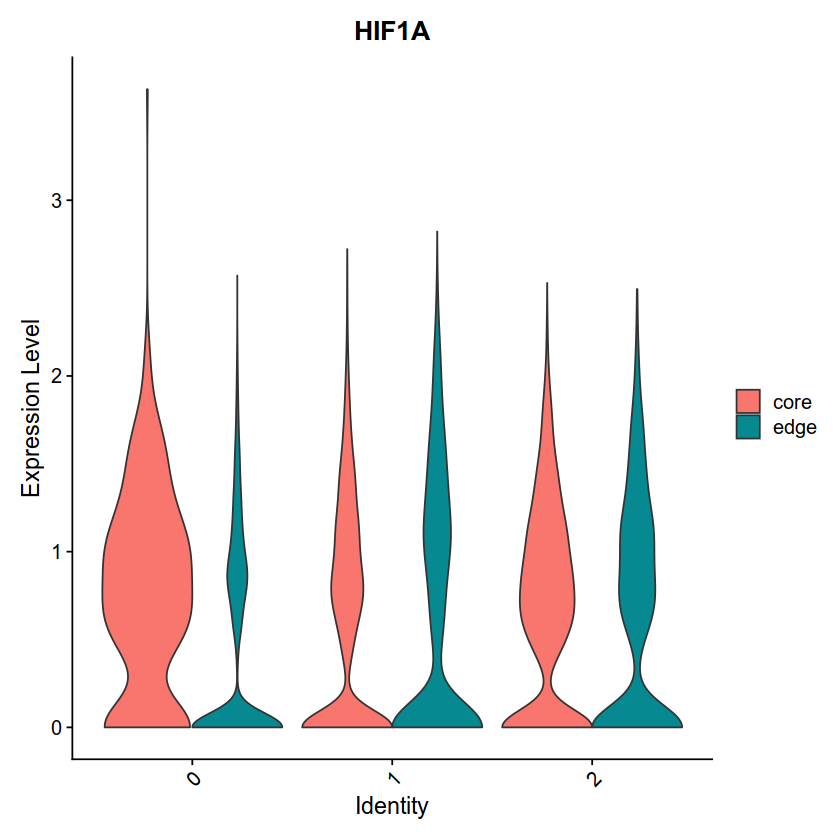

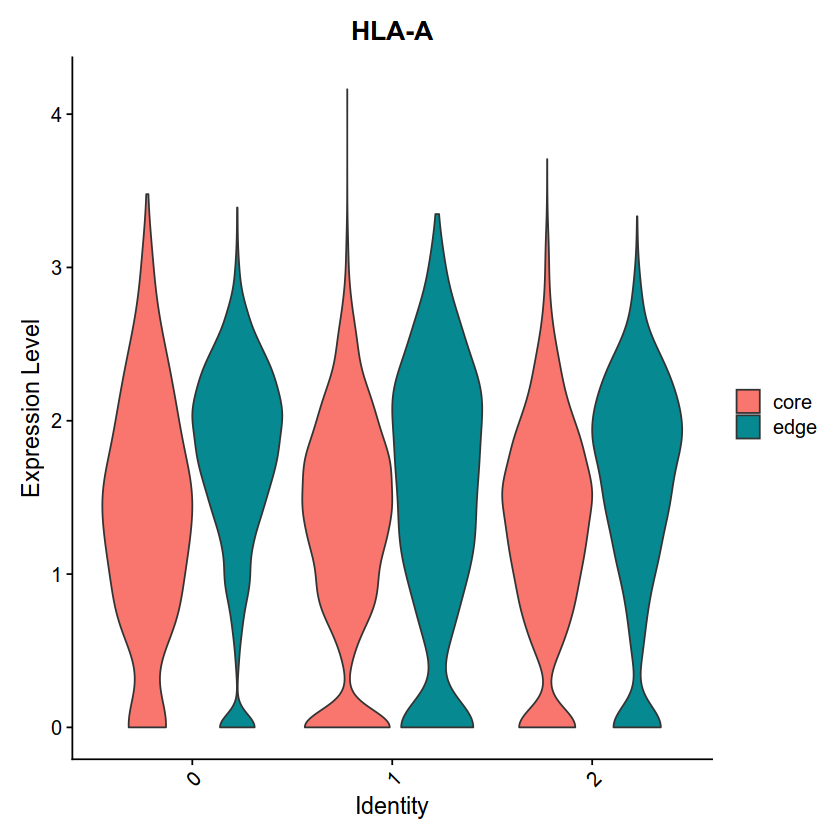

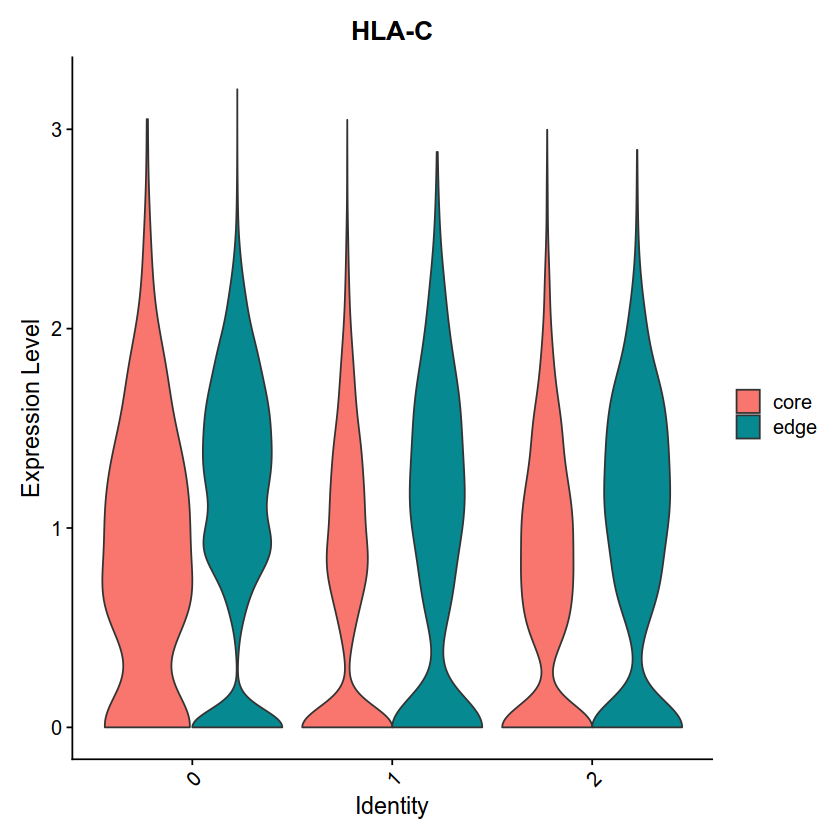

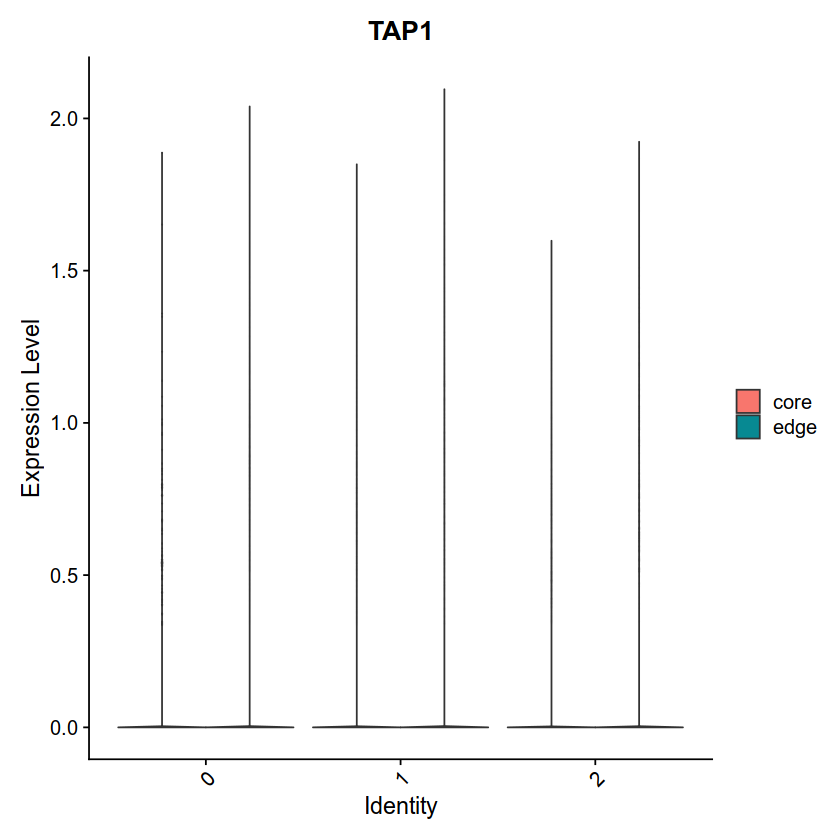

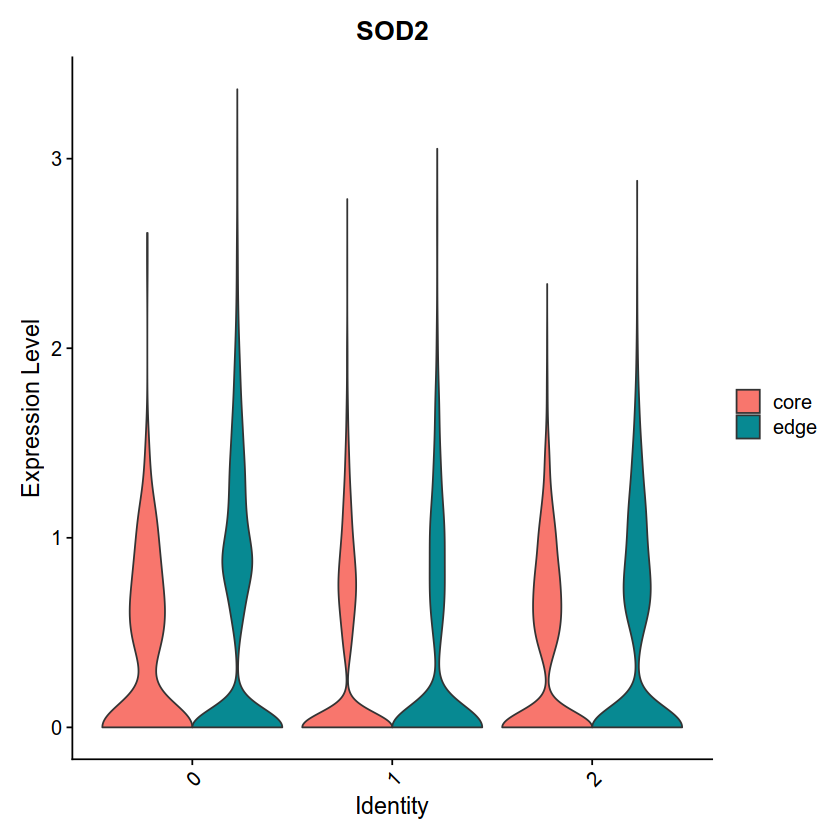

In [136]:
VlnPlot(glio.int,features="MKI67",split.by  = "type",group.by ="CCA_RNA_snn_res.0.1",pt.size = 0)
VlnPlot(glio.int,features="CDKN1A",split.by  = "type",group.by ="CCA_RNA_snn_res.0.1",pt.size = 0)
VlnPlot(glio.int,features="HIF1A",split.by  = "type",group.by ="CCA_RNA_snn_res.0.1",pt.size = 0)
VlnPlot(glio.int,features="HLA-A",split.by  = "type",group.by ="CCA_RNA_snn_res.0.1",pt.size = 0)
VlnPlot(glio.int,features="HLA-C",split.by  = "type",group.by ="CCA_RNA_snn_res.0.1",pt.size = 0)
VlnPlot(glio.int,features="TAP1",split.by  = "type",group.by ="CCA_RNA_snn_res.0.1",pt.size = 0)
VlnPlot(glio.int,features="SOD2",split.by  = "type",group.by ="CCA_RNA_snn_res.0.1",pt.size = 0)


In [137]:
DefaultAssay(glio.int) <- "CCA_RNA"


In [138]:
pdf("scrna-seq.3cluster.pdf")
DimPlot(glio.int, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.1",cols = col ) + ggtitle("RNA")
dev.off()

png 
  2

In [139]:
pdf("scatac-seq.3cluster.pdf")
DimPlot(glio.int, reduction = "umap", group.by = "CCA_RNA_snn_res.0.1", label = TRUE, label.size = 2.5, repel = TRUE,cols=col) + ggtitle("ATAC")
dev.off()

png 
  2

In [140]:
table(glio.int$`CCA_RNA_snn_res.0.2`,glio.int$ATAC)

   
       1    2    3    4    5
  0  373 1613 3362 1997 2050
  1 3647 1530  187 1467  474
  2 2231 1251  628  525  735
  3  201  124   59  174  113

In [141]:
table(glio.int$`CCA_RNA_snn_res.0.2`,glio.int$ATAC2)

   
       1    2    3
  0  373 3610 5412
  1 3647 2997  661
  2 2231 1776 1363
  3  201  298  172

In [142]:
table(glio.int$type,glio.int$ATAC2)

      
          1    2    3
  core 4653 4429  742
  edge 1799 4252 6866

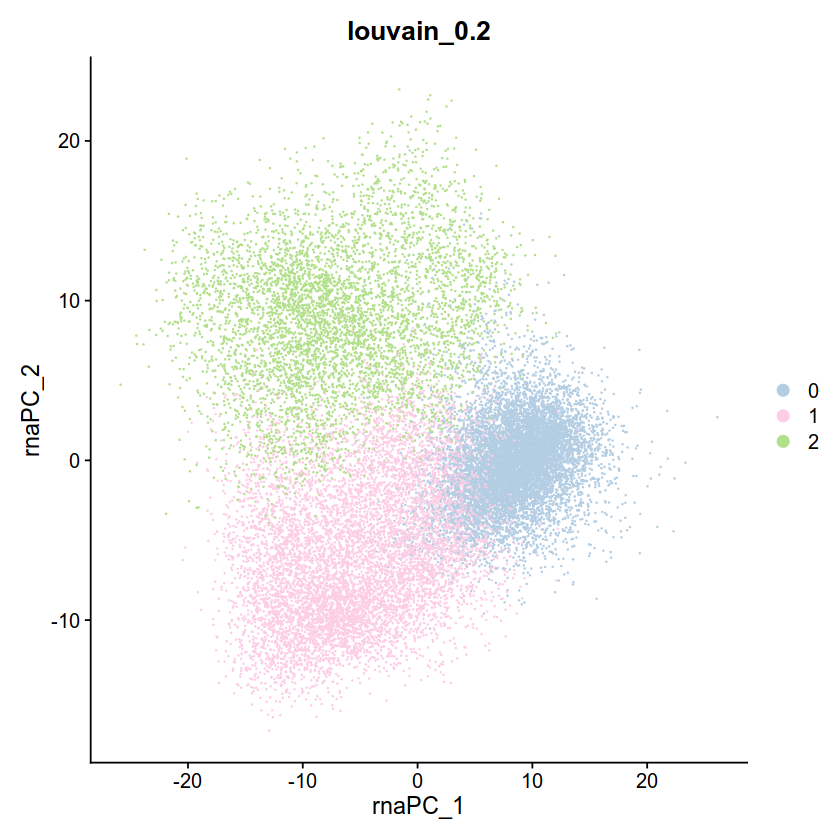

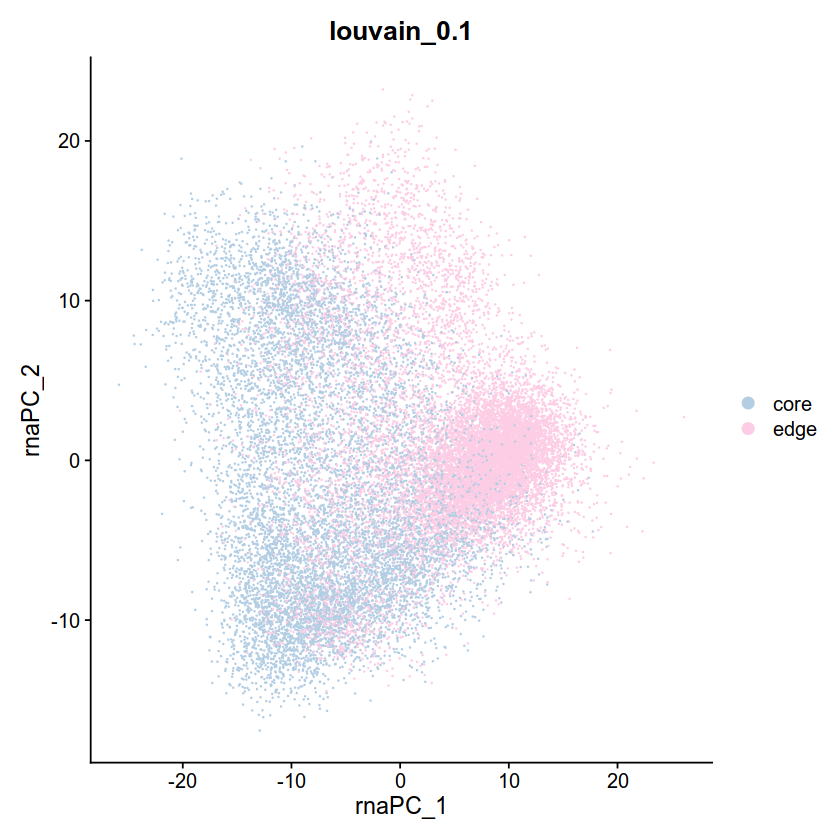

In [143]:
DimPlot(glio.int, reduction = "pca", group.by = "CCA_RNA_snn_res.0.1",cols = col) + ggtitle("louvain_0.2")
DimPlot(glio.int, reduction = "pca", group.by = "type",cols = col) + ggtitle("louvain_0.1")

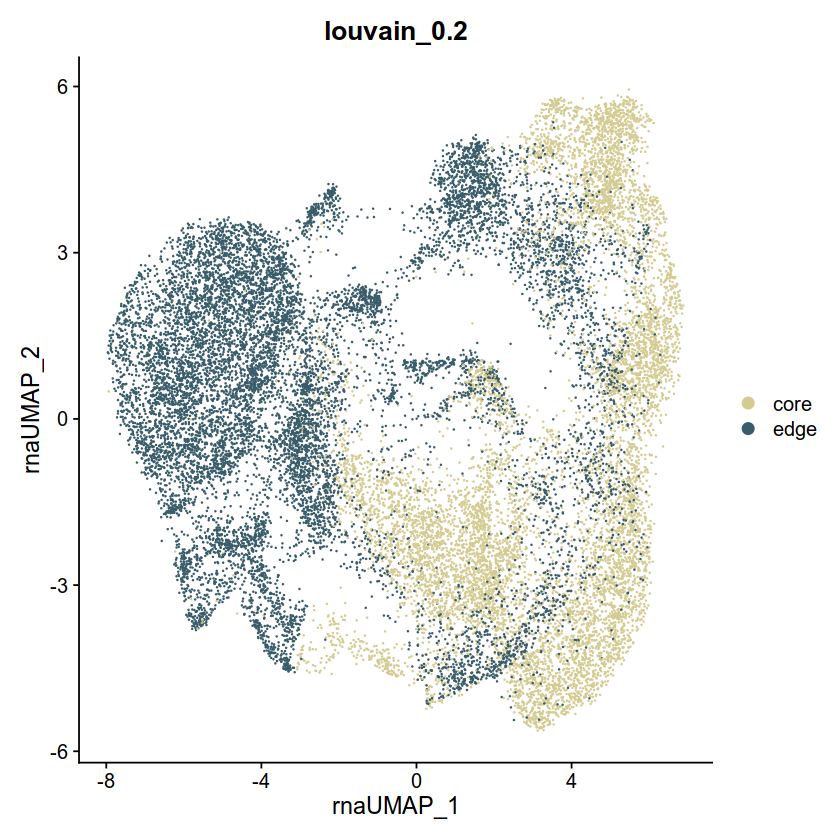

png 
  2

png 
  2

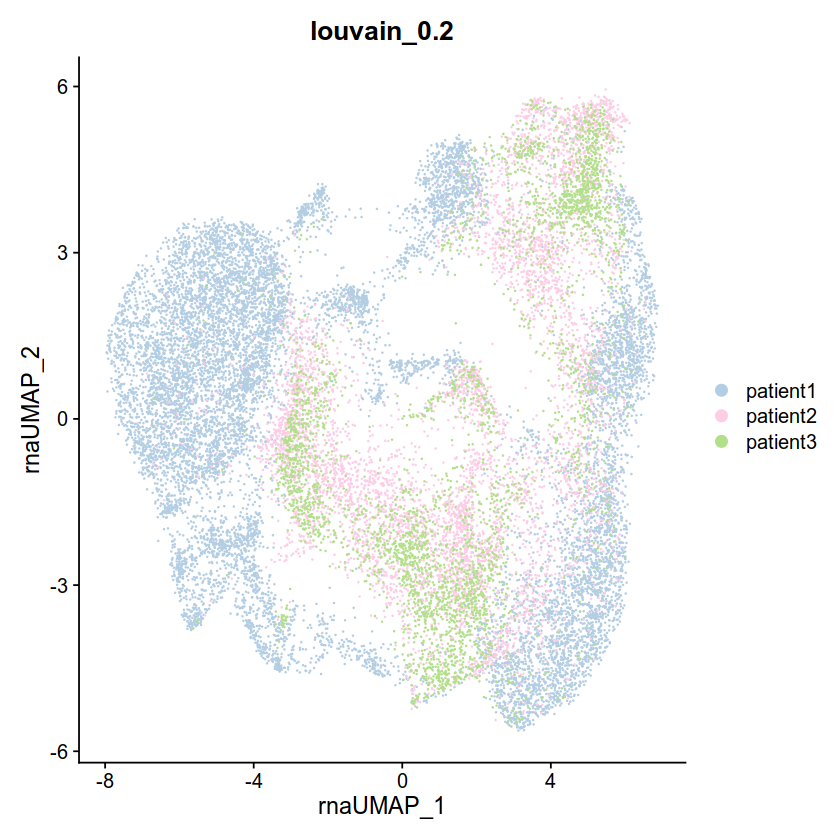

In [144]:
DimPlot(glio.int, reduction = "rna.umap", group.by = "type",cols = c("#D4CB92","#395C6B")) + ggtitle("louvain_0.2")
DimPlot(glio.int, reduction = "rna.umap", group.by = "patient",cols = col ) + ggtitle("louvain_0.2")
pdf("core.edge.cluster.pdf")
DimPlot(glio.int, reduction = "rna.umap", group.by = "type",cols = c("#D4CB92","#395C6B")) + ggtitle("louvain_0.2")
dev.off()
pdf("patient.cluster.pdf")
DimPlot(glio.int, reduction = "rna.umap", group.by = "patient",cols = col ) + ggtitle("louvain_0.2")
dev.off()

In [145]:
library(RColorBrewer)
n <- 20
qual_col_pals = brewer.pal.info[brewer.pal.info$category == 'qual',]
col_vector = unlist(mapply(brewer.pal, qual_col_pals$maxcolors, rownames(qual_col_pals)))
col2<-sample(col_vector, n)

In [146]:
col3<-col2[1:6]
col3
col3<-c("#FDC086","#FCCDE5","#F2F2F2","#1F78B4","#BF5B17","#B3CDE3")

[1] "#B3CDE3" "#BEBADA" "#B2DF8A" "#E31A1C" "#8DD3C7" "#7570B3"

In [147]:
table(glio.int$sample,glio.int$`CCA_RNA_snn_res.0.1`)

       
           0    1    2
  core1   54 3053 1361
  core2  246 1758  864
  core3  105 1315 1068
  edge1 7443  202  865
  edge2  969 1086 1045
  edge3  586  557  164

In [148]:
col3<-c("#FDC086","white","white","white","white","white")
col4<-c("white","#FCCDE5","white","white","white","white")
col5<-c("white","white","#386CB0","white","white","white")
col6<-c("white","white","white","#1F78B4","white","white")
col7<-c("white","white","white","white","#BF5B17","white")
col8<-c("white","white","white","white","white","#B3CDE3")

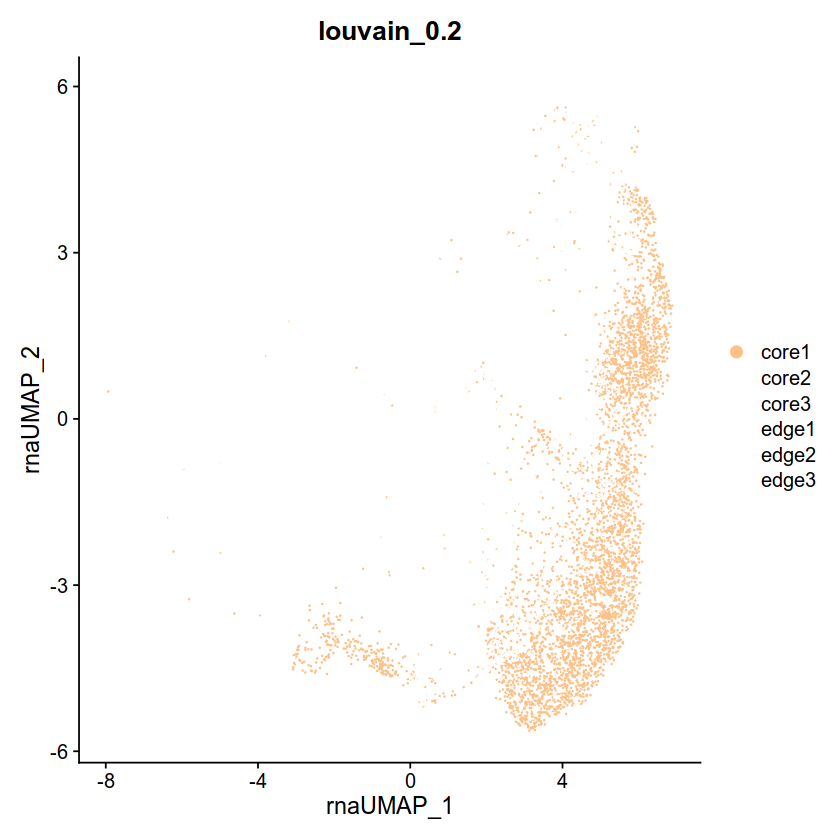

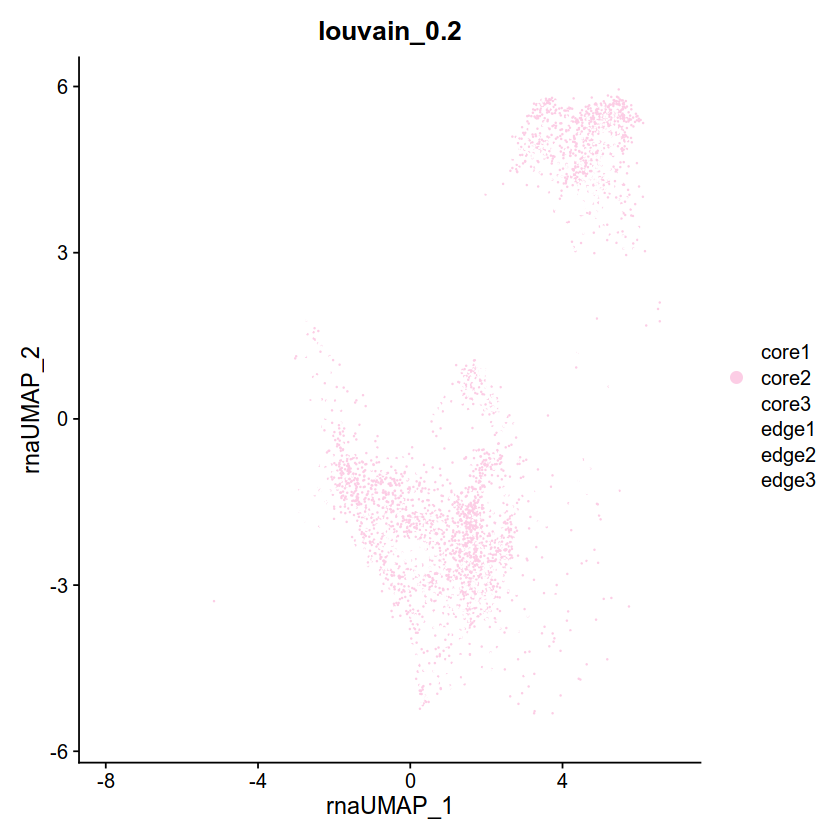

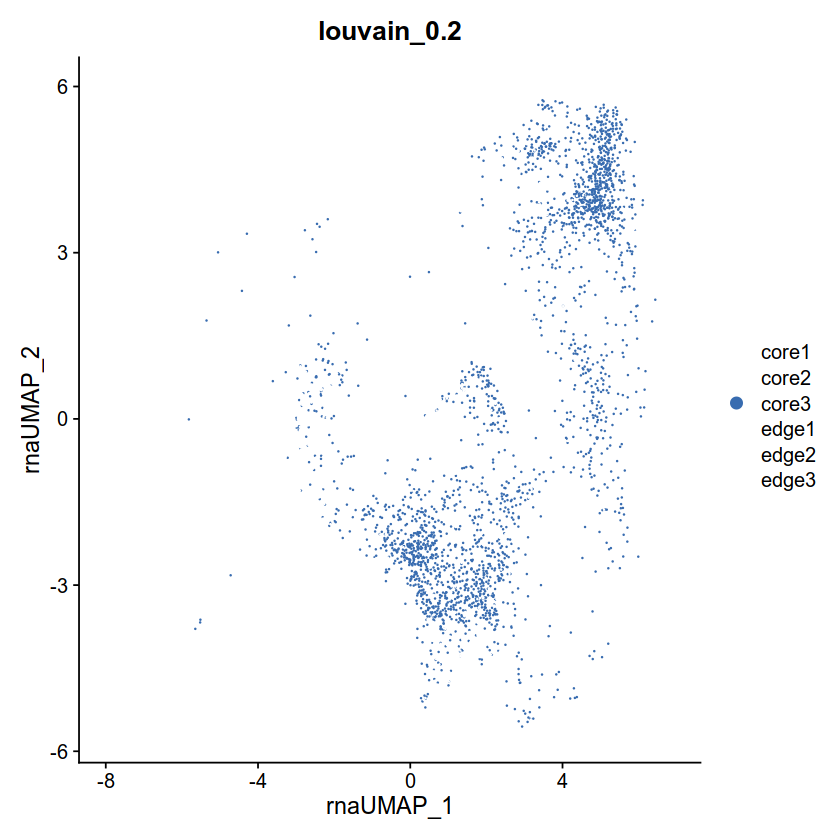

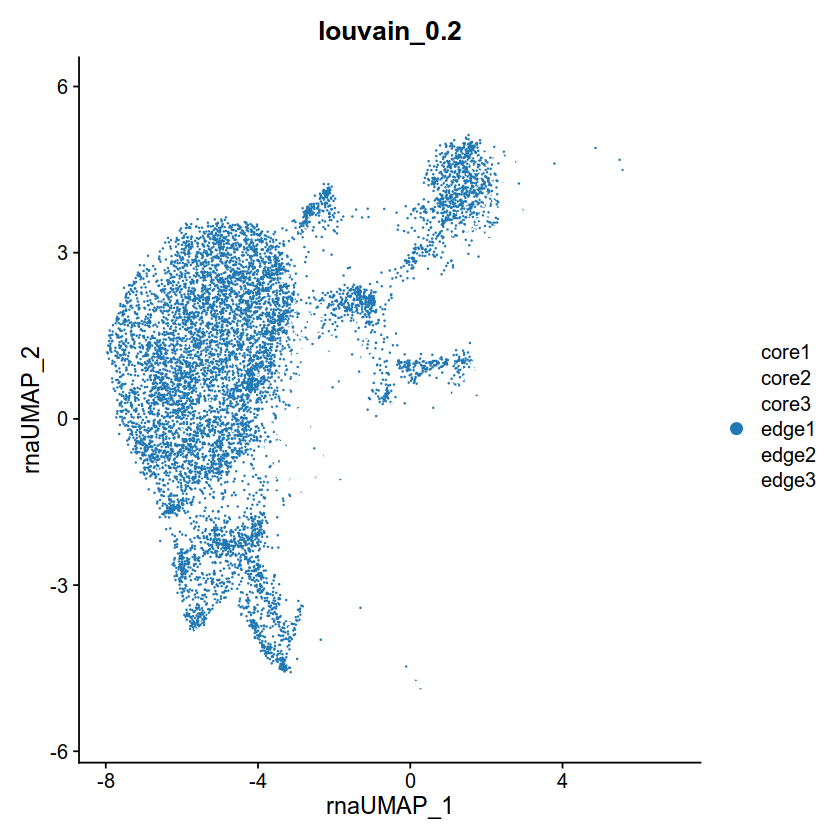

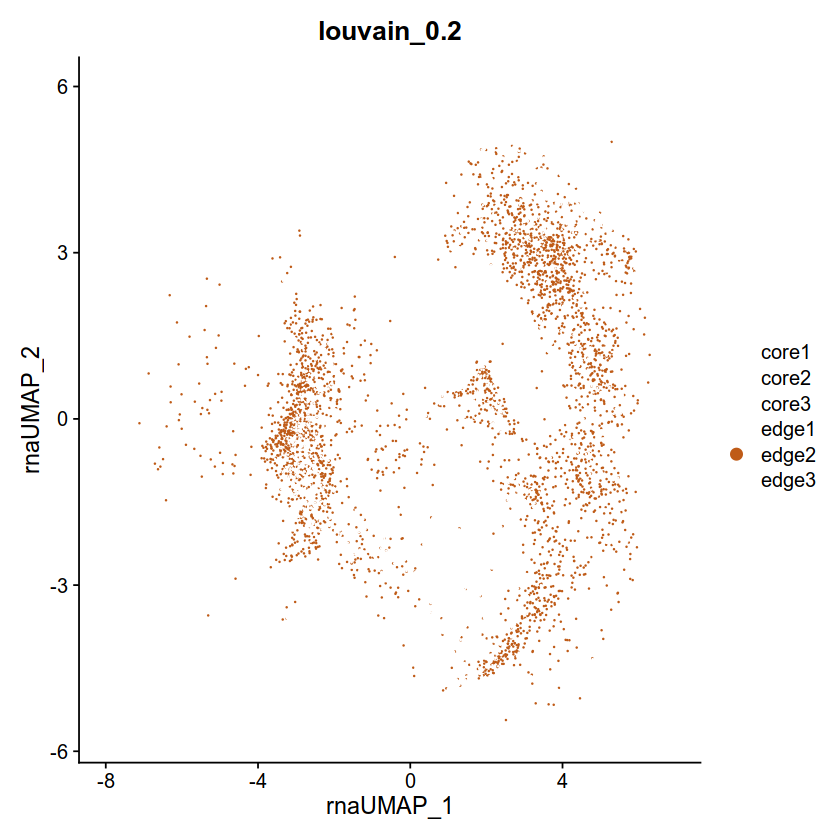

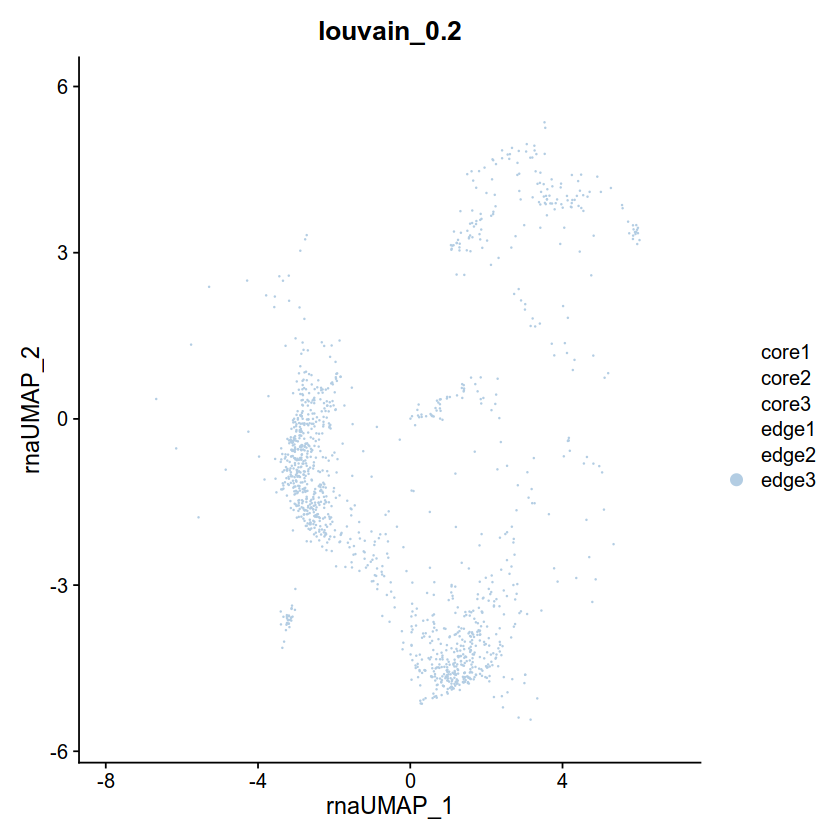

In [149]:
DimPlot(glio.int, reduction = "rna.umap", group.by = "sample",cols=col3 ) + ggtitle("louvain_0.2")
DimPlot(glio.int, reduction = "rna.umap", group.by = "sample",cols=col4 ) + ggtitle("louvain_0.2")
DimPlot(glio.int, reduction = "rna.umap", group.by = "sample",cols=col5 ) + ggtitle("louvain_0.2")
DimPlot(glio.int, reduction = "rna.umap", group.by = "sample",cols=col6 ) + ggtitle("louvain_0.2")
DimPlot(glio.int, reduction = "rna.umap", group.by = "sample",cols=col7 ) + ggtitle("louvain_0.2")
DimPlot(glio.int, reduction = "rna.umap", group.by = "sample",cols=col8 ) + ggtitle("louvain_0.2")



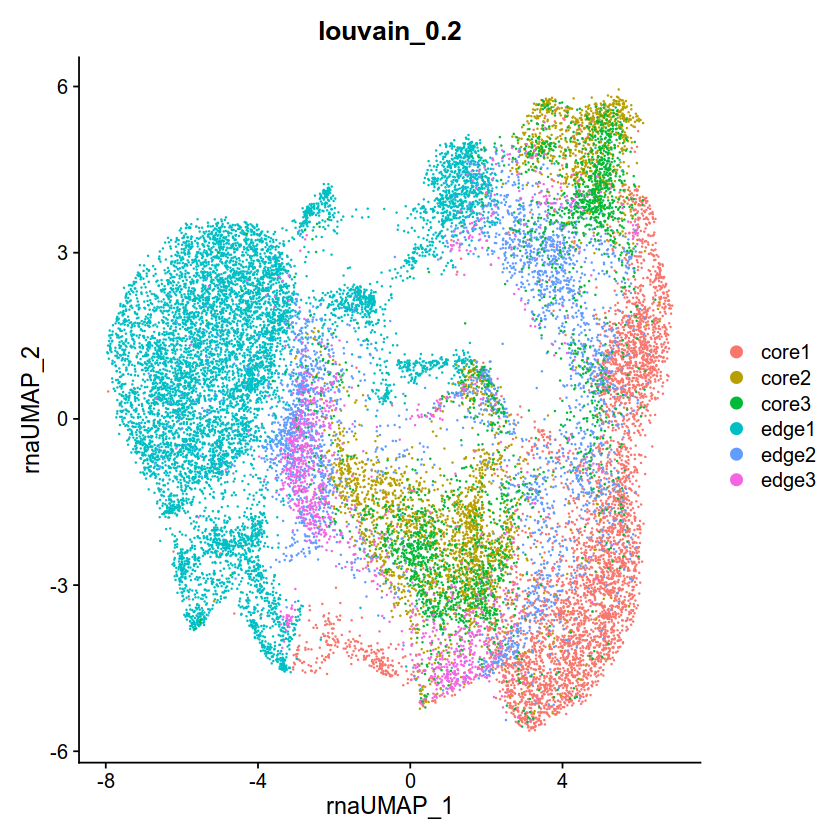

In [150]:
DimPlot(glio.int, reduction = "rna.umap", group.by = "sample" ) + ggtitle("louvain_0.2")


png 
  2

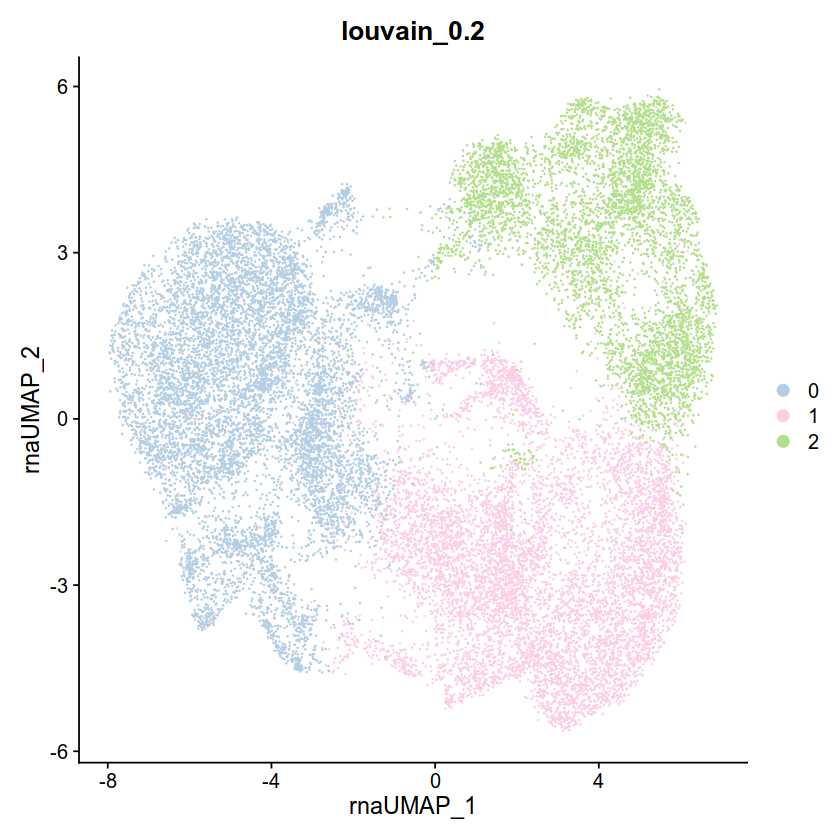

In [151]:
DimPlot(glio.int, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.1",cols = col ) + ggtitle("louvain_0.2")
pdf("cluster.scrna.pdf")
DimPlot(glio.int, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.1",cols = col ) + ggtitle("louvain_0.2")
dev.off()

In [152]:
DefaultAssay(glio.int) <- "CCA_RNA"
clusters_of_interest <- c(0,1)
subset_seurat2 <- subset(glio.int, idents = clusters_of_interest)
DimPlot(subset_seurat2, reduction = "umap", group.by = "CCA_RNA_snn_res.0.1",cols = c("#FDC086","#FCCDE5")) + ggtitle("louvain_0.2")

ERROR while rich displaying an object: Error in `palette()`:
! Insufficient values in manual scale. 3 needed but only 2 provided.

Traceback:
1. tryCatch(withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler), error = outer_handler)
2. tryCatchList(expr, classes, parentenv, handlers)
3. tryCatchOne(expr, names, parentenv, handlers[[1L]])
4. doTryCatch(return(expr), name, parentenv, handler)
5. withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler)
6. repr::mime2repr[[mime]](obj)
7. repr_text.defau

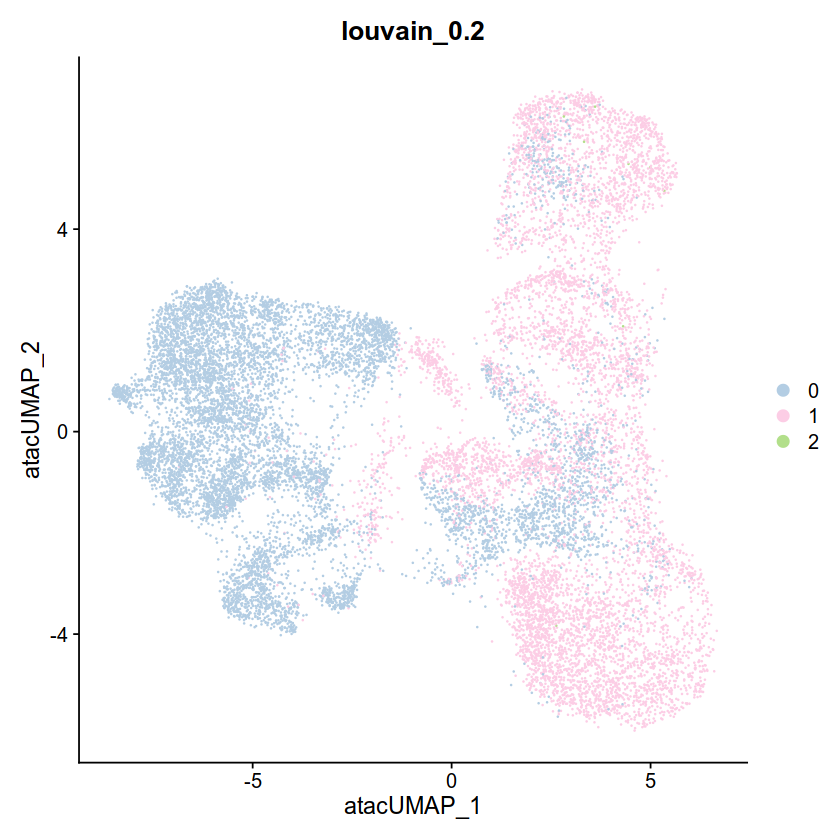

In [153]:
DimPlot(subset_seurat2, reduction = "umap", group.by = "CCA_RNA_snn_res.0.1",cols = col) + ggtitle("louvain_0.2")

In [154]:
a<-table(glio.int$type,glio.int$CCA_RNA_snn_res.0.1)
new<-t(a/rowSums(a))
new2<-data.frame(new)


In [155]:
new2

Var1,Var2,Freq
<fct>,<fct>,<dbl>
0,core,0.04122557
1,core,0.62357492
2,core,0.33519951
0,edge,0.69660138
1,edge,0.14283502
2,edge,0.16056360


In [156]:
new2$Var2<-factor(new2$Var2,levels=c("core","edge"))

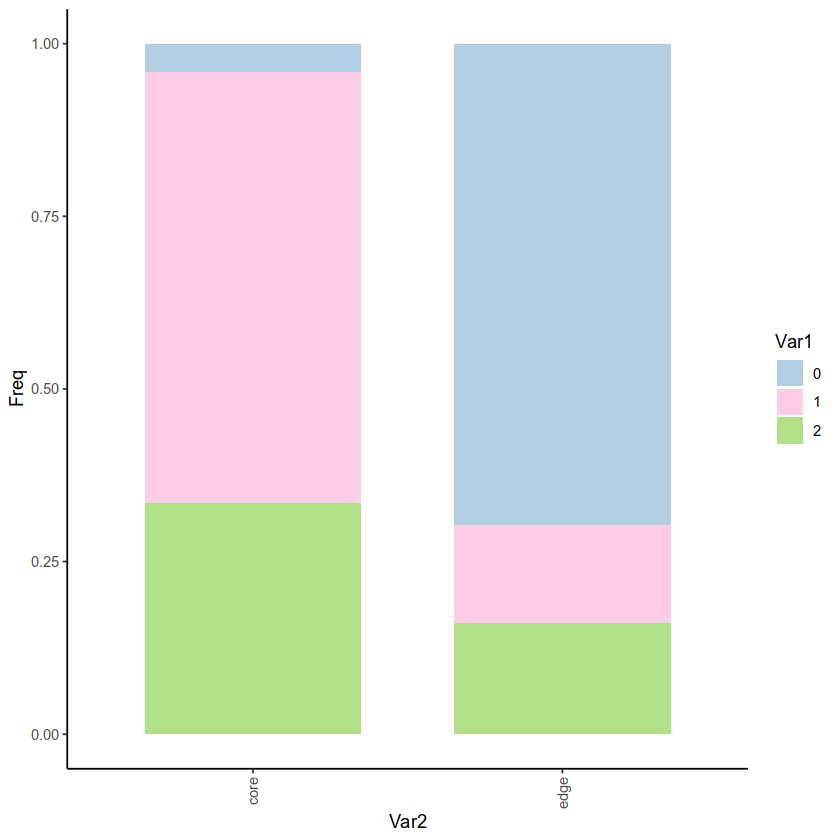

In [157]:
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=col)+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))

In [158]:
pdf("core.edge.barplot.pdf")
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=col)+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))
dev.off()

png 
  2

In [159]:
a<-table(glio.int$patient,glio.int$CCA_RNA_snn_res.0.1)

In [160]:
new<-t(a/rowSums(a))
new2<-data.frame(new)

In [161]:
new2

Var1,Var2,Freq
<fct>,<fct>,<dbl>
0,patient1,0.5776699
1,patient1,0.2508091
2,patient1,0.1715210
0,patient2,0.2035858
1,patient2,0.4765416
2,patient2,0.3198727
0,patient3,0.1820817
1,patient3,0.4932806
2,patient3,0.3246377


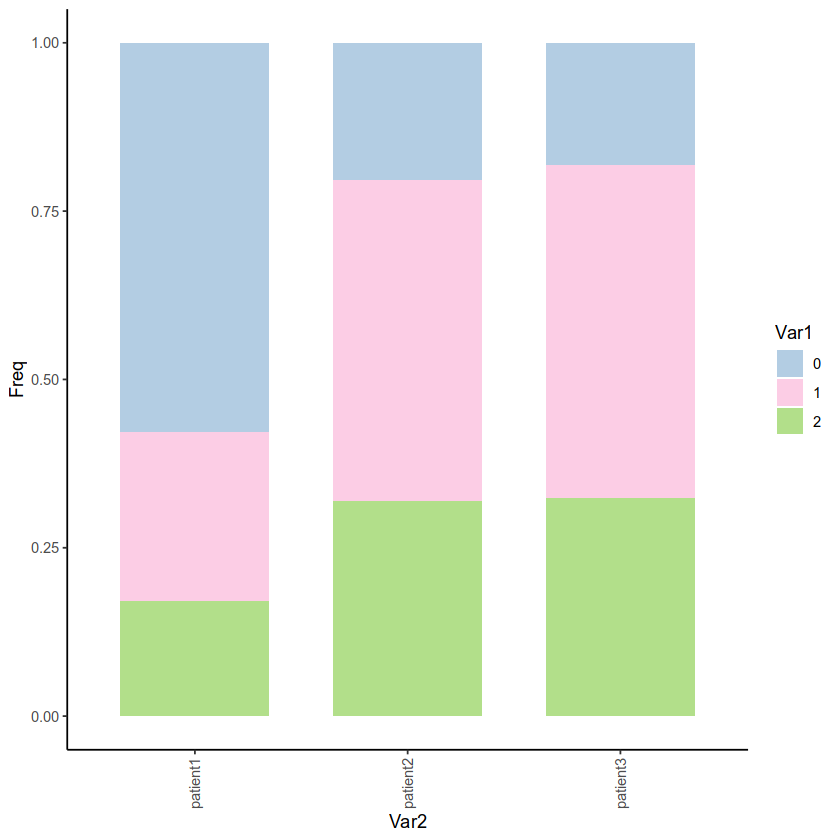

In [162]:
library(ggplot2)
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=col)+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))

In [163]:
pdf("patient.barplot.pdf")
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=col)+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))
dev.off()

png 
  2

In [164]:
a<-table(glio.int$sample,glio.int$CCA_RNA_snn_res.0.1)

In [165]:
new<-t(a/rowSums(a))
new2<-data.frame(new)

In [166]:
new2
#new2$Var2<-factor(new2$Var2)
new2$Var2<-factor(new2$Var2,levels=c("core1","edge1","core2","edge2","core3","edge3"))
new2$Var2

Var1,Var2,Freq
<fct>,<fct>,<dbl>
0,core1,0.01208594
1,core1,0.68330349
2,core1,0.30461056
0,core2,0.08577406
1,core2,0.61297071
2,core2,0.30125523
0,core3,0.04220257
1,core3,0.52853698
2,core3,0.42926045


[1] core1 core1 core1 core2 core2 core2 core3 core3 core3 edge1 edge1 edge1
[13] edge2 edge2 edge2 edge3 edge3 edge3
Levels: core1 edge1 core2 edge2 core3 edge3

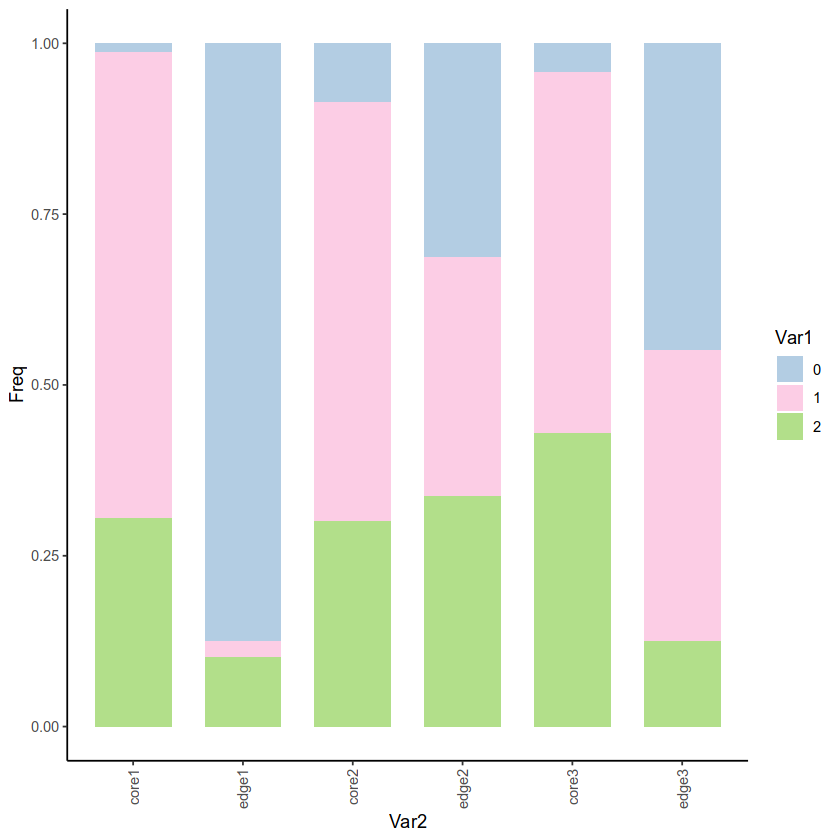

In [167]:
library(ggplot2)
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=col)+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))

In [168]:
pdf("patient.seperated.barplot.pdf")
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=col)+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))
dev.off()

png 
  2

In [169]:
###cell cycle
cc_file <- getURL("https://raw.githubusercontent.com/hbc/tinyatlas/master/cell_cycle/Homo_sapiens.csv")
cell_cycle_genes <- read.csv(text = cc_file)
ah <- AnnotationHub()
ahDb <- query(ah,
              pattern = c("Homo sapiens", "EnsDb"),
              ignore.case = TRUE)
id <- ahDb %>%
        mcols() %>%
        rownames() %>%
        tail(n = 1)
edb <- ah[[id]]
annotations <- genes(edb,
                     return.type = "data.frame")
annotations <- annotations %>%
        dplyr::select(gene_id, gene_name, seq_name, gene_biotype, description)
# Get gene names for Ensembl IDs for each gene
cell_cycle_markers <- dplyr::left_join(cell_cycle_genes, annotations, by = c("geneID" = "gene_id"))

# Acquire the S phase genes
s_genes <- cell_cycle_markers %>%
        dplyr::filter(phase == "S") %>%
        pull("gene_name")

# Acquire the G2M phase genes
g2m_genes <- cell_cycle_markers %>%
        dplyr::filter(phase == "G2/M") %>%
        pull("gene_name")

snapshotDate(): 2022-10-31

loading from cache



In [170]:
#build gene-expression rankings for each cell 
glio.int.matrix<-as.matrix(glio.int@assays$RNA@data)
cells_rankings <- AUCell_buildRankings(glio.int.matrix, nCores=30, plotStats=FALSE)
#calculate enrichment for the gene signatures
geneSets <- GeneSet(c(s_genes,g2m_genes), setName="geneSet1")
cells_AUC <- AUCell_calcAUC(geneSets, cells_rankings)

Warning message in asMethod(object):
"sparse->dense coercion: allocating vector of size 6.2 GiB"
Warning message in .AUCell_buildRankings(exprMat = exprMat, featureType = featureType, :
"nCores is no longer used. It will be deprecated in the next AUCell version."


,threshold,nCells
tenPercentOfMax,0.03786664,8370
Global_k1,0.10247558,4666
L_k2,0.06497972,6416


Global_k1 
0.1024756

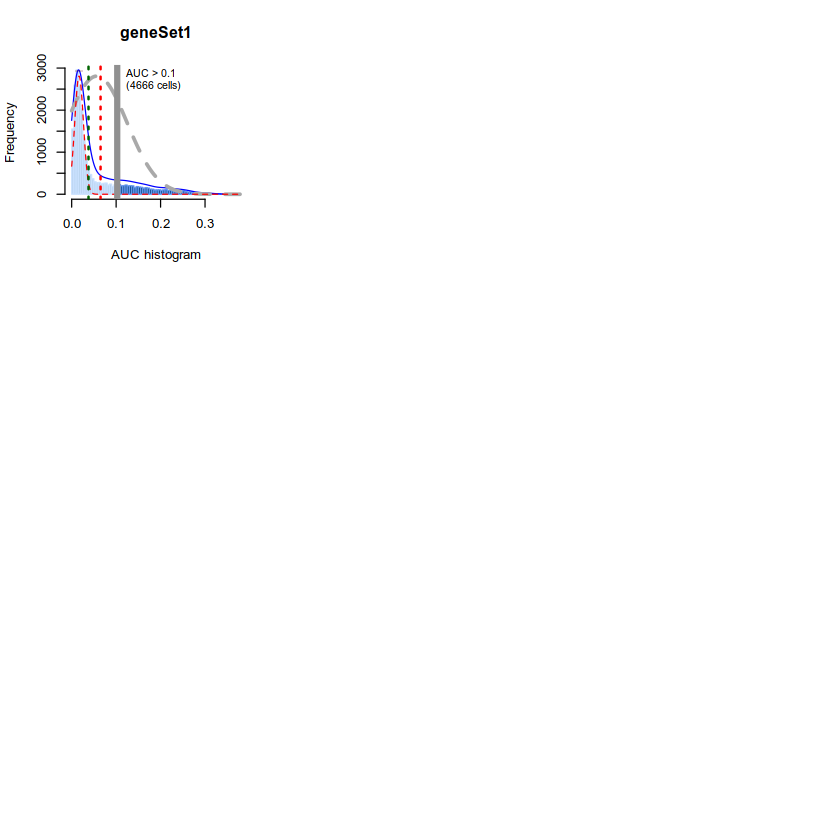

In [171]:
#Determine the cells with the given gene signatures or active gene sets
par(mfrow=c(3,3)) 
cells_assignment <- AUCell_exploreThresholds(cells_AUC, plotHist=TRUE, assign=TRUE) 
cells_assignment$geneSet1$aucThr$thresholds
cells_assignment$geneSet1$aucThr$selected

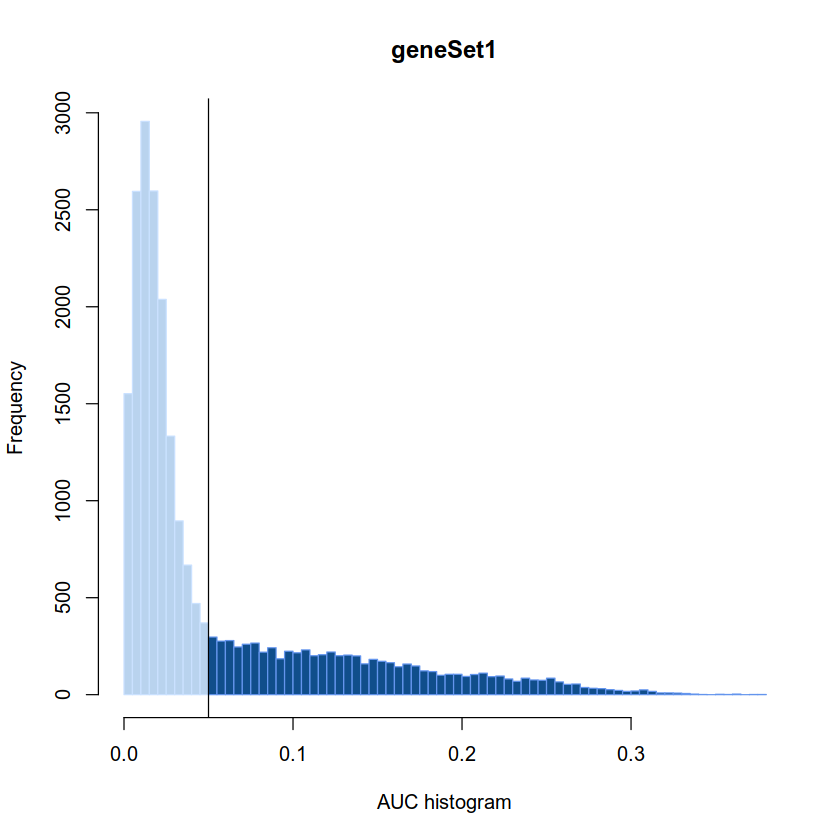

In [172]:
#ploting
geneSetName<-rownames(cells_AUC)[grep("geneSet1", rownames(cells_AUC))]
AUCell_plotHist(cells_AUC[geneSetName,], aucThr=0.05)
abline(v=0.05)

In [173]:
AUC<-data.frame(t(as.data.frame(cells_AUC@assays@data$AUC)))
colnames(AUC)<-"AUC"
#add AU#add AUC
glio.int<-AddMetaData(glio.int,metadata=AUC)
glio.int$S_G2M_AUC = AUC

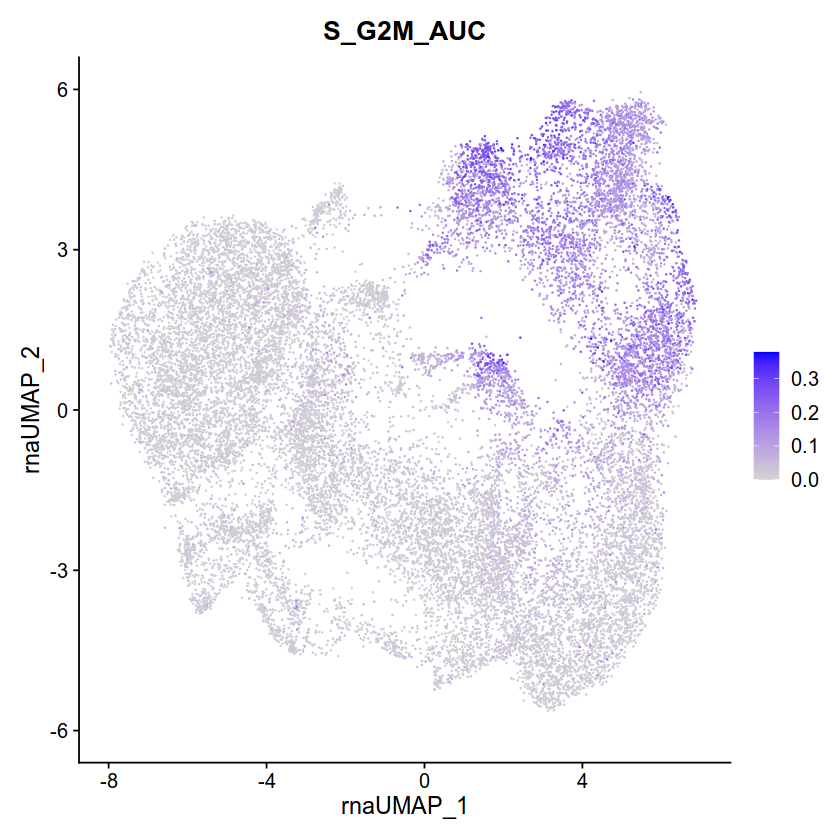

In [174]:
FeaturePlot(glio.int, features = 'S_G2M_AUC',reduction="rna.umap")

In [175]:
pdf("cycling.cluster.pdf")
FeaturePlot(glio.int, features = 'S_G2M_AUC',reduction="rna.umap")
dev.off()


png 
  2

In [176]:
table(glio.int$`CCA_RNA_snn_res.0.2`,glio.int$type)

   
    core edge
  0  402 8993
  1 5858 1447
  2 3290 2080
  3  274  397

In [177]:
table(glio.int$ATAC,glio.int$S_G2M_AUC > 0.1)

   
    FALSE TRUE
  1  4410 2042
  2  3449 1069
  3  3729  507
  4  3642  521
  5  2739  633

In [178]:
a<-table(glio.int$`CCA_RNA_snn_res.0.2`,glio.int$S_G2M_AUC > 0.1)

In [179]:
new<-t(a/rowSums(a))
new2<-data.frame(new)

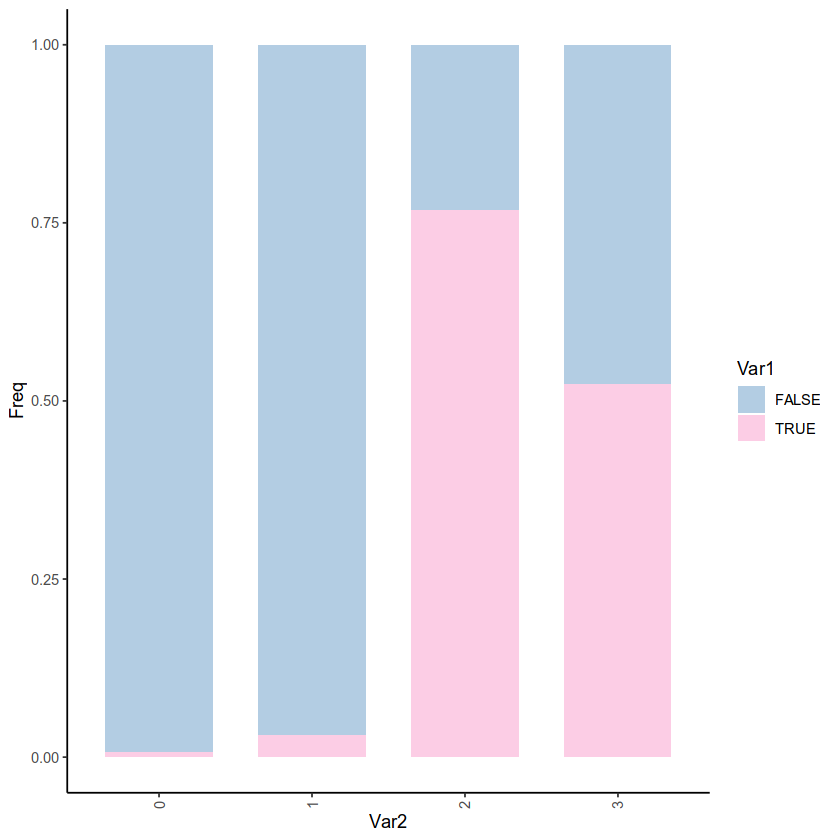

In [180]:
library(ggplot2)
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=col)+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))

In [181]:
pdf("cell.cyclying.barplot.pdf")
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=col)+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))
dev.off()

png 
  2

In [182]:
#subset_seurat[,names(which(subset_seurat$sample != "core1"))]

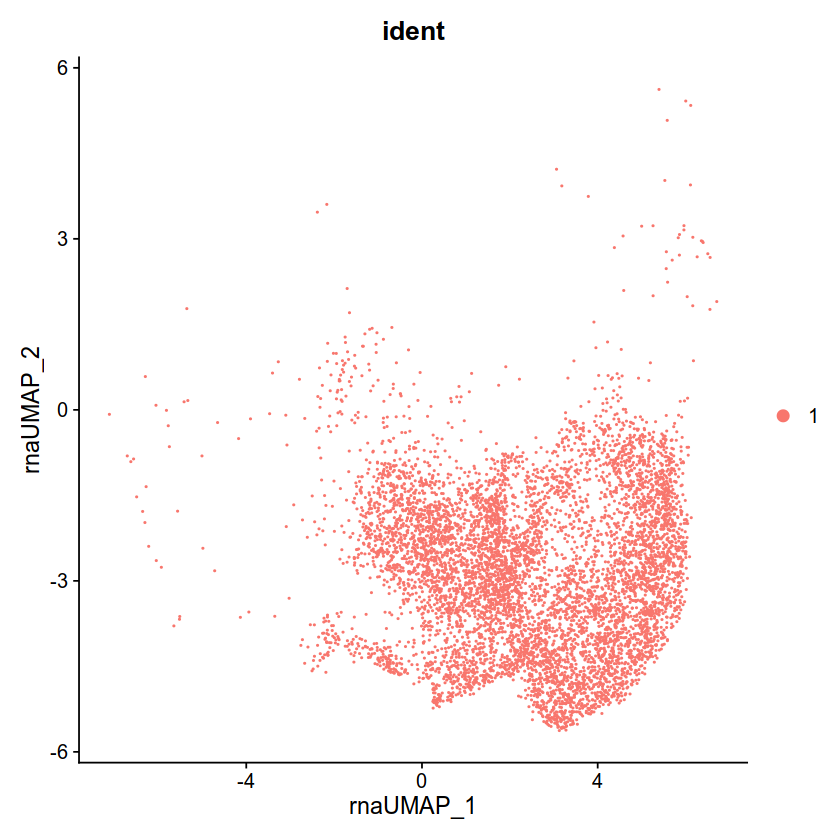

In [183]:
DefaultAssay(glio.int) <- "CCA_RNA"
clusters_of_interest <- 1
subset_seurat <- subset(glio.int, idents = clusters_of_interest)
DimPlot(subset_seurat, group.by = "ident")

In [184]:
#subset_seurat2<-subset_seurat[,names(which(subset_seurat$sample != "core1"｜ subset_seurat$sample != "core2"｜ subset_seurat$sample != "core3" ))]

In [185]:
subset_seurat2<-subset_seurat[,!(names(subset_seurat$sample) %in% names(which(subset_seurat$sample == "edge1"| subset_seurat$sample == "edge2"| subset_seurat$sample == "edge3" )))]

In [186]:
subset_seurat

An object of class Seurat 
510659 features across 7305 samples within 5 assays 
Active assay: CCA_RNA (2000 features, 2000 variable features)
 4 other assays present: RNA, ATAC_common_peak, chromvar, peaks
 6 dimensional reductions calculated: pca, rna.umap, lsi, umap, harmony, wnn.umap

In [187]:
subset_seurat2

An object of class Seurat 
510659 features across 5858 samples within 5 assays 
Active assay: CCA_RNA (2000 features, 2000 variable features)
 4 other assays present: RNA, ATAC_common_peak, chromvar, peaks
 6 dimensional reductions calculated: pca, rna.umap, lsi, umap, harmony, wnn.umap

In [188]:
subset_seurat<-subset_seurat2

In [189]:
DefaultAssay(subset_seurat) <- "CCA_RNA"

subset_seurat<-FindNeighbors(subset_seurat,dims=1:30,reduction="pca",k.param=60,prune.SNN=1/20)
#filtered_seurat<-FindNeighbors(filtered_seurat,dims=1:30)
names(subset_seurat@graphs)

Computing nearest neighbor graph

Warning message:
"Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Computing SNN



[1] "CCA_RNA_nn"  "CCA_RNA_snn"

In [190]:
for( res in c(0.1,0.15,0.2,0.25,0.3,0.4,0.6,0.8,1)){
   subset_seurat<-FindClusters(subset_seurat,graph.name='CCA_RNA_snn',resolution=res,algorithm=2)
    #filtered_seurat<-FindClusters(filtered_seurat,resolution=res)
}

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5858
Number of edges: 918277

Running Louvain algorithm with multilevel refinement...
Maximum modularity in 10 random starts: 0.9259
Number of communities: 2
Elapsed time: 1 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5858
Number of edges: 918277

Running Louvain algorithm with multilevel refinement...
Maximum modularity in 10 random starts: 0.9008
Number of communities: 2
Elapsed time: 1 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5858
Number of edges: 918277

Running Louvain algorithm with multilevel refinement...
Maximum modularity in 10 random starts: 0.8758
Number of communities: 2
Elapsed time: 1 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5858
Number of edges: 918277

Running Louvain algorithm with multilevel refinement...
Maximum modularity in 10 random starts: 0.8507
Number of communities: 2
Elapsed time: 1 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5858
Number of edges: 918277

Running Louvain algorithm with multilevel refinement...
Maximum modularity in 10 random starts: 0.8260
Number of communities: 3
Elapsed time: 1 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5858
Number of edges: 918277

Running Louvain algorithm with multilevel refinement...
Maximum modularity in 10 random starts: 0.7887
Number of communities: 5
Elapsed time: 2 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5858
Number of edges: 918277

Running Louvain algorithm with multilevel refinement...
Maximum modularity in 10 random starts: 0.7409
Number of communities: 6
Elapsed time: 2 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5858
Number of edges: 918277

Running Louvain algorithm with multilevel refinement...
Maximum modularity in 10 random starts: 0.7006
Number of communities: 7
Elapsed time: 2 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5858
Number of edges: 918277

Running Louvain algorithm with multilevel refinement...
Maximum modularity in 10 random starts: 0.6688
Number of communities: 8
Elapsed time: 2 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


In [191]:
library(RColorBrewer)
n <- 20
qual_col_pals = brewer.pal.info[brewer.pal.info$category == 'qual',]
col_vector = unlist(mapply(brewer.pal, qual_col_pals$maxcolors, rownames(qual_col_pals)))
col<-sample(col_vector, n)

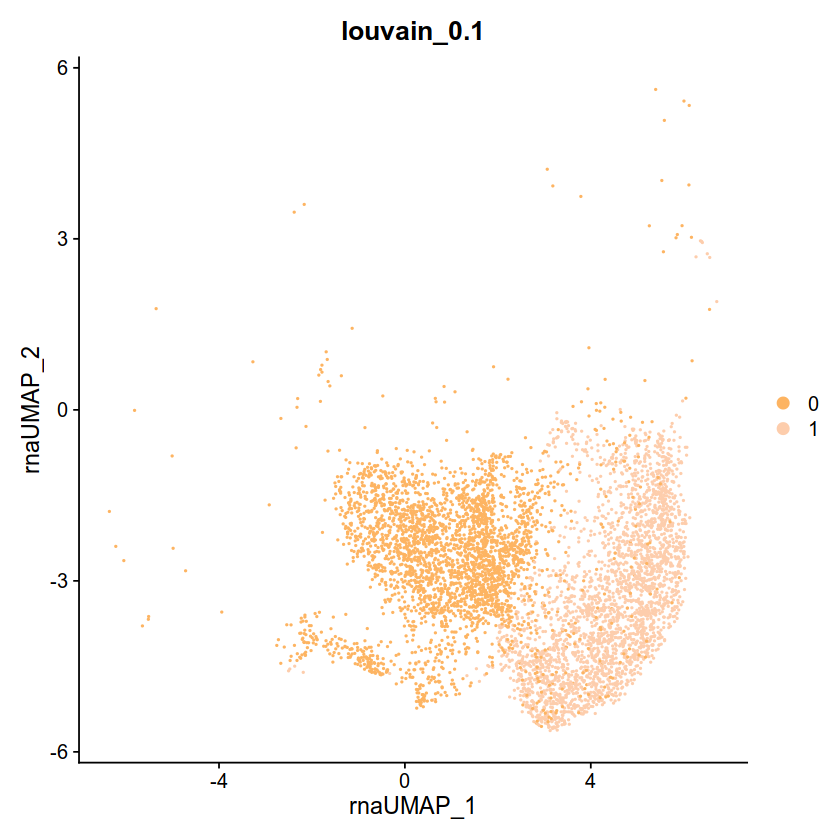

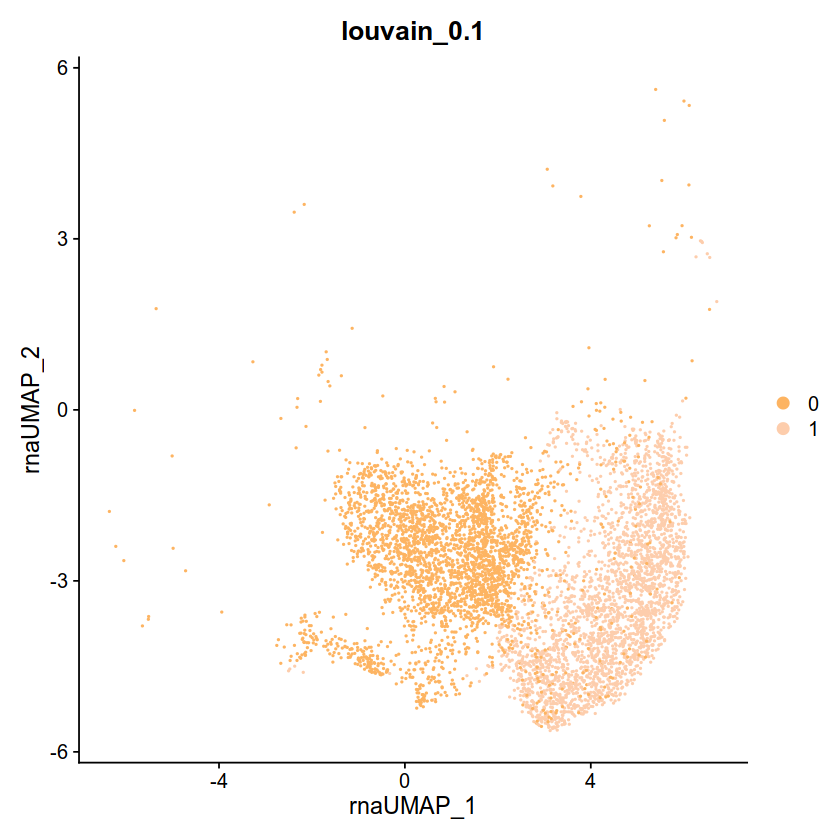

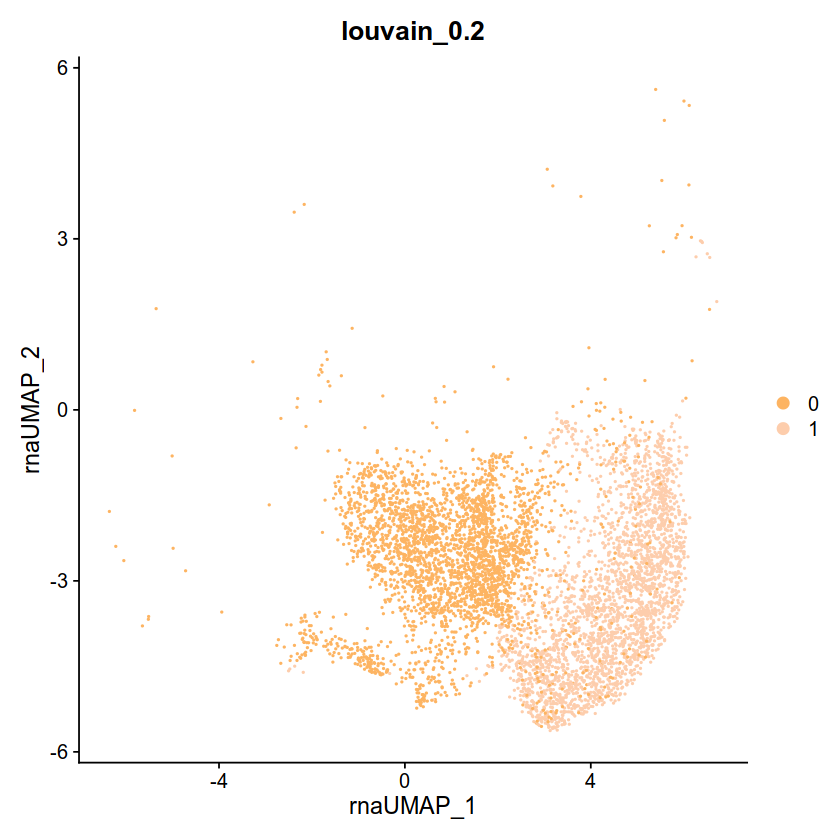

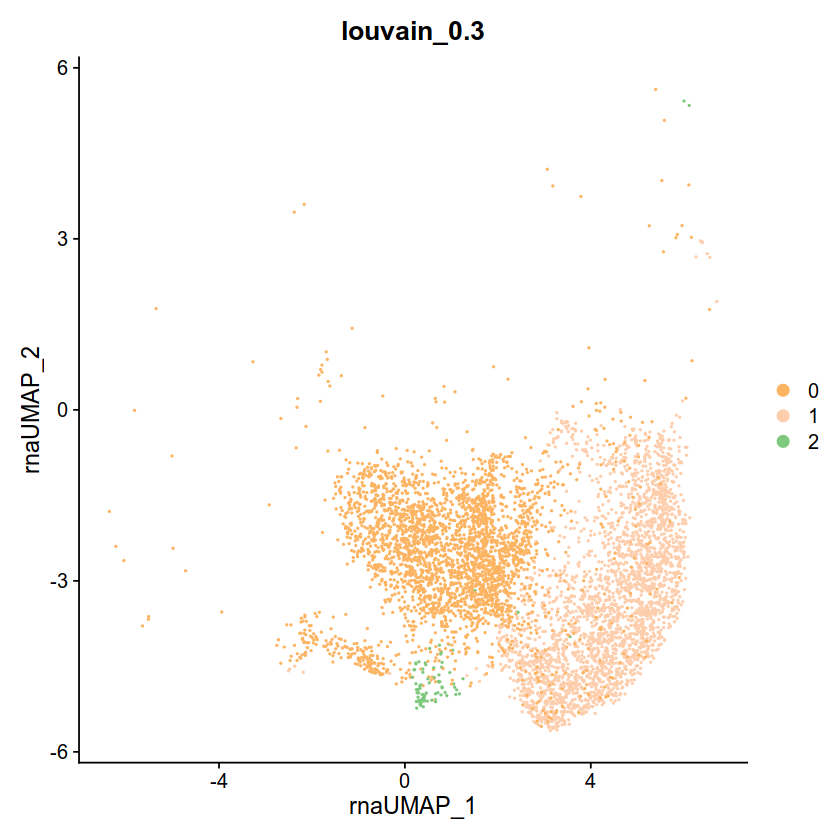

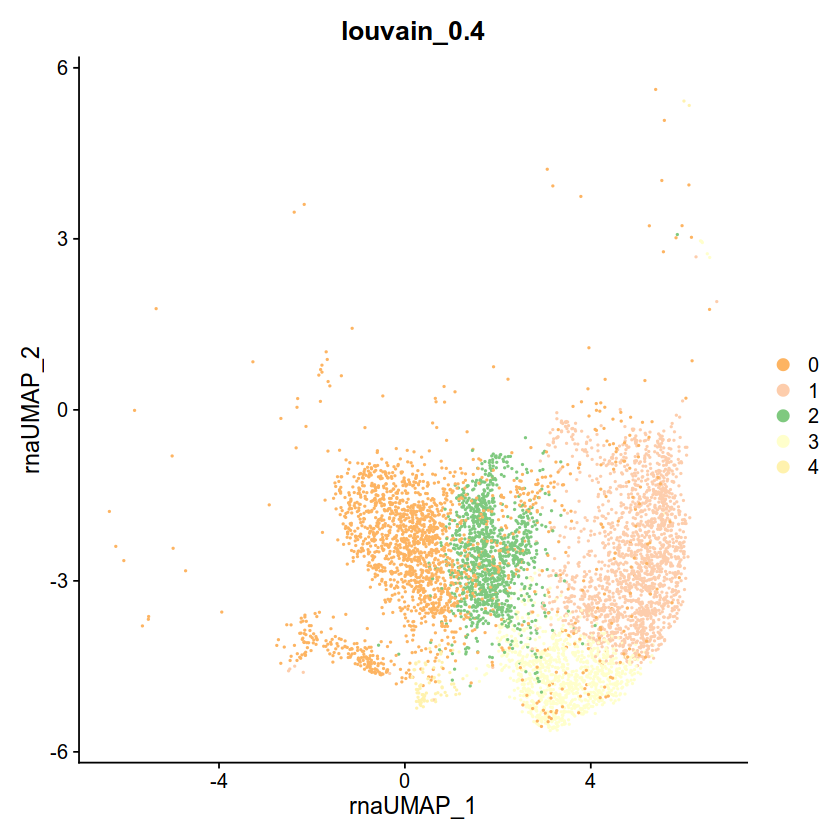

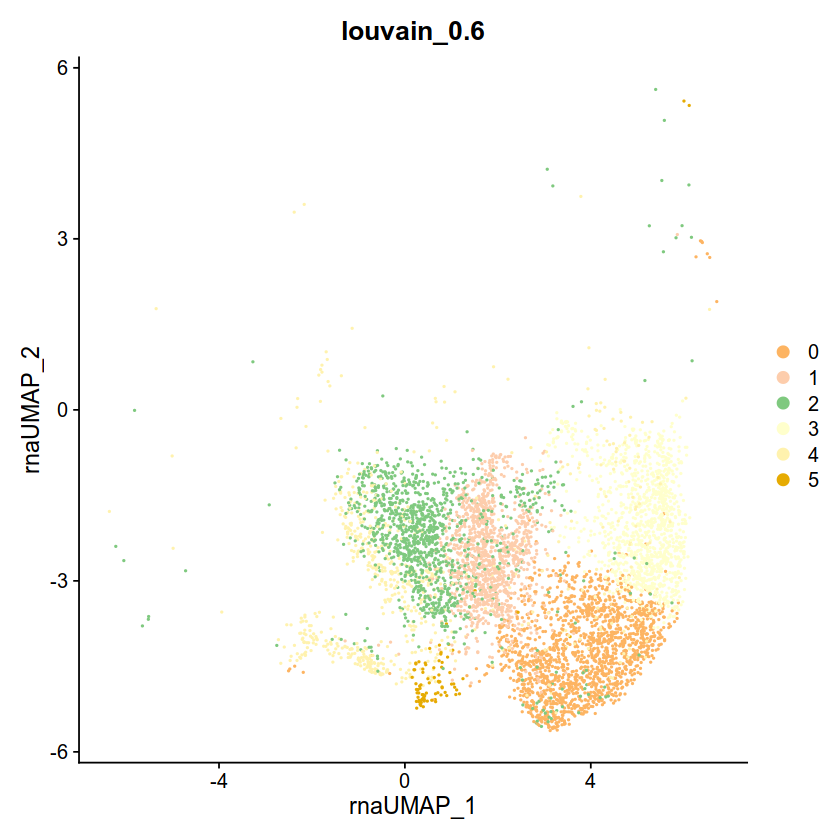

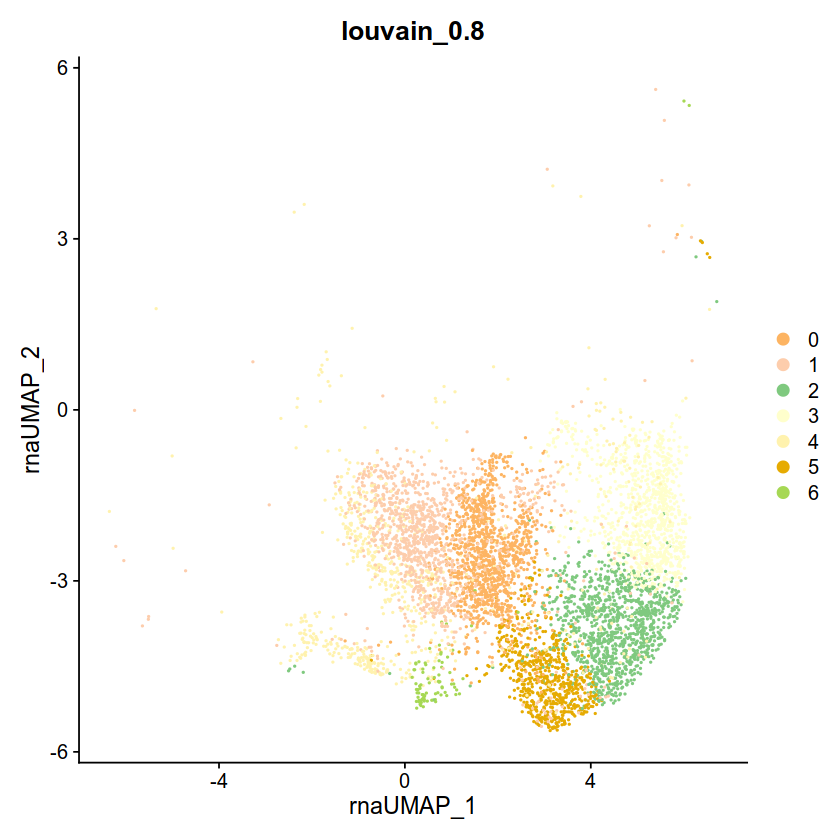

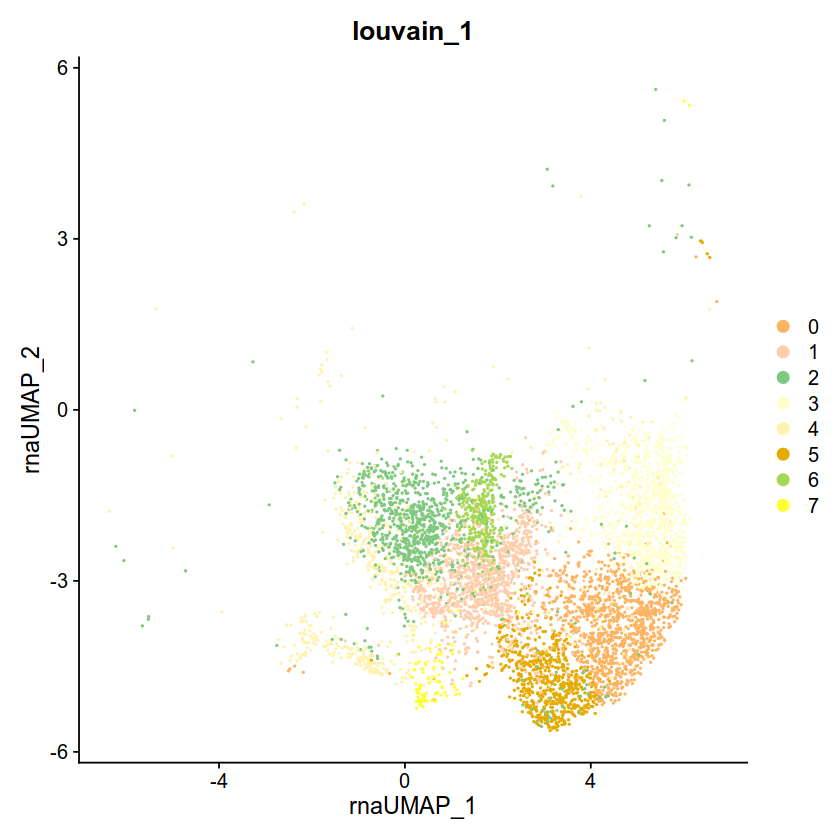

In [192]:
DimPlot(subset_seurat, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.1",cols = col) + ggtitle("louvain_0.1")
DimPlot(subset_seurat, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.15",cols = col) + ggtitle("louvain_0.1")

DimPlot(subset_seurat,reduction="rna.umap",group.by="CCA_RNA_snn_res.0.2",cols = col) + ggtitle("louvain_0.2")
DimPlot(subset_seurat,reduction="rna.umap",group.by="CCA_RNA_snn_res.0.3",cols = col) + ggtitle("louvain_0.3")
DimPlot(subset_seurat,reduction="rna.umap",group.by="CCA_RNA_snn_res.0.4",cols = col) + ggtitle("louvain_0.4")
#DimPlot(alldata.int,reduction="tsne",group.by="CCA_snn_res.0.4",cols = col) + ggtitle("louvain_0.4")
DimPlot(subset_seurat, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.6",cols = col) + ggtitle("louvain_0.6")
DimPlot(subset_seurat,reduction="rna.umap",group.by="CCA_RNA_snn_res.0.8",cols = col) + ggtitle("louvain_0.8")
DimPlot(subset_seurat, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.1",cols = col) + ggtitle("louvain_1")

In [193]:
DefaultAssay(subset_seurat) <- "peaks"


In [194]:
subset_seurat<-FindNeighbors(subset_seurat,dims=1:30,k.param=60,reduction = 'harmony',prune.SNN=1/20)
#filtered_seurat<-FindNeighbors(filtered_seurat,dims=1:30)
names(subset_seurat@graphs)

Computing nearest neighbor graph

Warning message:
"Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Computing SNN



[1] "CCA_RNA_nn"  "CCA_RNA_snn" "peaks_nn"    "peaks_snn"

In [195]:
for( res in c(0.1,0.2,0.25,0.3,0.4,0.6,0.8,1)){
    subset_seurat<-FindClusters(subset_seurat,graph.name='peaks_snn',resolution=res,algorithm=1)
    #filtered_seurat<-FindClusters(filtered_seurat,resolution=res)
}

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5858
Number of edges: 888481

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9000
Number of communities: 1
Elapsed time: 1 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5858
Number of edges: 888481

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8482
Number of communities: 2
Elapsed time: 2 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5858
Number of edges: 888481

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8267
Number of communities: 3
Elapsed time: 2 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5858
Number of edges: 888481

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8093
Number of communities: 3
Elapsed time: 2 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5858
Number of edges: 888481

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7748
Number of communities: 3
Elapsed time: 2 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5858
Number of edges: 888481

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7318
Number of communities: 6
Elapsed time: 2 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5858
Number of edges: 888481

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.6989
Number of communities: 7
Elapsed time: 2 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5858
Number of edges: 888481

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.6680
Number of communities: 8
Elapsed time: 2 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


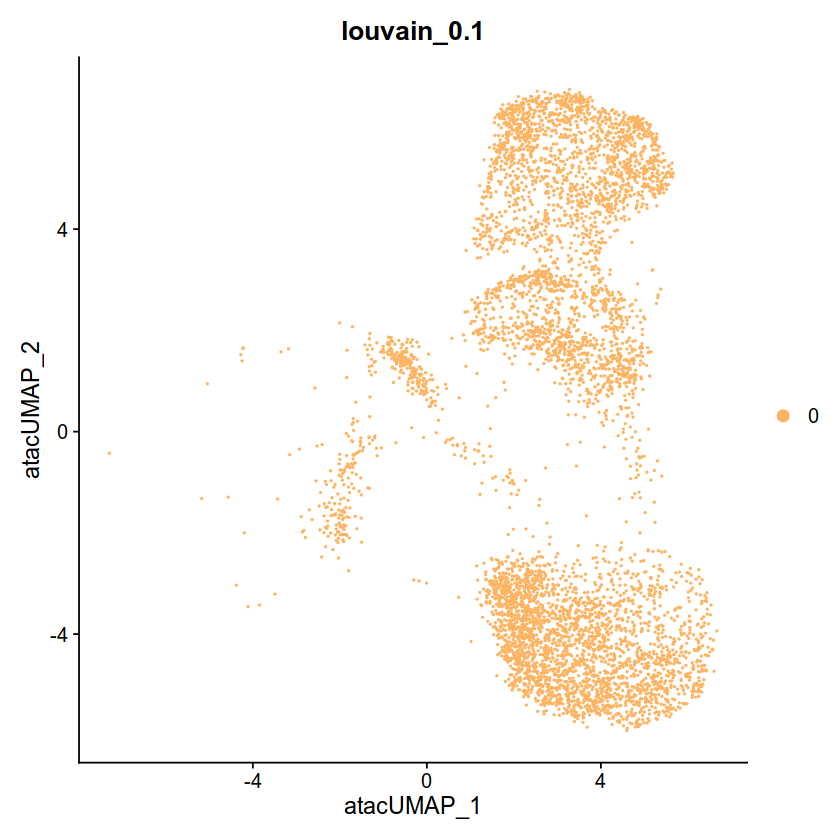

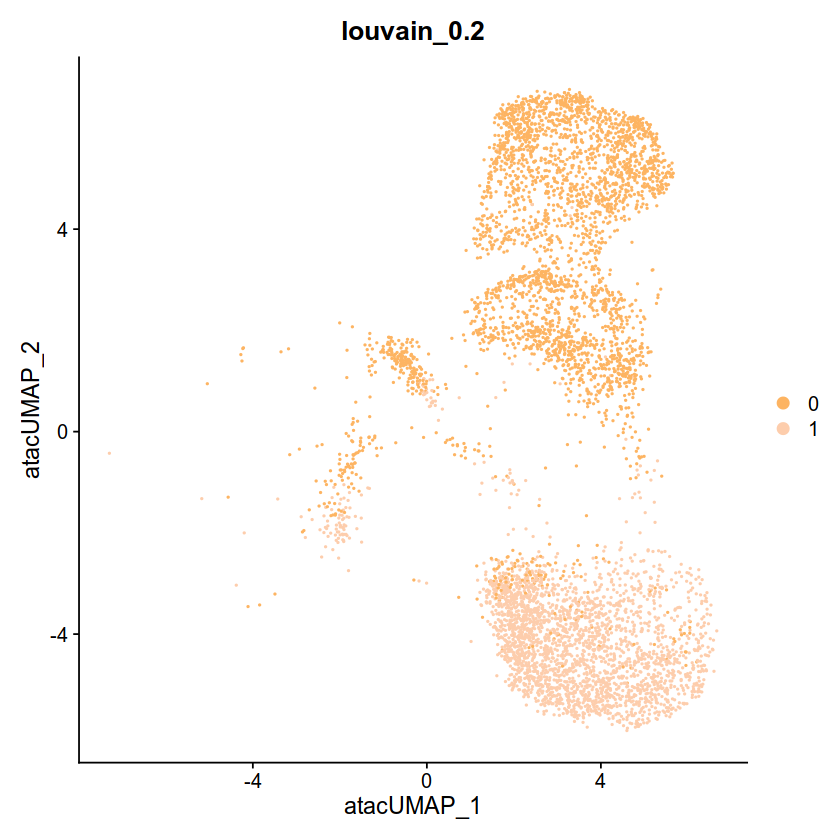

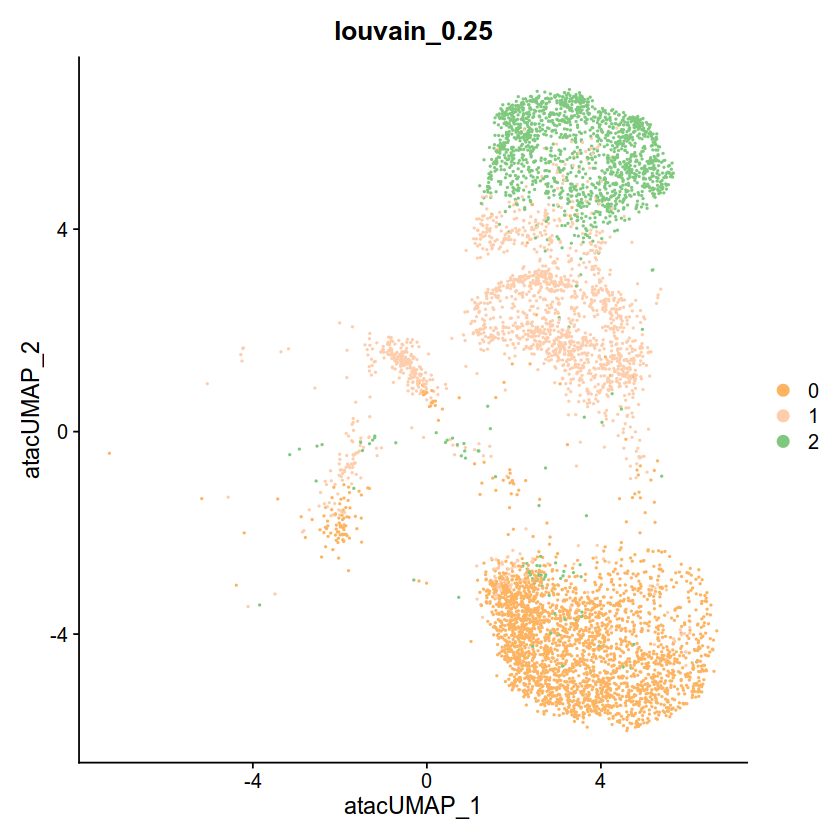

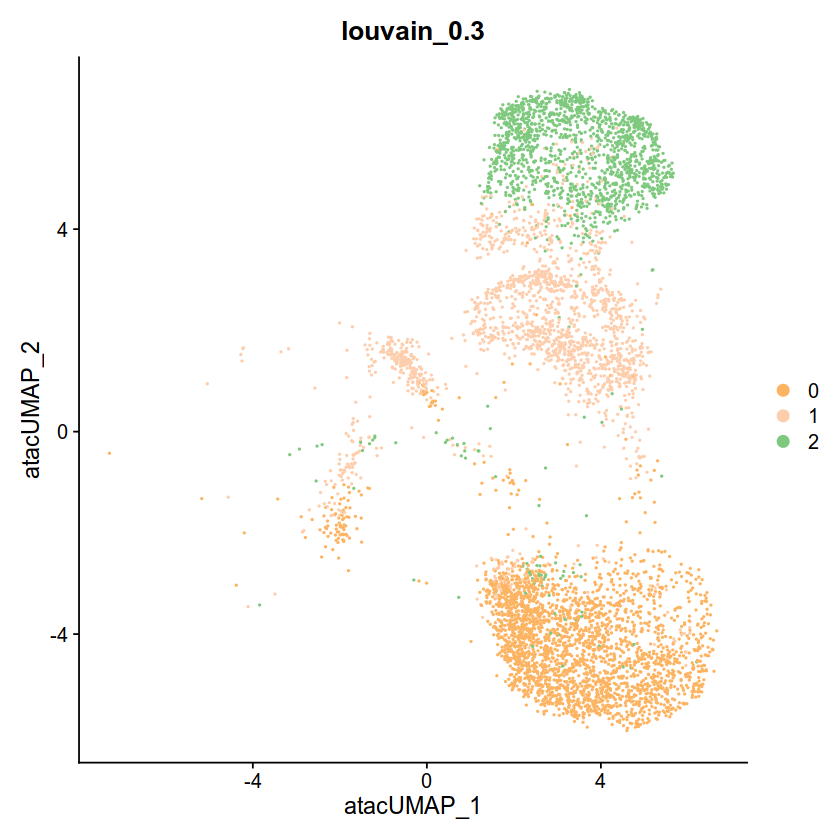

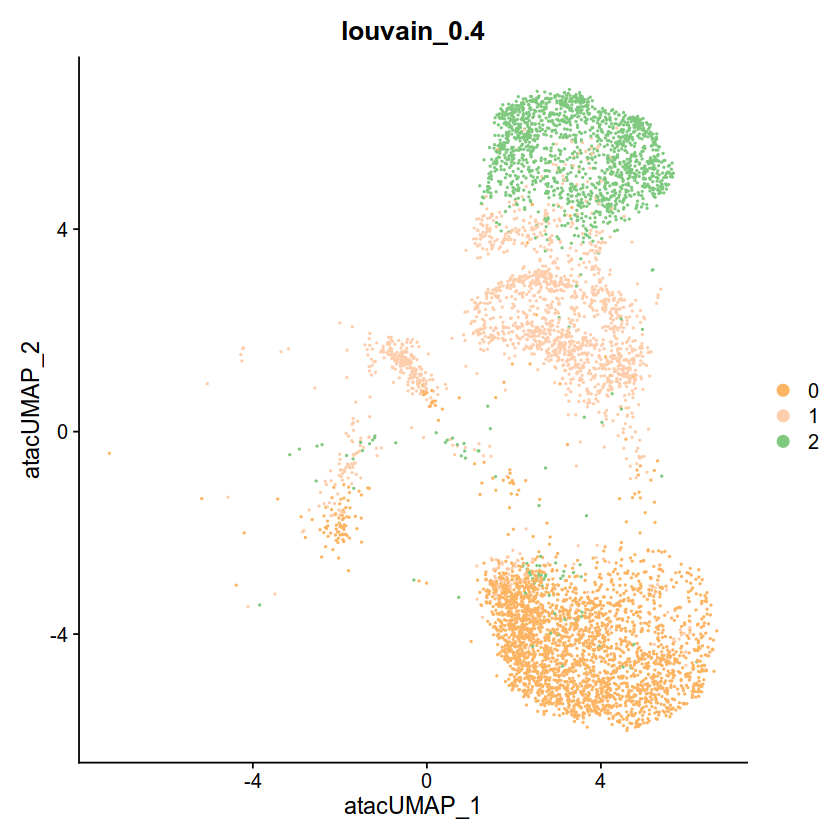

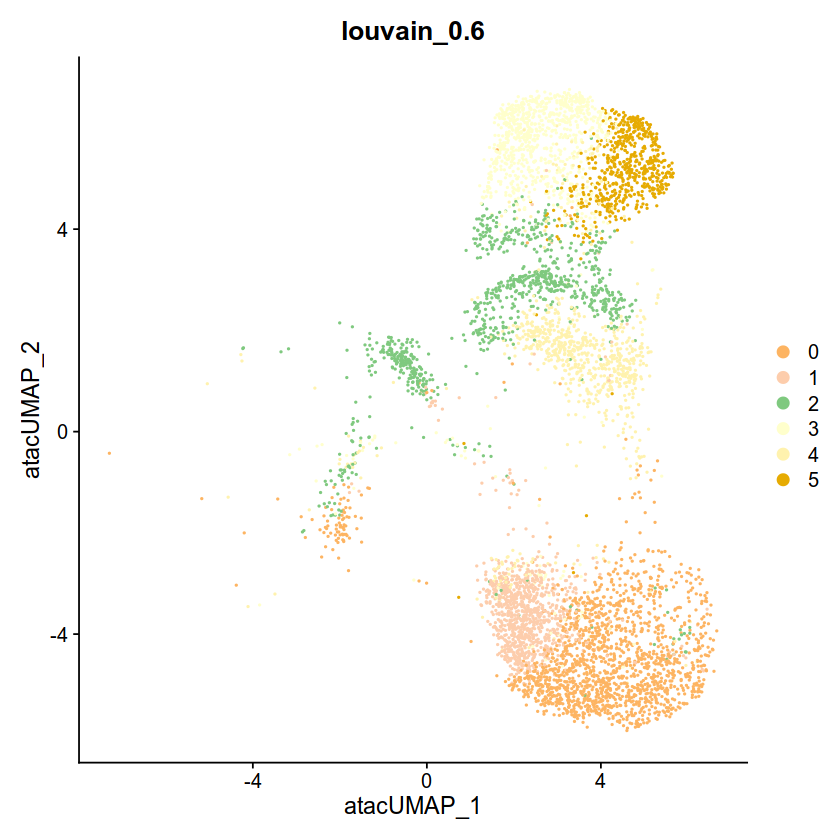

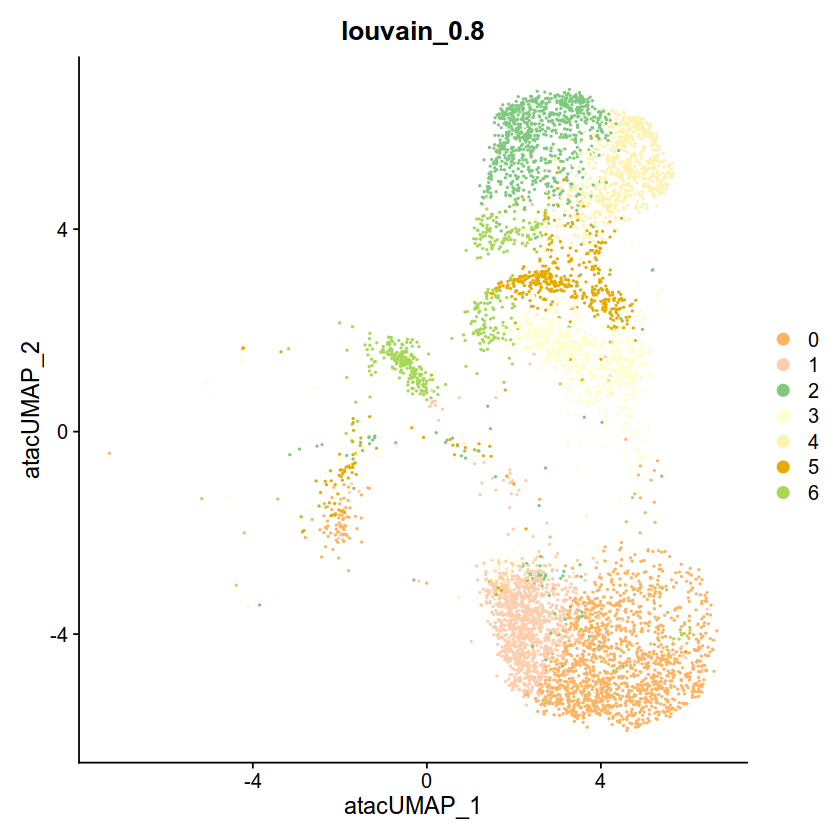

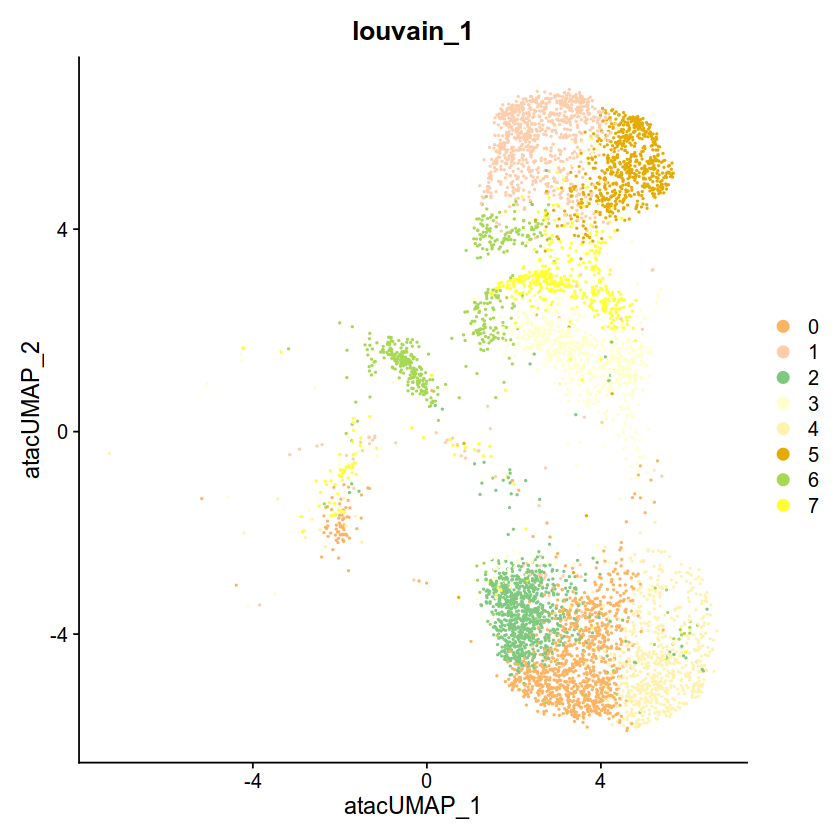

In [196]:
DimPlot(subset_seurat, reduction = "umap", group.by = "peaks_snn_res.0.1",cols = col) + ggtitle("louvain_0.1")
DimPlot(subset_seurat,reduction="umap",group.by="peaks_snn_res.0.2",cols = col) + ggtitle("louvain_0.2")
DimPlot(subset_seurat,reduction="umap",group.by="peaks_snn_res.0.25",cols = col) + ggtitle("louvain_0.25")

DimPlot(subset_seurat,reduction="umap",group.by="peaks_snn_res.0.3",cols = col) + ggtitle("louvain_0.3")
DimPlot(subset_seurat,reduction="umap",group.by="peaks_snn_res.0.4",cols = col) + ggtitle("louvain_0.4")
#DimPlot(alldata.int,reduction="tsne",group.by="CCA_snn_res.0.4",cols = col) + ggtitle("louvain_0.4")
DimPlot(subset_seurat, reduction = "umap", group.by = "peaks_snn_res.0.6",cols = col) + ggtitle("louvain_0.6")
DimPlot(subset_seurat,reduction="umap",group.by="peaks_snn_res.0.8",cols = col) + ggtitle("louvain_0.8")
DimPlot(subset_seurat, reduction = "umap", group.by = "peaks_snn_res.1",cols = col) + ggtitle("louvain_1")

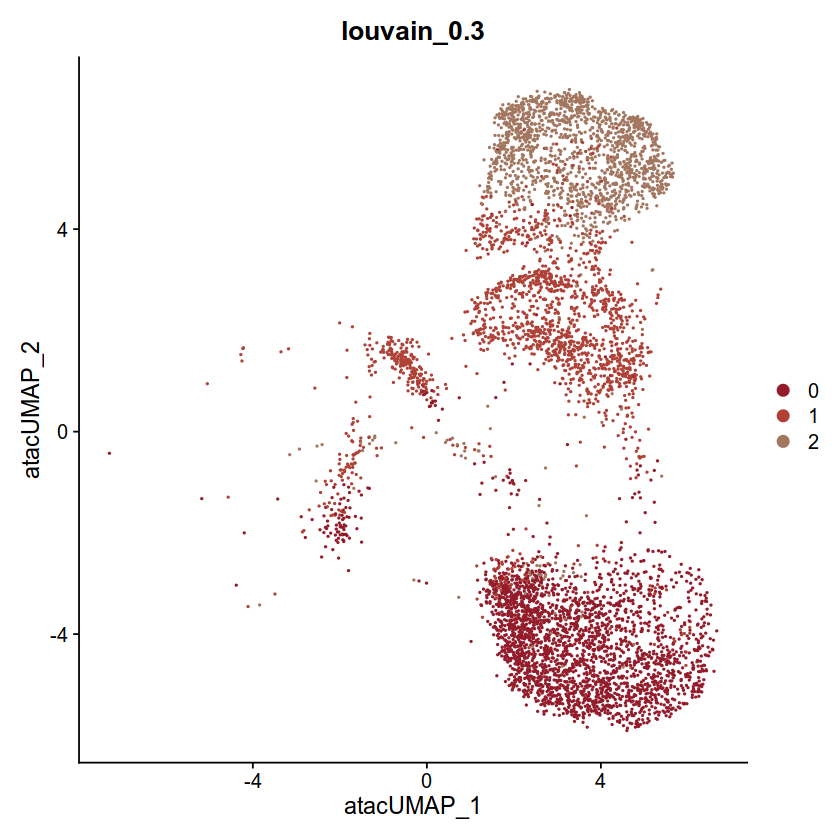

png 
  2

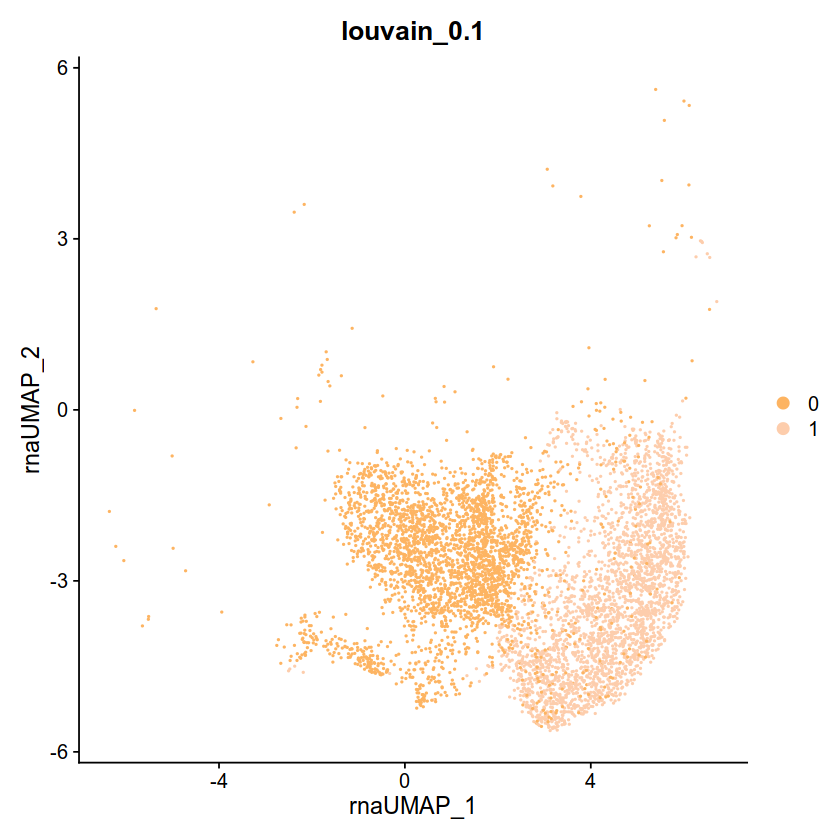

In [197]:
DimPlot(subset_seurat,reduction="umap",group.by="peaks_snn_res.0.3",cols = c("#941B2A","#AF4137","#A37660")) + ggtitle("louvain_0.3")
DimPlot(subset_seurat, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.2",cols = col) + ggtitle("louvain_0.1")

pdf("core.sub.clsuters.pdf")
DimPlot(subset_seurat,reduction="umap",group.by="peaks_snn_res.0.3",cols = c("#941B2A","#AF4137","#A37660")) + ggtitle("louvain_0.3")
DimPlot(subset_seurat, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.2",cols = col) + ggtitle("louvain_0.1")

dev.off()


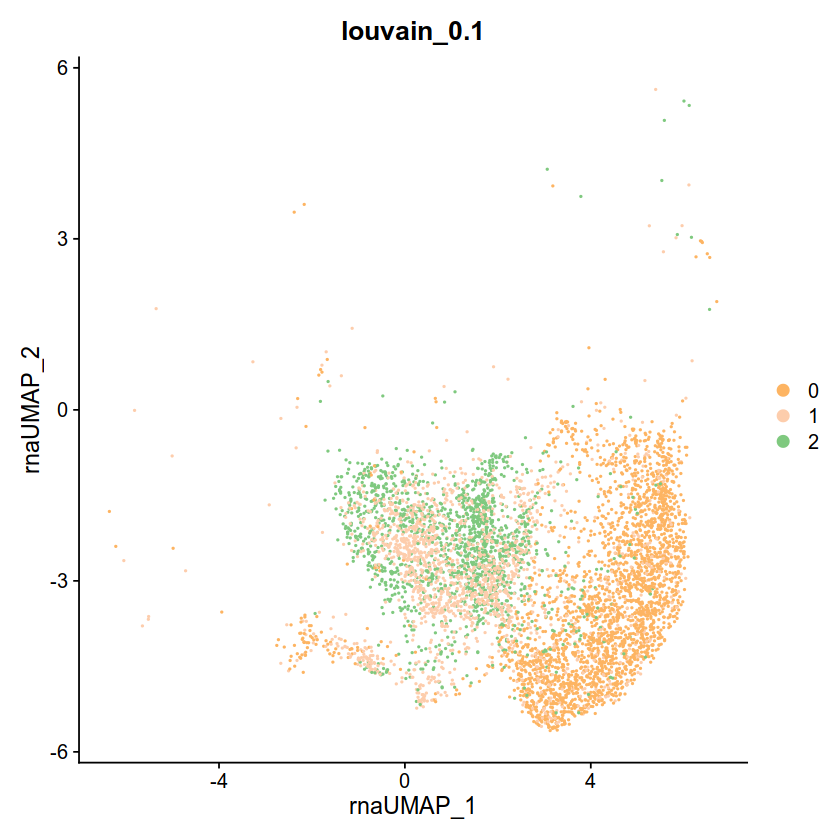

In [198]:
DimPlot(subset_seurat, reduction = "rna.umap", group.by = "peaks_snn_res.0.3",cols = col) + ggtitle("louvain_0.1")


In [199]:
table(subset_seurat$CCA_RNA_snn_res.0.2,subset_seurat$peaks_snn_res.0.3)
col<-c("#941B2A","#AF4137","#A37660")

   
       0    1    2
  0  208 1456 1449
  1 2410  271   64

In [200]:
a<-table(subset_seurat$CCA_RNA_snn_res.0.2,subset_seurat$peaks_snn_res.0.3)
new<-t(a)
new2<-data.frame(new)
new2$Freq <- new2$Freq
new
new2

   
       0    1
  0  208 2410
  1 1456  271
  2 1449   64

Var1,Var2,Freq
<fct>,<fct>,<int>
0,0,208
1,0,1456
2,0,1449
0,1,2410
1,1,271
2,1,64


[1] 0 1 2 0 1 2
Levels: 0 1 2

png 
  2

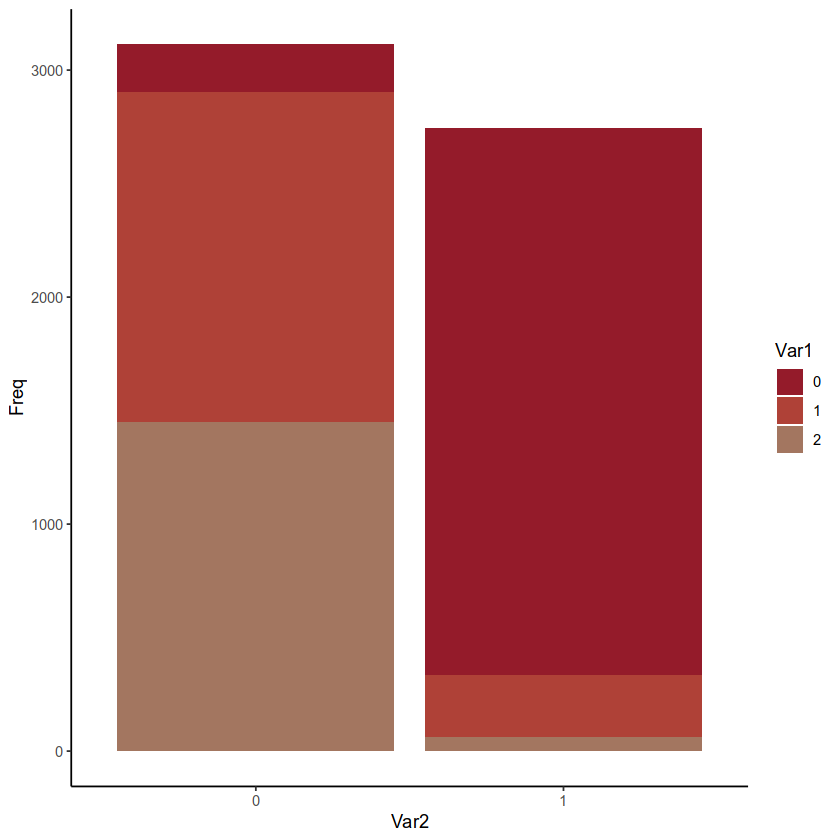

In [201]:
new2$Var1<-factor(new2$Var1)
new2$Var2<-factor(new2$Var2)
new2$Var1
ggplot(new2, aes( y=Freq, x=Var2,fill=Var1))+geom_bar(stat="identity")+scale_fill_manual(values=col)+theme_classic()
pdf("core.overlap.barplot.scRNA_scATAC.pdf")
ggplot(new2, aes( y=Freq, x=Var2,fill=Var1))+geom_bar(stat="identity")+scale_fill_manual(values=col)+theme_classic()
dev.off()

   
    core1 core2 core3
  0  2519     9    90
  1   401   243  1083
  2   104  1382    27

Var1,Var2,Freq
<fct>,<fct>,<int>
0,core1,2519
1,core1,401
2,core1,104
0,core2,9
1,core2,243
2,core2,1382
0,core3,90
1,core3,1083
2,core3,27


png 
  2

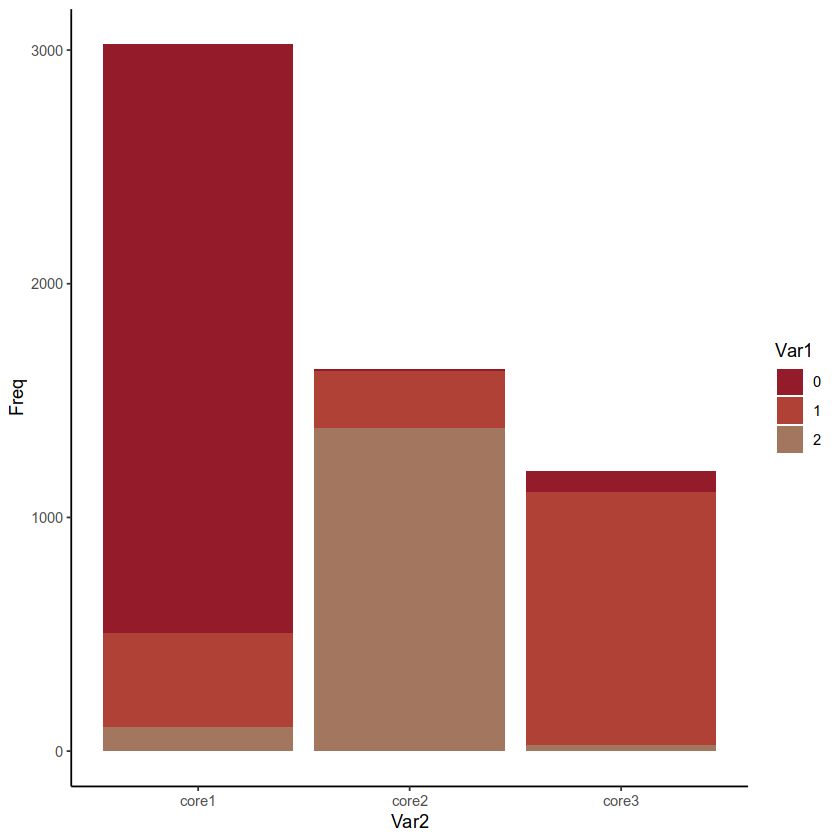

In [202]:
a<-table(subset_seurat$sample,subset_seurat$peaks_snn_res.0.3)
new<-t(a)
new2<-data.frame(new)
new2$Freq <- new2$Freq
new
new2
new2$Var1<-factor(new2$Var1)
new2$Var2<-factor(new2$Var2)
ggplot(new2, aes( y=Freq, x=Var2,fill=Var1))+geom_bar(stat="identity")+scale_fill_manual(values=col)+theme_classic()
pdf("core.core.cluser.absolute.pdf")
ggplot(new2, aes( y=Freq, x=Var2,fill=Var1))+geom_bar(stat="identity")+scale_fill_manual(values=col)+theme_classic()
dev.off()

   
          core1       core2       core3
  0 0.833002646 0.005507956 0.075000000
  1 0.132605820 0.148714810 0.902500000
  2 0.034391534 0.845777234 0.022500000

Var1,Var2,Freq
<fct>,<fct>,<dbl>
0,core1,0.833002646
1,core1,0.132605820
2,core1,0.034391534
0,core2,0.005507956
1,core2,0.148714810
2,core2,0.845777234
0,core3,0.075000000
1,core3,0.902500000
2,core3,0.022500000


png 
  2

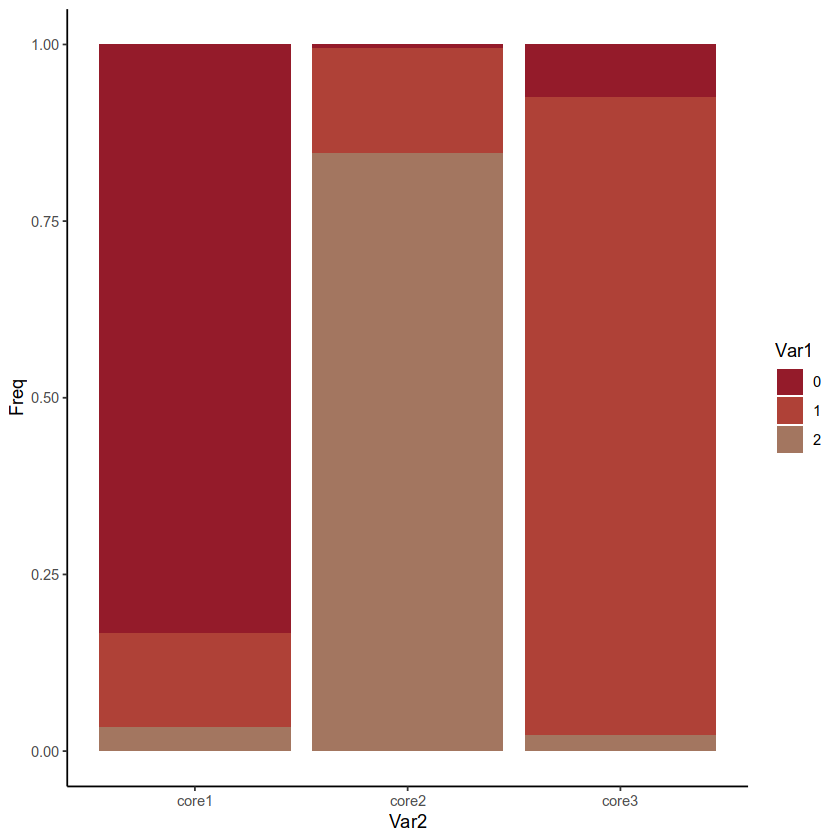

In [203]:
a<-table(subset_seurat$sample,subset_seurat$peaks_snn_res.0.3)
new<-t(a/rowSums(a))
new2<-data.frame(new)
new2$Freq <- new2$Freq
new
new2
new2$Var1<-factor(new2$Var1)
new2$Var2<-factor(new2$Var2)
ggplot(new2, aes( y=Freq, x=Var2,fill=Var1))+geom_bar(stat="identity")+scale_fill_manual(values=col)+theme_classic()
pdf("core.core.cluser.percentage.pdf")
ggplot(new2, aes( y=Freq, x=Var2,fill=Var1))+geom_bar(stat="identity")+scale_fill_manual(values=col)+theme_classic()
dev.off()

   
    core1 core2 core3
  0   343  1620  1150
  1  2681    14    50

Var1,Var2,Freq
<fct>,<fct>,<int>
0,core1,343
1,core1,2681
0,core2,1620
1,core2,14
0,core3,1150
1,core3,50


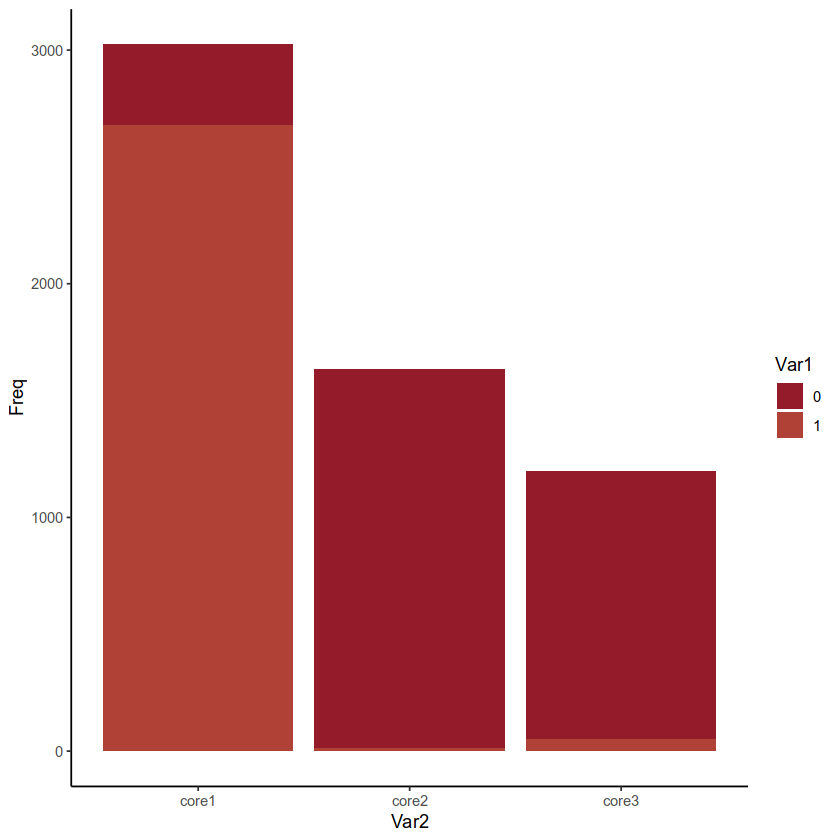

In [204]:
a<-table(subset_seurat$sample,subset_seurat$CCA_RNA_snn_res.0.2)
new<-t(a)
new2<-data.frame(new)
new2$Freq <- new2$Freq
new
new2
new2$Var1<-factor(new2$Var1)
new2$Var2<-factor(new2$Var2)
ggplot(new2, aes( y=Freq, x=Var2,fill=Var1))+geom_bar(stat="identity")+scale_fill_manual(values=col)+theme_classic()


In [205]:
load('/disk1/pengweixing/lene_sc_glio/02.single_cell/03.Edge_analysis/02.quad_meta_model/Neftel.Rdata')
core_matrix = as.matrix(subset_seurat@assays$RNA@data)
core_rankings <- AUCell_buildRankings(core_matrix, nCores=30, plotStats=FALSE)
rm(core_matrix)
MES2_core_AUC <- AUCell_calcAUC(MES2geneSets, core_rankings)
MES1_core_AUC <- AUCell_calcAUC(MES1geneSets, core_rankings)
NPC1_core_AUC <- AUCell_calcAUC(NPC1geneSets, core_rankings)
NPC2_core_AUC <- AUCell_calcAUC(NPC2geneSets, core_rankings)
AC_core_AUC <- AUCell_calcAUC(ACgeneSets, core_rankings)
OPC_core_AUC <- AUCell_calcAUC(OPCgeneSets, core_rankings)

Warning message in asMethod(object):
"sparse->dense coercion: allocating vector of size 1.6 GiB"
Warning message in .AUCell_buildRankings(exprMat = exprMat, featureType = featureType, :
"nCores is no longer used. It will be deprecated in the next AUCell version."
Genes in the gene sets NOT available in the dataset: 
	MES2: 	1 (2% of 50)

Genes in the gene sets NOT available in the dataset: 
	MES1: 	1 (2% of 50)

Genes in the gene sets NOT available in the dataset: 
	NPC1: 	2 (4% of 50)

Genes in the gene sets NOT available in the dataset: 
	NPC2: 	4 (8% of 50)

Genes in the gene sets NOT available in the dataset: 
	AC: 	1 (3% of 39)

Genes in the gene sets NOT available in the dataset: 
	OPC: 	3 (6% of 50)



In [206]:
core_AUC_list = c('MES1_core_AUC','MES2_core_AUC','NPC1_core_AUC',
                              'NPC2_core_AUC','AC_core_AUC','OPC_core_AUC')
for(each in core_AUC_list){
    AUC <- t(as.data.frame(get(each)@assays@data$AUC))
    colnames(AUC) <- paste0(colnames(AUC), "_AUC")
    AUC <- data.frame(AUC)
    #print(AUC)
    subset_seurat <- AddMetaData(subset_seurat, metadata = AUC)
}

In [207]:
core_meta <- subset_seurat@meta.data

core_meta$MES_mean <- apply(cbind(core_meta$MES1_AUC,core_meta$MES2_AUC),1,mean)
core_meta$NPC_mean <- apply(cbind(core_meta$NPC1_AUC,core_meta$NPC2_AUC),1,mean)
a1 <- apply(cbind(core_meta$OPC_AUC, core_meta$NPC_mean), 1, max)
b1 <- apply(cbind(core_meta$AC_AUC, core_meta$MES_mean), 1, max)
core_meta$Y.axis <-  a1 - b1
core_meta$CellClass <- ifelse(core_meta$Y.axis > 0, "OPC.NPC", "AC.MES")

head(core_meta)

,orig.ident,nCount_RNA,nFeature_RNA,nCount_ATAC,nFeature_ATAC,type,patient,nCount_ATAC_common_peak,nFeature_ATAC_common_peak,nucleosome_signal,⋯,MES1_AUC,MES2_AUC,NPC1_AUC,NPC2_AUC,AC_AUC,OPC_AUC,MES_mean,NPC_mean,Y.axis,CellClass
,<chr>,<dbl>,<int>,<dbl>,<int>,<chr>,<chr>,<dbl>,<int>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
core1_AAACATGCAAATGCCC-1,SeuratProject,12596,4319,28791,12324,core,patient1,16132,13225,1.0550133,⋯,0.1754695,0.09028861,0.2714849,0.2518131,0.2331159,0.1885811,0.1328791,0.2616490,0.028533095,OPC.NPC
core1_AAACCAACACCGTTCC-1,SeuratProject,10937,3993,11599,5578,core,patient1,6435,5927,1.0090909,⋯,0.2344340,0.13216715,0.1925570,0.1926634,0.2238041,0.1913010,0.1833006,0.1926102,-0.031193864,AC.MES
core1_AAACCAACATGTTTGG-1,SeuratProject,9655,3861,28395,12026,core,patient1,15489,12658,0.8783784,⋯,0.2056976,0.10268493,0.1463696,0.1313248,0.2170054,0.2222562,0.1541912,0.1388472,0.005250848,OPC.NPC
core1_AAACCGAAGCCACAAT-1,SeuratProject,16867,5756,52732,19107,core,patient1,29243,20658,0.8665768,⋯,0.1382693,0.09370127,0.1721330,0.2391004,0.3445095,0.1787964,0.1159853,0.2056167,-0.138892791,AC.MES
core1_AAACCGAAGCCGGTAC-1,SeuratProject,7807,3552,27321,11662,core,patient1,14966,12298,0.8558477,⋯,0.2466834,0.10504667,0.1072977,0.1573877,0.1422346,0.1474290,0.1758650,0.1323427,-0.028436001,AC.MES
core1_AAACCGCGTCACAGAC-1,SeuratProject,11678,4445,32238,13569,core,patient1,18132,14542,1.1586425,⋯,0.2298009,0.10656090,0.1401421,0.2066149,0.1582289,0.1398815,0.1681809,0.1733785,0.005197621,OPC.NPC


In [208]:
cc <- cbind(core_meta$AC_AUC, core_meta$MES_mean, core_meta$NPC_mean, core_meta$OPC_AUC)
colnames(cc) <- c("AC", "MES", "NPC", "OPC")
core_meta$MaxClass <- apply(cc,1,function(x) which(x==max(x)))
core_meta$MaxClass <- gsub(1, "AC", core_meta$MaxClass)
core_meta$MaxClass <- gsub(2, "MES", core_meta$MaxClass)
core_meta$MaxClass <- gsub(3, "NPC", core_meta$MaxClass)
core_meta$MaxClass <- gsub(4, "OPC", core_meta$MaxClass)
    
core_meta$ClassSign_X <- core_meta$MaxClass
core_meta$ClassSign_X <- gsub("AC", -1, core_meta$ClassSign_X )
core_meta$ClassSign_X <- gsub("MES", 1,core_meta$ClassSign_X )
core_meta$ClassSign_X <- gsub("OPC", -1, core_meta$ClassSign_X )
core_meta$ClassSign_X <- gsub("NPC", 1, core_meta$ClassSign_X )

In [209]:
core_meta$OPC.NPC_x <- log(abs(core_meta$OPC_AUC - core_meta$NPC_mean)+1,1.6)
core_meta$AC.MES_x <- log(abs(core_meta$AC_AUC - core_meta$MES_mean)+1,2)
core_meta$X.axis <- NA
core_meta$X.axis[grep("OPC.NPC", core_meta$CellClass)] <- core_meta$OPC.NPC_x[grep("OPC.NPC", core_meta$CellClass)]
core_meta$X.axis[grep("AC.MES", core_meta$CellClass)] <- core_meta$AC.MES_x[grep("AC.MES", core_meta$CellClass)]
#now change the sign based on maxclass for cell
#if AC is the max value, make postive; if MES is the max, make negative
#OPC = +, NPC = -
core_meta$X.axis_Class <- core_meta$X.axis * as.numeric(core_meta$ClassSign_X)

In [210]:
get_density <- function(x, y, ...) {
  dens <- MASS::kde2d(x, y, ...)
  ix <- findInterval(x, dens$x)
  iy <- findInterval(y, dens$y)
  ii <- cbind(ix, iy)
  return(dens$z[ii])
}

Warning message in brewer.pal(11, "Greys"):
"n too large, allowed maximum for palette Greys is 9
Returning the palette you asked for with that many colors
"
Warning message:
"Removed 28 rows containing non-finite values (`stat_density2d()`)."
Warning message:
"Removed 28 rows containing missing values (`geom_point()`)."


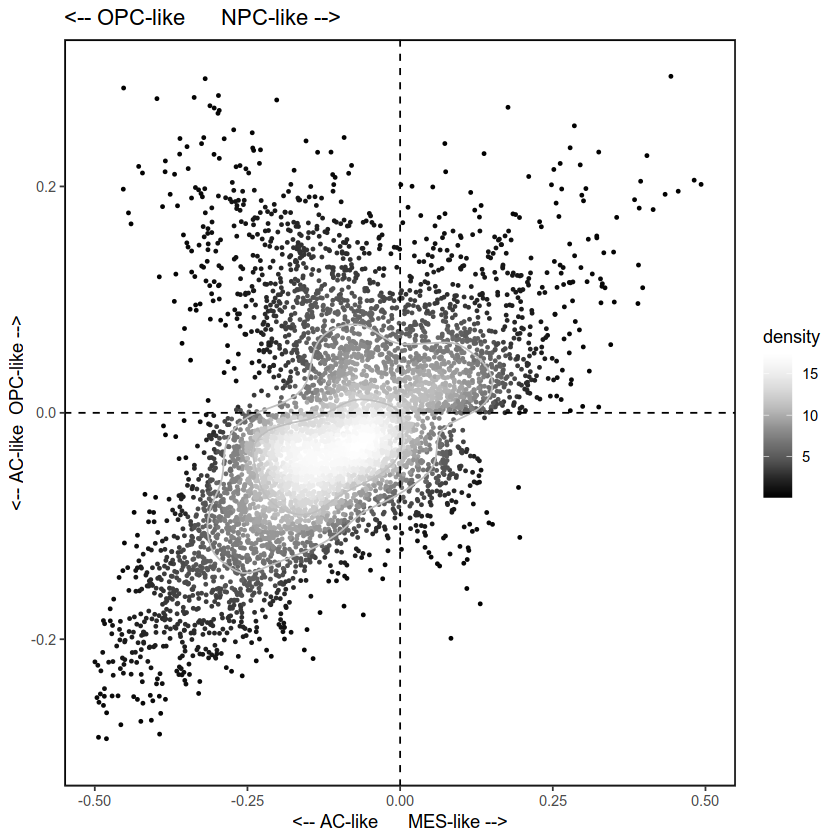

In [211]:
library(RColorBrewer)
core_meta$density <- get_density(core_meta$X.axis_Class, core_meta$Y.axis, n = 100)

core_meta<-as.data.frame(core_meta)
#core_meta$X.axis_Class <- factor(core_meta$X.axis_Class)

d <- ggplot(core_meta, aes(x = X.axis_Class, y = Y.axis, color = density)) +
geom_point(aes(X.axis_Class, Y.axis, color = density), alpha = 1, size = 0.7) + geom_density_2d(bins = 3, color = "grey")+scale_colour_gradientn(colours = rev(colorRampPalette(brewer.pal(11,"Greys"))(31))) +
xlab("<-- AC-like      MES-like -->") +
ylab("<-- AC-like  OPC-like -->") + 
geom_vline(xintercept = 0, lty = 2, col = "black") + 
geom_hline(yintercept = 0, lty = 2, col = "black") + 
ggtitle("<-- OPC-like      NPC-like -->")  +
 theme_bw() +
  theme(panel.grid.major = element_blank(), 
        panel.grid.minor = element_blank(),
        panel.background = element_rect(colour = "black", size=1))+ylim(-0.3,0.3)+xlim(-0.5,0.5)
d

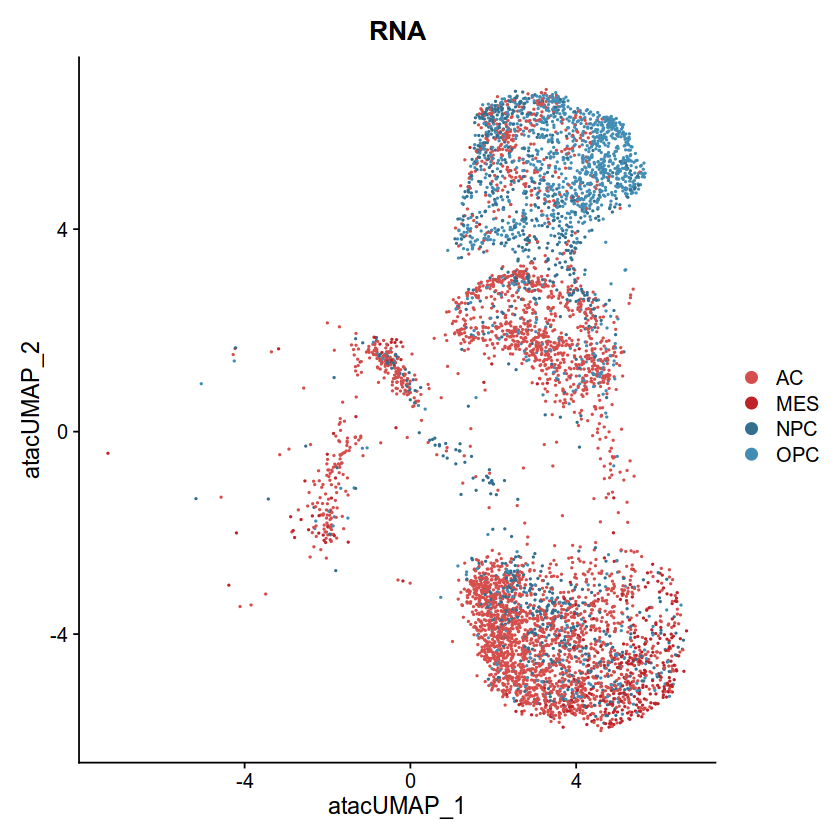

In [212]:
core_meta2<-data.frame(meta=core_meta$MaxClass)
rownames(core_meta2)<-rownames(core_meta)
subset_seurat <- AddMetaData(subset_seurat, metadata = core_meta2)

col<-c("#CA0020","#F4A582","#92C5DE","#0571B0")
col<-c("#F4A582","#CA0020","#0571B0","#92C5DE")
col<-c("#D64E4C","#BD2329","#33708F","#428DB4")

DimPlot(subset_seurat, reduction = "umap", group.by = "meta",cols = col ) + ggtitle("RNA")


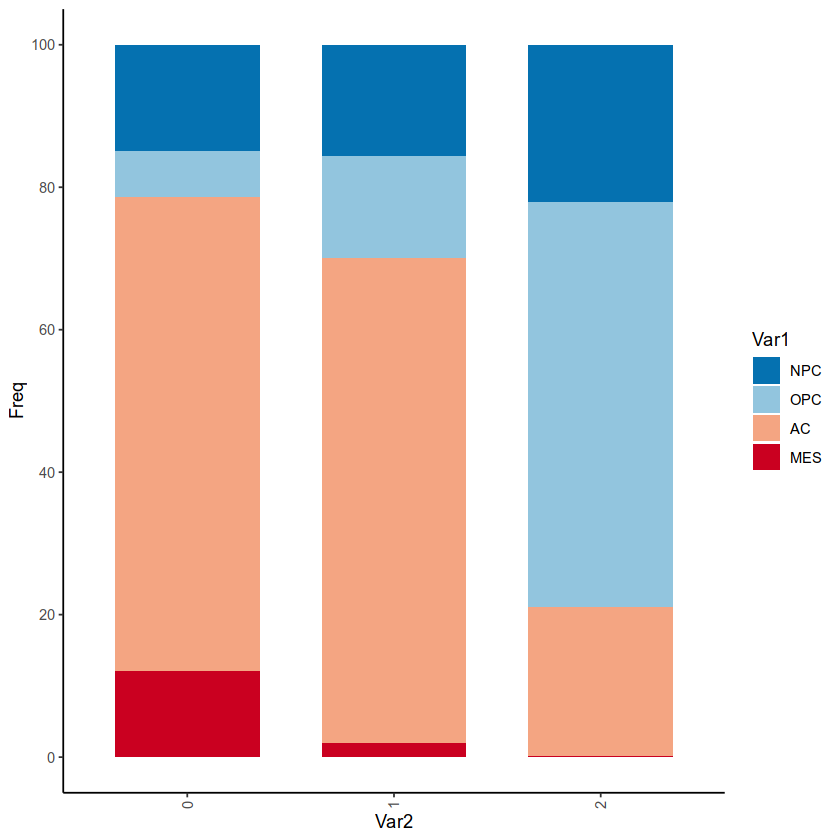

In [213]:
common<-table(core_meta$MaxClass,core_meta$peaks_snn_res.0.3)
new<-t(t(common)/colSums(common))
new2<-data.frame(new)
new2$Freq <- new2$Freq*100
new2$Var1<-factor(new2$Var1,levels=c("NPC","OPC","AC","MES"))
col<-c("#CA0020","#F4A582","#92C5DE","#0571B0")
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=c("#0571B0","#92C5DE","#F4A582","#CA0020"))+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))+scale_y_continuous(breaks = round(seq(0, 100, by = 20),1))

In [214]:
pdf("subclusters.meta.modules.core.pdf")
col<-c("#CA0020","#F4A582","#92C5DE","#0571B0")
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=c("#0571B0","#92C5DE","#F4A582","#CA0020"))+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))+scale_y_continuous(breaks = round(seq(0, 100, by = 20),1))
dev.off()

png 
  2

In [215]:
save(subset_seurat,file="core_cells.rdata")

Warning message:
"Could not find NT5E in the default search locations, found in RNA assay instead"
Warning message:
"Could not find NT5E in the default search locations, found in RNA assay instead"


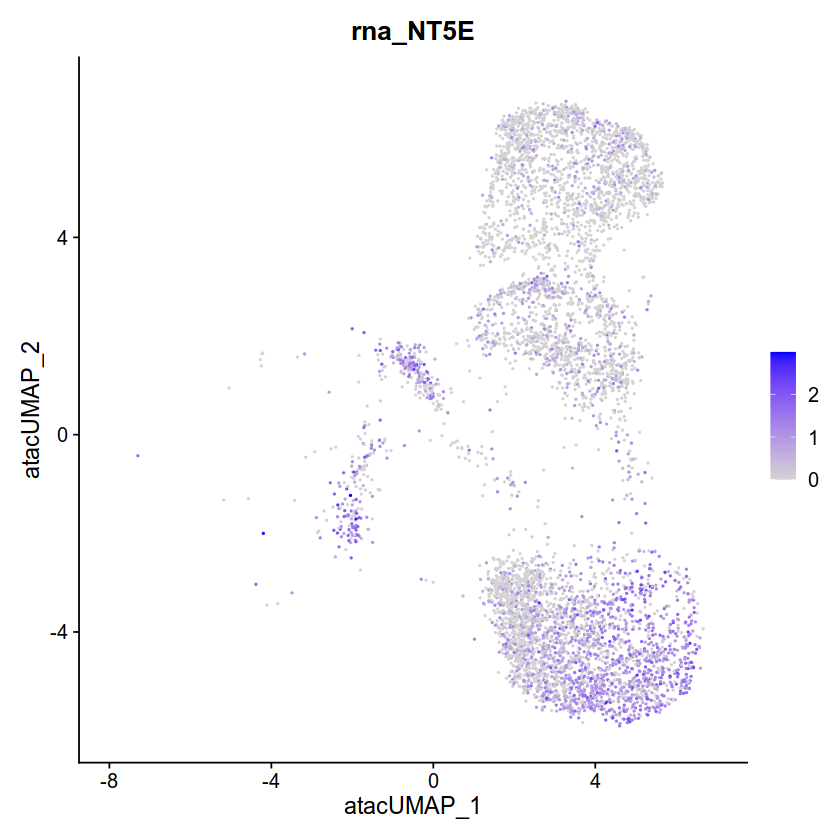

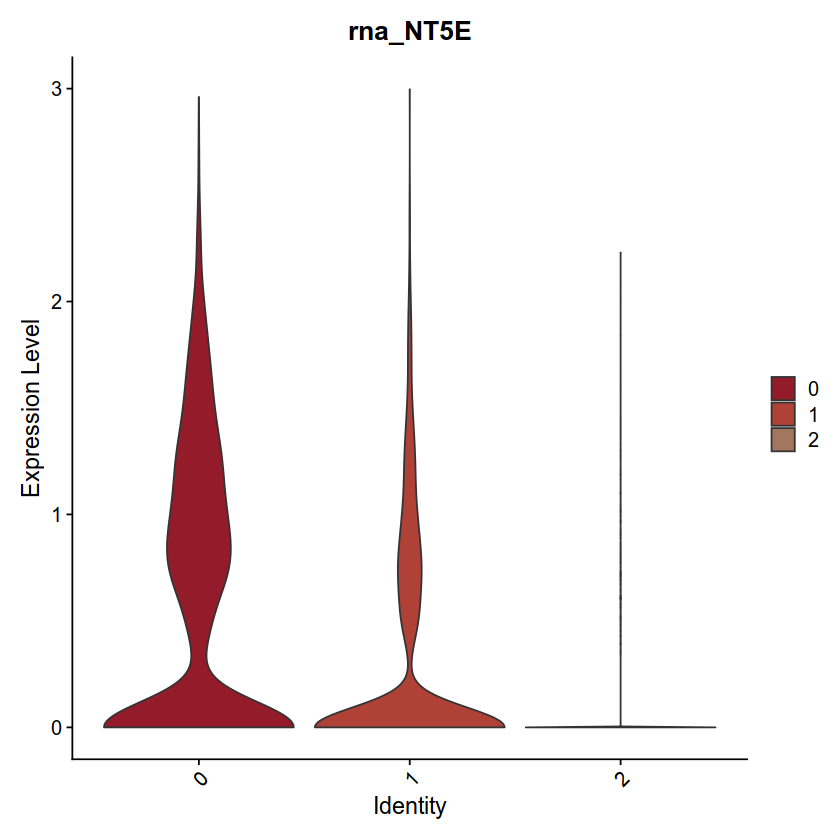

In [216]:
FeaturePlot(subset_seurat, features = 'NT5E',reduction="umap")
VlnPlot(subset_seurat, features = "NT5E",group.by = "peaks_snn_res.0.3",pt.size=0,cols = c("#941B2A","#AF4137","#A37660"))

Warning message:
"Could not find OSMR in the default search locations, found in RNA assay instead"
Warning message:
"Could not find OSMR in the default search locations, found in RNA assay instead"


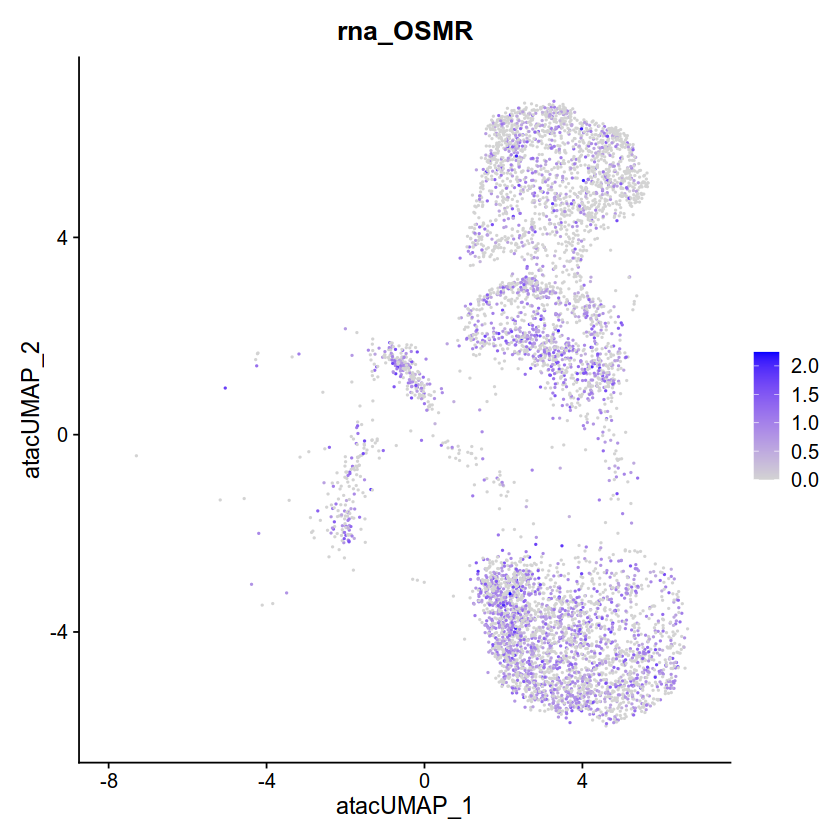

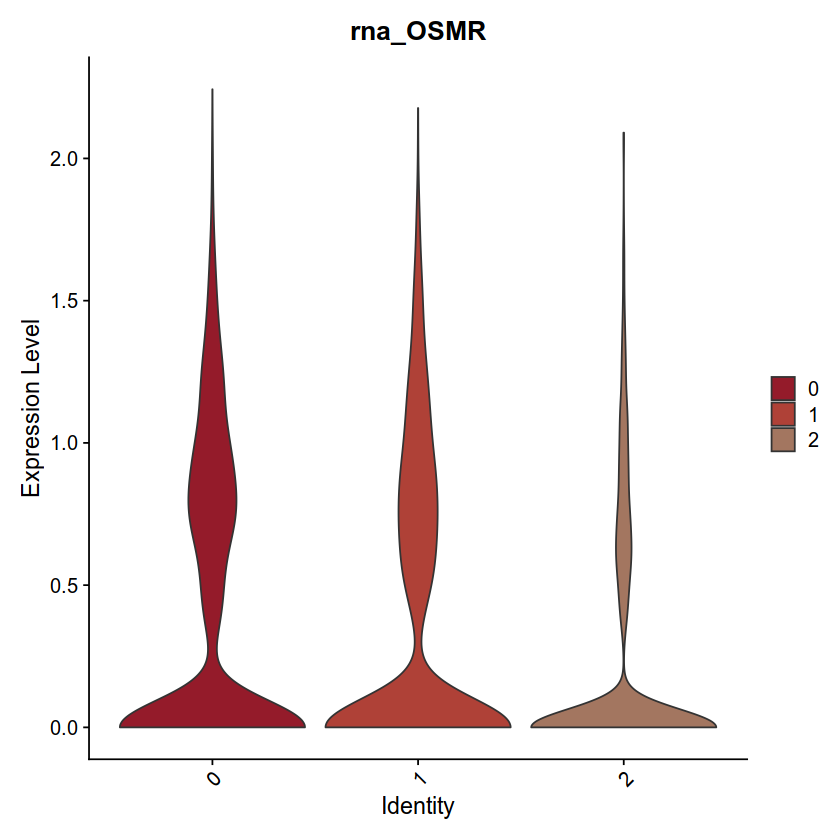

In [217]:
FeaturePlot(subset_seurat, features = 'OSMR',reduction="umap")
VlnPlot(subset_seurat, features = "OSMR",group.by = "peaks_snn_res.0.3",pt.size=0,cols = c("#941B2A","#AF4137","#A37660"))

Warning message:
"Could not find NF1 in the default search locations, found in RNA assay instead"
Warning message:
"Could not find NF1 in the default search locations, found in RNA assay instead"


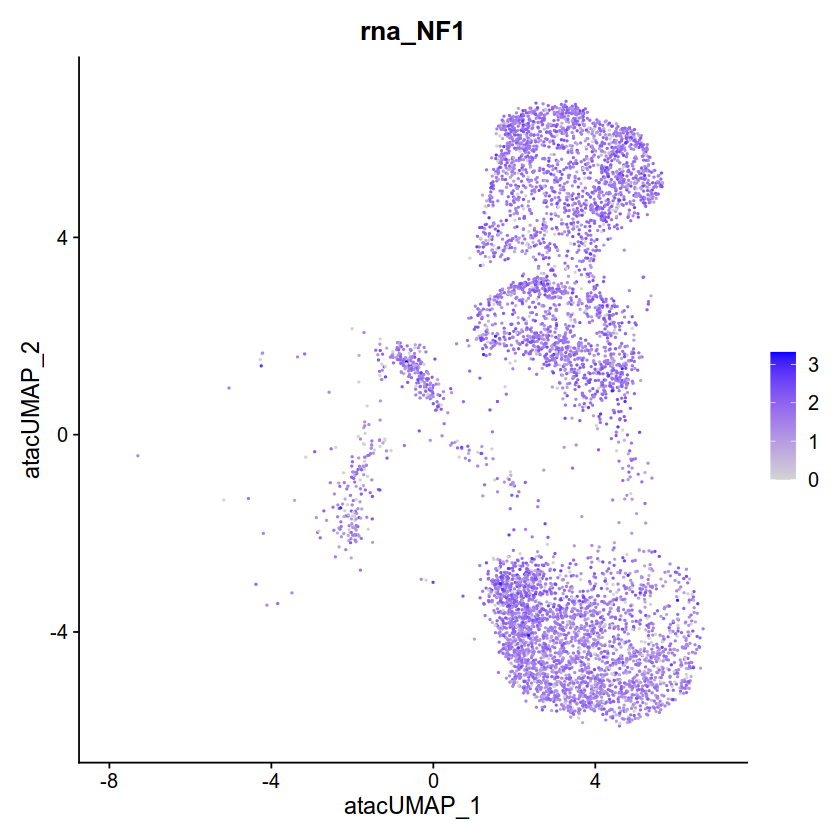

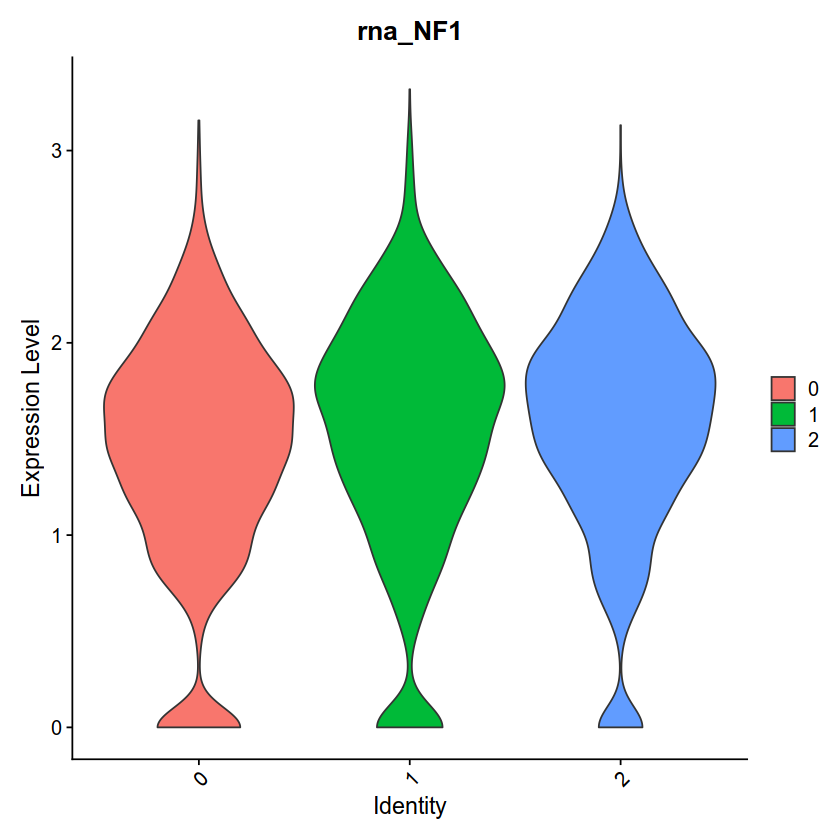

In [218]:
FeaturePlot(subset_seurat, features = 'NF1',reduction="umap")
VlnPlot(subset_seurat, features = "NF1",group.by = "peaks_snn_res.0.3",pt.size=0)

Warning message:
"Could not find NF1 in the default search locations, found in RNA assay instead"


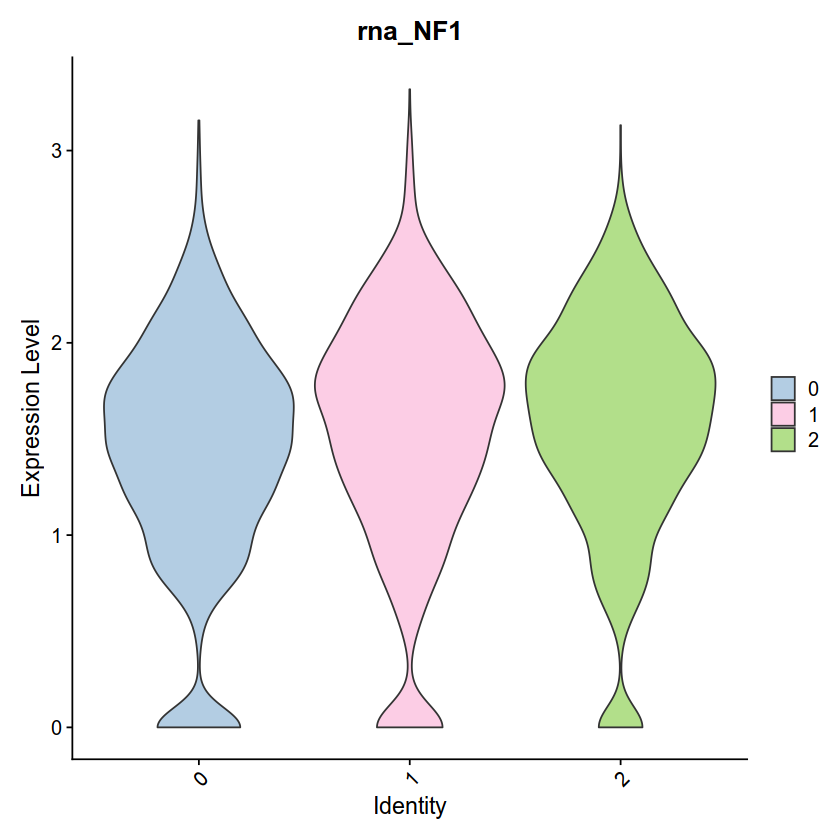

In [348]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
VlnPlot(subset_seurat, features = "NF1",group.by = "peaks_snn_res.0.3",cols=col,pt.size=0)

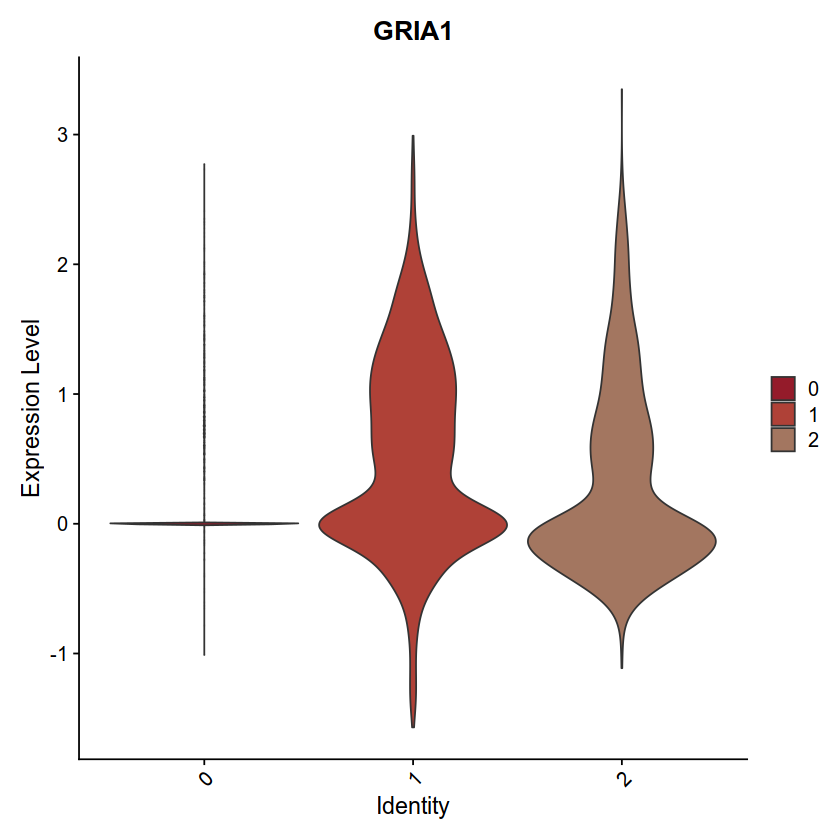

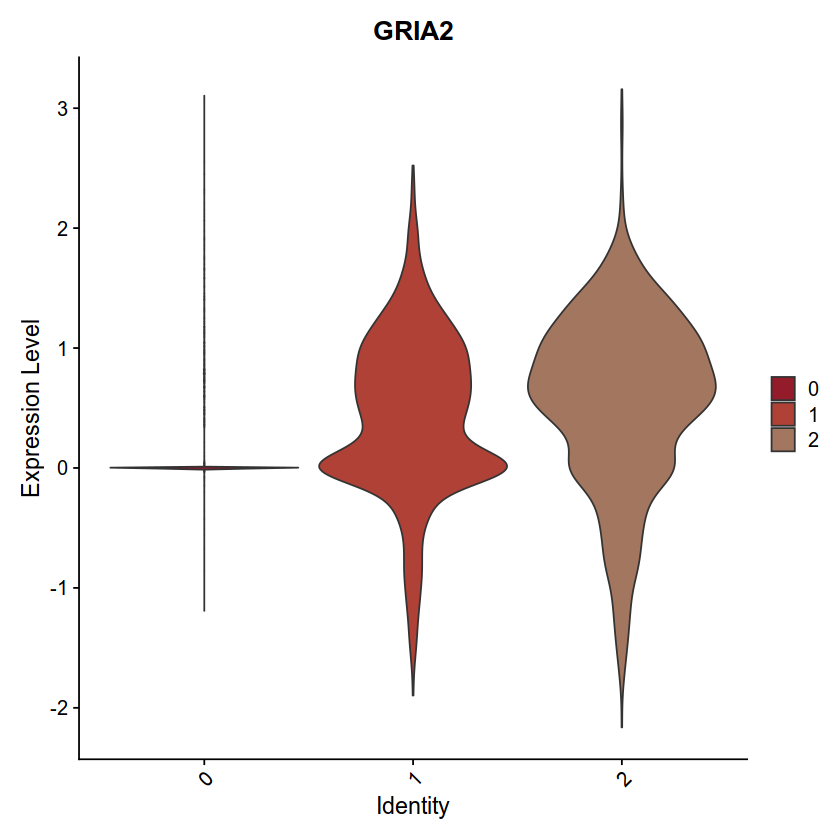

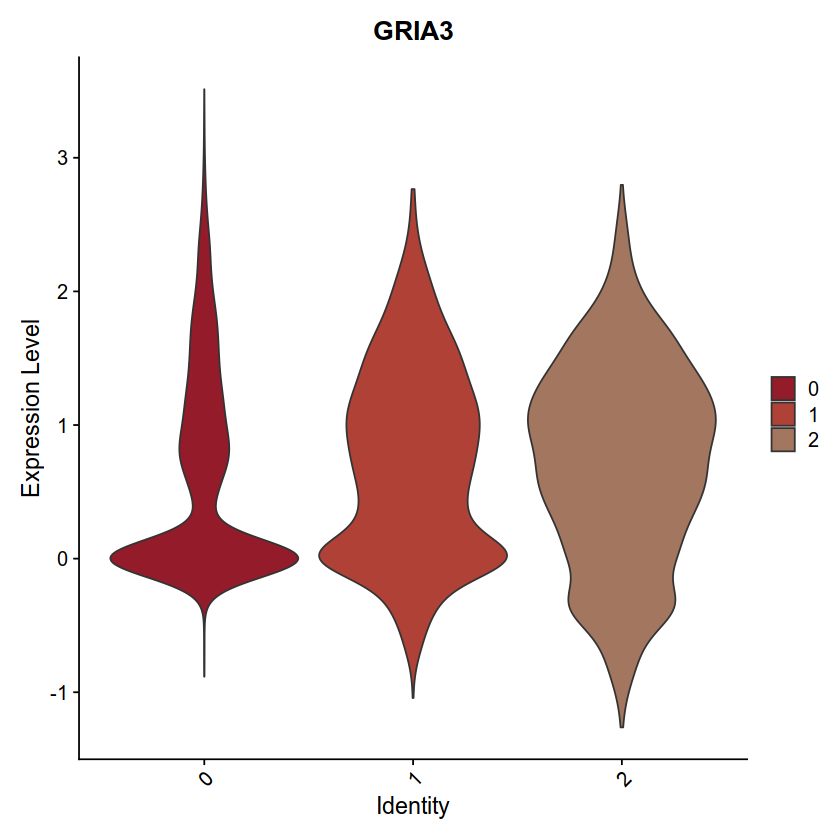

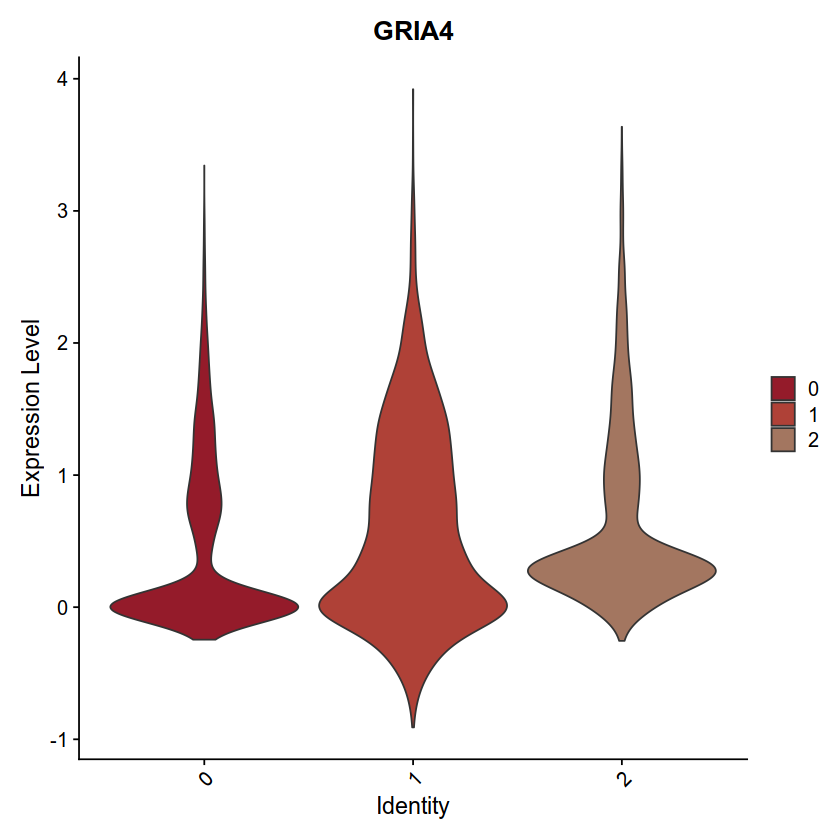

In [362]:
cols <- c("#941B2A","#AF4137","#A37660")
VlnPlot(subset_seurat, features ="GRIA1",group.by = "peaks_snn_res.0.3",cols=cols,pt.size=0)
VlnPlot(subset_seurat, features ="GRIA2",group.by = "peaks_snn_res.0.3",cols=cols,pt.size=0)
VlnPlot(subset_seurat, features ="GRIA3",group.by = "peaks_snn_res.0.3",cols=cols,pt.size=0)
VlnPlot(subset_seurat, features ="GRIA4",group.by = "peaks_snn_res.0.3",cols=cols,pt.size=0)

Warning message:
"Could not find NLGN3 in the default search locations, found in RNA assay instead"


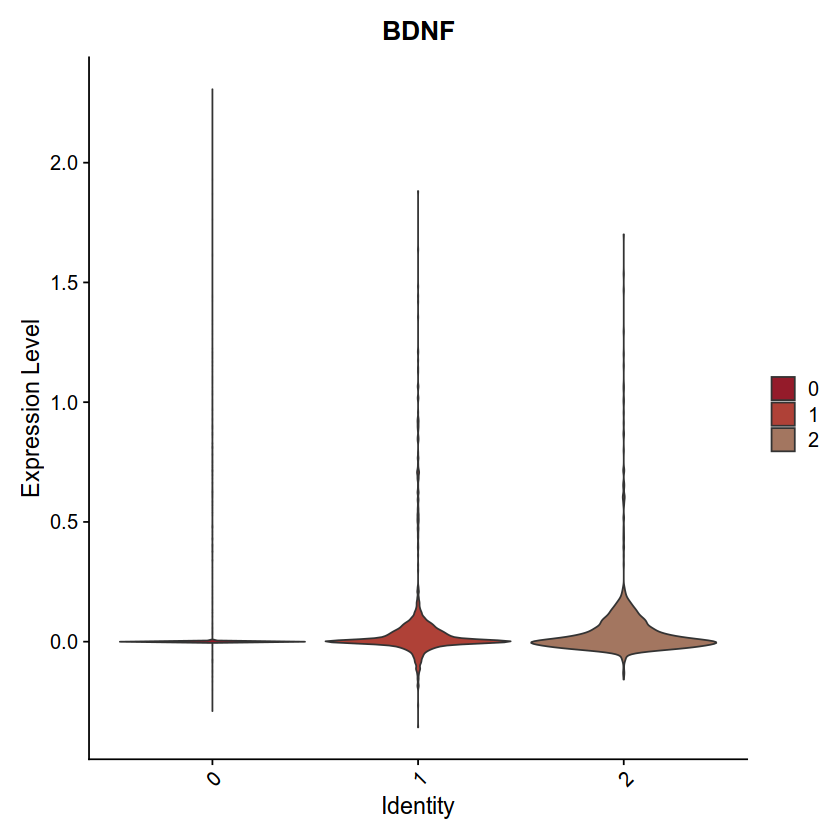

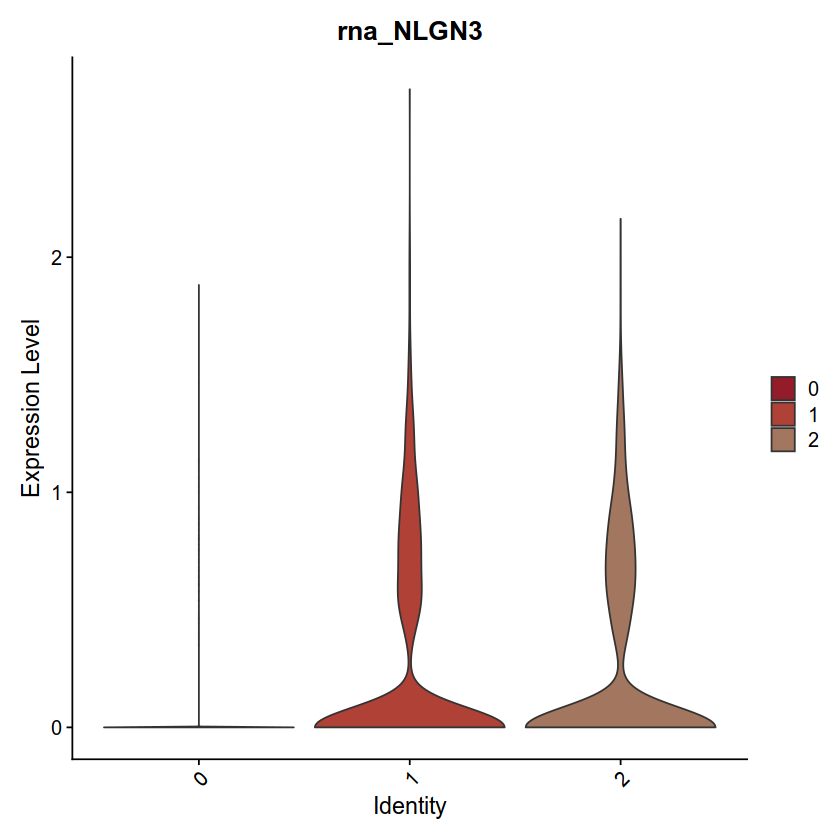

Warning message:
"Could not find SYN1 in the default search locations, found in RNA assay instead"


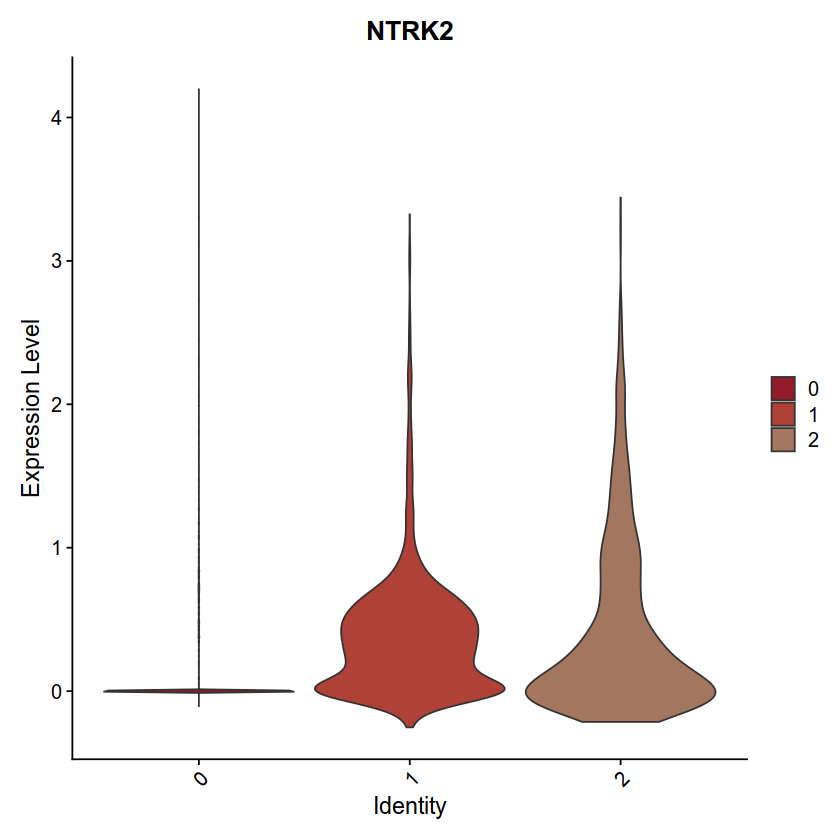

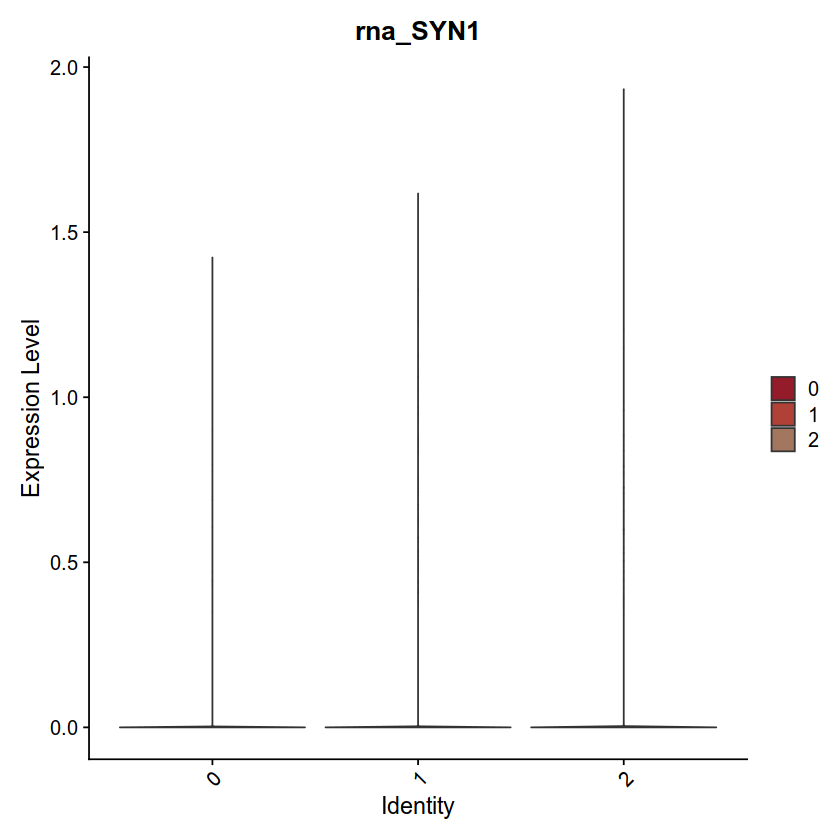

In [363]:
VlnPlot(subset_seurat, features ="BDNF",group.by = "peaks_snn_res.0.3",cols=cols,pt.size=0)
VlnPlot(subset_seurat, features ="NLGN3",group.by = "peaks_snn_res.0.3",cols=cols,pt.size=0)
VlnPlot(subset_seurat, features ="NTRK2",group.by = "peaks_snn_res.0.3",cols=cols,pt.size=0)
VlnPlot(subset_seurat, features ="SYN1",group.by = "peaks_snn_res.0.3",cols=cols,pt.size=0)

In [359]:
VlnPlot(subset_seurat, features ="HTTY1",group.by = "peaks_snn_res.0.3",pt.size=0)

ERROR: Error in FetchData.Seurat(object = object, vars = features, slot = slot): None of the requested variables were found: HTTY1


In [220]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
markers_rna <- presto:::wilcoxauc.Seurat(X = subset_seurat, group_by = 'CCA_RNA_snn_res.0.2', assay = 'data', seurat_assay = 'CCA_RNA')
DefaultAssay(subset_seurat) <- "peaks"
markers_motifs <- presto:::wilcoxauc.Seurat(X = subset_seurat, group_by = 'peaks_snn_res.0.3', assay = 'data', seurat_assay = 'chromvar')
motif.names <- markers_motifs$feature
colnames(markers_rna) <- paste0("RNA.", colnames(markers_rna))
colnames(markers_motifs) <- paste0("motif.", colnames(markers_motifs))
markers_rna$gene <- markers_rna$RNA.feature
markers_motifs$gene <- ConvertMotifID(subset_seurat, id = motif.names)

In [221]:
DefaultAssay(subset_seurat) <- "peaks"

markers_chromatin <- presto:::wilcoxauc.Seurat(X = subset_seurat, group_by = 'peaks_snn_res.0.3', assay = 'data', seurat_assay = 'peaks')


In [222]:
topTFs_chromatin <- function(peaks_snn_res.0.3, padj.cutoff = 0.05) {
  ctmarkers_chromatin <- dplyr::filter(
    markers_chromatin, group == peaks_snn_res.0.3, padj < 0.05, logFC > 0.3,auc > 0.5) 
    top_tfs <- ctmarkers_chromatin
  return(top_tfs)
}

In [223]:
tf1_chromatin<-topTFs_chromatin("0")
tf2_chromatin<-topTFs_chromatin("1")
tf3_chromatin<-topTFs_chromatin("2")

tf_chromatin<-rbind(tf1_chromatin,tf2_chromatin,tf3_chromatin)


In [224]:
library(TxDb.Hsapiens.UCSC.hg38.knownGene)
library(clusterProfiler)
library(ChIPseeker)
library(org.Hs.eg.db)
library(annotate)

>> preparing features information...		 2023-11-10 07:34:20 AM 
>> identifying nearest features...		 2023-11-10 07:34:20 AM 
>> calculating distance from peak to TSS...	 2023-11-10 07:34:21 AM 
>> assigning genomic annotation...		 2023-11-10 07:34:21 AM 
>> assigning chromosome lengths			 2023-11-10 07:34:29 AM 
>> done...					 2023-11-10 07:34:29 AM 


765          60672      105376744         200197          23400 
         "CA6"         "MIIP"    "LINC02766"   "TMEM51-AS1"      "ATP13A2" 
        127731           1889           1307          81493           8565 
      "VWA5B1"         "ECE1"      "COL16A1"         "SYNC"        "YARS1" 
        113451         114784          84970          27095         440584 
       "AZIN2"        "CSMD2"      "C1orf94"      "TRAPPC3"    "SLC2A1-DT" 
          4352      102464830      107984951          55182          26828 
         "MPL"      "MIR6079"             NA       "RNF220"      "RNU5F-1" 
        126661           6512          63948      101926925          55277 
     "CCDC163"       "SLC1A7"       "DMRTB1"    "LINC01358"         "FGGY" 
         10207         127254         204962           3491      107985519 
        "PATJ"       "ERICH3"      "SLC44A5"         "CCN1"    "LINC01773" 
          7049             24             24           9411           9890 
      "TGFBR3"        "ABCA4"        "ABCA4"     "ARHGAP29"       "PLPPR4" 
          1301           5906          56944          56944         148281 
     "COL11A1"        "RAP1A"       "OLFML3"       "OLFML3"         "SYT6" 
         10100          81839          81839            914           6913 
      "TSPAN2"       "VANGL1"       "VANGL1"          "CD2"        "TBX15" 
          6063           5174         148741          57863           9447 
    "RNVU1-2A"        "PDZK1"      "ANKRD35"        "CADM3"         "AIM2" 
        391123          25903           4009           4009            356 
       "VSIG8"      "OLFML2B"        "LMX1A"        "LMX1A"        "FASLG" 
         57795          55103           9917         400799          23418 
      "BRINP2"      "RALGPS2"       "FAM20B"    "LINC01344"         "CRB1" 
           493          55224         148808      105372894      105372894 
      "ATP2B4"        "ETNK2"       "MFSD4A"    "LINC01774"    "LINC01774" 
         55733      100874296           7188      102723761           5784 
        "HHAT"    "KCNH1-IT1"        "TRAF5"    "LINC02773"       "PTPN14" 
          3776           2104         643136          79802      101927504 
       "KCNK2"        "ESRRG"      "ZC3H11B"       "HHIPL2"    "LINC01682" 
     101927851           1130         200150          55083      105373265 
      "LNCATV"         "LYST"         "PLD5"       "KIF26B" "LOC105373265" 
         64754          64754          64754         149134      102723730 
       "SMYD3"        "SMYD3"        "SMYD3"    "LINC01341" "LOC102723730" 
          7837           7837      107985839      101929551         339789 
        "PXDN"         "PXDN" "LOC107985839" "LOC101929551"    "LINC00299" 
        339789      105373414      105373416           6241      100506457 
   "LINC00299" "LOC105373414" "LOC105373416"         "RRM2"    "MIR3681HG" 
          1653           7447      105373460      105373461      105374325 
        "DDX1"        "VSNL1"    "LINC01808" "LOC105373461" "LOC105374325" 
     105374329           4358          22950           9553         151056 
"LOC105374329"        "MPV17"     "SLC4A1AP"       "MRPL33"         "PLB1" 
        151056      100616136          25797          25797          25797 
        "PLB1"      "MIR4430"         "QPCT"         "QPCT"         "QPCT" 
         10602         151393          63892           5495          90411 
    "CDC42EP3"        "RMDN2"        "THADA"        "PPM1B"        "MCFD2" 
         11036      101927577            119          27332          94097 
     "GTF2A1L"    "LINC01797"         "ADD2"       "ZNF638"        "SFXN5" 
         94097             72             72          84141            822 
       "SFXN5"        "ACTG2"        "ACTG2"        "EVA1A"         "CAPG" 
         65055      105374852      101927070         343990      101927383 
       "REEP1" "LOC105374852"    "LINC02611"       "CRACDL" "LOC101927383" 
          2274           3987      100287216          55289

#
# over-representation test
#
#...@organism 	 hsa 
#...@ontology 	 KEGG 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:1077] "765" "60672" "105376744" "200197" "23400" "127731" "1889" ...
#...pvalues adjusted by 'BH' with cutoff <0.05 
#...4 enriched terms found
'data.frame':	4 obs. of  9 variables:
 $ ID         : chr  "hsa04360" "hsa04510" "hsa05205" "hsa04750"
 $ Description: chr  "Axon guidance" "Focal adhesion" "Proteoglycans in cancer" "Inflammatory mediator regulation of TRP channels"
 $ GeneRatio  : chr  "18/333" "19/333" "19/333" "12/333"
 $ BgRatio    : chr  "182/8622" "203/8622" "205/8622" "98/8622"
 $ pvalue     : num  0.000226 0.00031 0.000352 0.00037
 $ p.adjust   : num  0.0274 0.0274 0.0274 0.0274
 $ qvalue     : num  0.0257 0.0257 0.0257 0.0257
 $ geneID     : chr  "CXCR4/GNAI2/BOC/CAMK2D/PIK3R1/EPHA7/SEMA3C/SEMA3E/SEMA3D/MET/PTK2/PPP3R2/LRRC4C/SRGAP1/TRPC4/MYL12A/DCC/LIMK2" "RAP1A/FN1/FLNB/ITGB5/PDGFRA/KDR/MAPK10/PIK3R1/MYL7/MET/FLNC/PTK2/TNC/VAV2/COL4A2/ITGB3/MYL12A/AC

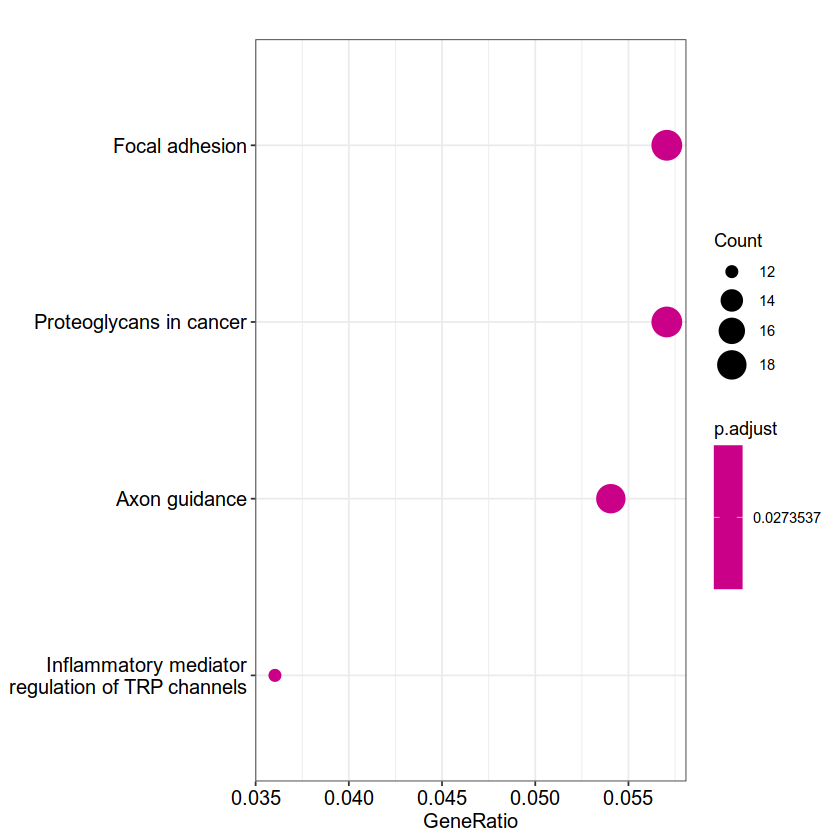

In [225]:
split1<-strsplit(tf1_chromatin$feature,split = "-")
split1<-t(data.frame(split1))
split2<-data.frame(split1[,1],as.numeric(split1[,2]),as.numeric(split1[,3]))
input<-split2
cluster2_anno<-data.frame(seqnames=input[,1],start=input[,2],end=input[,3],width=input[,3]-input[,2],strand=rep("*",length(input[,2])))
rownames(cluster2_anno)<-paste(input[,1],input[,2],input[,3],sep="_")
cluster_c<-cluster2_anno
cluster_c_g<-makeGRangesFromDataFrame(cluster_c, keep.extra.columns = TRUE)
anno_LiverMinusHindbrain <- annotatePeak(cluster_c_g,TxDb = TxDb.Hsapiens.UCSC.hg38.knownGene)
anno_LiverMinusHindbrain_GRanges <- as.GRanges(anno_LiverMinusHindbrain)
a<-getSYMBOL(anno_LiverMinusHindbrain_GRanges$geneId, data='org.Hs.eg')
anno_LiverMinusHindbrain_GRanges$genes<-a
b<-anno_LiverMinusHindbrain_GRanges[which(anno_LiverMinusHindbrain_GRanges$distanceToTSS < 100000 & anno_LiverMinusHindbrain_GRanges$distanceToTSS > -100000),]
b$genes
kk2<-enrichKEGG(b$geneId,organism='hsa', pvalueCutoff = 0.05)
kk3<-setReadable(kk2,OrgDb = org.Hs.eg.db,keyType = "ENTREZID")
kk4 <- setReadable(kk2, 'org.Hs.eg.db', 'ENTREZID')
kk4
dotplot(kk4, showCategory=20)

In [226]:
split1<-strsplit(tf2_chromatin$feature,split = "-")
split1<-t(data.frame(split1))
split2<-data.frame(split1[,1],as.numeric(split1[,2]),as.numeric(split1[,3]))
input<-split2
cluster2_anno<-data.frame(seqnames=input[,1],start=input[,2],end=input[,3],width=input[,3]-input[,2],strand=rep("*",length(input[,2])))
rownames(cluster2_anno)<-paste(input[,1],input[,2],input[,3],sep="_")
cluster_c<-cluster2_anno
cluster_c_g<-makeGRangesFromDataFrame(cluster_c, keep.extra.columns = TRUE)
anno_LiverMinusHindbrain <- annotatePeak(cluster_c_g,TxDb = TxDb.Hsapiens.UCSC.hg38.knownGene)
anno_LiverMinusHindbrain_GRanges <- as.GRanges(anno_LiverMinusHindbrain)
a<-getSYMBOL(anno_LiverMinusHindbrain_GRanges$geneId, data='org.Hs.eg')
anno_LiverMinusHindbrain_GRanges$genes<-a
b<-anno_LiverMinusHindbrain_GRanges[which(anno_LiverMinusHindbrain_GRanges$distanceToTSS < 100000 & anno_LiverMinusHindbrain_GRanges$distanceToTSS > -100000),]
b$genes
kk2<-enrichKEGG(b$geneId,organism='hsa', pvalueCutoff = 0.05)
kk3<-setReadable(kk2,OrgDb = org.Hs.eg.db,keyType = "ENTREZID")
kk4 <- setReadable(kk2, 'org.Hs.eg.db', 'ENTREZID')
kk4
dotplot(kk4, showCategory=20)

>> preparing features information...		 2023-11-10 07:34:30 AM 
>> identifying nearest features...		 2023-11-10 07:34:30 AM 
>> calculating distance from peak to TSS...	 2023-11-10 07:34:30 AM 
>> assigning genomic annotation...		 2023-11-10 07:34:30 AM 
>> assigning chromosome lengths			 2023-11-10 07:34:35 AM 
>> done...					 2023-11-10 07:34:35 AM 


285941      203062      286467 
"LINC02860"   "TSNARE1"     "FIRRE"

--> No gene can be mapped....

--> Expected input gene ID: 1737,23729,25796,2762,2271,6120

--> return NULL...



ERROR: Error in setReadable(kk2, OrgDb = org.Hs.eg.db, keyType = "ENTREZID"): input should be an 'enrichResult' , 'gseaResult' or 'compareClusterResult' object...


>> preparing features information...		 2023-12-01 06:27:06 AM 
>> identifying nearest features...		 2023-12-01 06:27:06 AM 
>> calculating distance from peak to TSS...	 2023-12-01 06:27:07 AM 
>> assigning genomic annotation...		 2023-12-01 06:27:07 AM 
>> assigning chromosome lengths			 2023-12-01 06:27:12 AM 
>> done...					 2023-12-01 06:27:12 AM 


102465909                    116983                      2563 
              "MIR6859-2"                   "ACAP3"                   "GABRD" 
                     5590                      5590                      6497 
                  "PRKCZ"                   "PRKCZ"                     "SKI" 
                     9651                 100287898                    140625 
                  "PLCH2"                   "TTC34"                  "ACTRT2" 
                   140625                 100422968                     63976 
                 "ACTRT2"                 "MIR4251"                  "PRDM16" 
                    63976                 105378604                 105378604 
                 "PRDM16"            "LOC105378604"            "LOC105378604" 
                    63976                     27237                     27237 
                 "PRDM16"                "ARHGEF16"                "ARHGEF16" 
                   693135                      1953                     49856 
                "MIR551A"                   "MEGF6"                  "WRAP73" 
                105376686                 105376686                     11332 
           "LOC105376686"            "LOC105376686"                   "ACOT7" 
                    80176                     80176                     80176 
                  "SPSB1"                   "SPSB1"                   "SPSB1" 
                    54897                      2475                 105376737 
                  "CASZ1"                    "MTOR"            "LOC105376737" 
                    57540                 112268221                      4879 
                  "DISP3"                        NA                    "NPPB" 
                    84966                     84966                     84966 
                 "IGSF21"                  "IGSF21"                  "IGSF21" 
                     5081                      5081                       832 
                   "PAX7"                    "PAX7"                   "CAPZB" 
                    30814                      5320                      5322 
                "PLA2G2E"                 "PLA2G2A"                  "PLA2G5" 
                    26279                 105376827                    163933 
                "PLA2G2D"               "LINC01757"                  "FAM43B" 
                    57576                      5909                       998 
                  "KIF17"                 "RAP1GAP"                   "CDC42" 
                     2048                     55616                 107984928 
                  "EPHB2"                   "ASAP3"            "LOC107984928" 
                    26119                     57134                      2134 
                "LDLRAP1"                  "MAN1C1"                   "EXTL1" 
                     6195                      6548                      4985 
                "RPS6KA1"                  "SLC9A1"                   "OPRD1" 
                    10076                     10076                      7805 
                  "PTPRU"                   "PTPRU"                  "LAPTM5" 
                     9672                     79570                     79570 
                   "SDC3"                  "NKAIN1"                  "NKAIN1" 
                    10657                    149076                      1912 
                "KHDRBS1"                  "ZNF362"                    "PHC2" 
                   402779                    402779                 105378641 
              "CSMD2-AS1"               "CSMD2-AS1"            "LOC105378641" 
                   127703                     54936                     83931 
               "C1orf216"                   "ADPRS"                   "STK40" 
                     1441                      2899                      2899 
                  "CSF3R"                   "GRIK3"                   "GRIK3" 
                     2899                      2899               

#
# over-representation test
#
#...@organism 	 hsa 
#...@ontology 	 KEGG 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:1559] "102465909" "116983" "2563" "5590" "6497" "9651" "100287898" ...
#...pvalues adjusted by 'BH' with cutoff <0.05 
#...39 enriched terms found
'data.frame':	39 obs. of  9 variables:
 $ ID         : chr  "hsa04360" "hsa04015" "hsa04020" "hsa04014" ...
 $ Description: chr  "Axon guidance" "Rap1 signaling pathway" "Calcium signaling pathway" "Ras signaling pathway" ...
 $ GeneRatio  : chr  "27/470" "28/470" "31/470" "29/470" ...
 $ BgRatio    : chr  "182/8622" "210/8622" "253/8622" "236/8622" ...
 $ pvalue     : num  1.72e-06 9.25e-06 1.76e-05 3.11e-05 4.51e-05 ...
 $ p.adjust   : num  0.000532 0.001429 0.001808 0.002402 0.002787 ...
 $ qvalue     : num  0.000428 0.001149 0.001454 0.001931 0.002241 ...
 $ geneID     : chr  "PRKCZ/CDC42/EPHB2/PLXNA2/BMPR2/ROBO2/EPHB1/PIK3CB/EPHB3/UNC5C/EFNA5/SEMA6A/CAMK2A/UNC5A/CAMK2B/SEMA3A/PTK2/SEMA"| __truncated__ "PRKCZ/RAP1GAP/CDC4

png 
  2

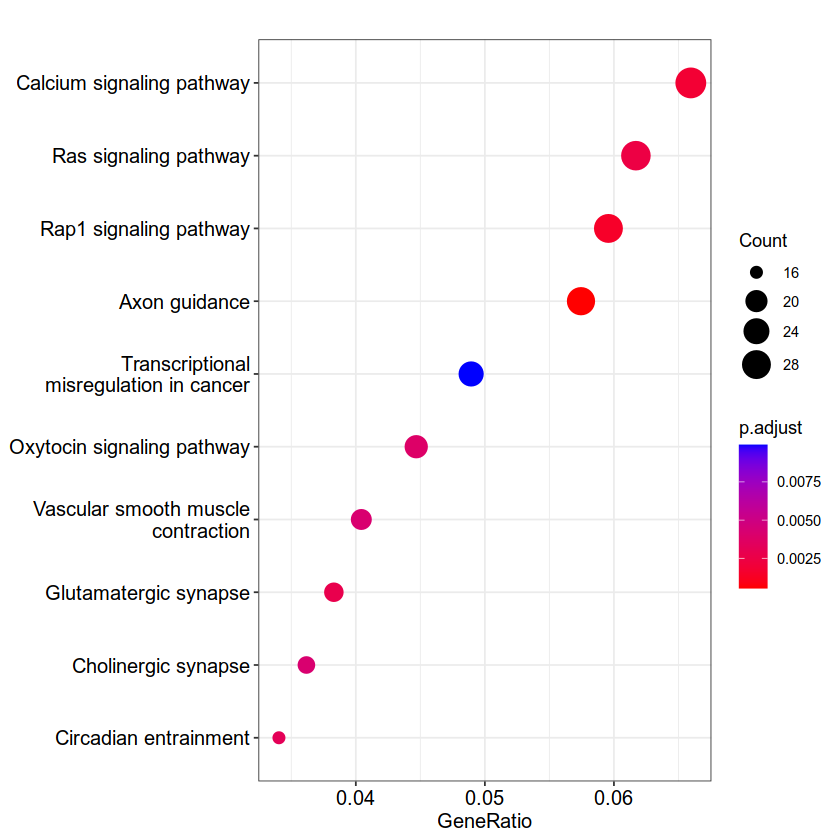

In [229]:
split1<-strsplit(tf3_chromatin$feature,split = "-")
split1<-t(data.frame(split1))
split2<-data.frame(split1[,1],as.numeric(split1[,2]),as.numeric(split1[,3]))
input<-split2
cluster2_anno<-data.frame(seqnames=input[,1],start=input[,2],end=input[,3],width=input[,3]-input[,2],strand=rep("*",length(input[,2])))
rownames(cluster2_anno)<-paste(input[,1],input[,2],input[,3],sep="_")
cluster_c<-cluster2_anno
cluster_c_g<-makeGRangesFromDataFrame(cluster_c, keep.extra.columns = TRUE)
anno_LiverMinusHindbrain <- annotatePeak(cluster_c_g,TxDb = TxDb.Hsapiens.UCSC.hg38.knownGene)
anno_LiverMinusHindbrain_GRanges <- as.GRanges(anno_LiverMinusHindbrain)
a<-getSYMBOL(anno_LiverMinusHindbrain_GRanges$geneId, data='org.Hs.eg')
anno_LiverMinusHindbrain_GRanges$genes<-a
b<-anno_LiverMinusHindbrain_GRanges[which(anno_LiverMinusHindbrain_GRanges$distanceToTSS < 100000 & anno_LiverMinusHindbrain_GRanges$distanceToTSS > -100000),]
b$genes
kk2<-enrichKEGG(b$geneId,organism='hsa', pvalueCutoff = 0.05)
kk3<-setReadable(kk2,OrgDb = org.Hs.eg.db,keyType = "ENTREZID")
kk4 <- setReadable(kk2, 'org.Hs.eg.db', 'ENTREZID')
kk4
dotplot(kk4, showCategory=10)
pdf("core.c3.pathway.pdf")
dotplot(kk4, showCategory=10)
dev.off()


In [230]:
library(TxDb.Hsapiens.UCSC.hg38.knownGene)
library(clusterProfiler)
library(ChIPseeker)
library(org.Hs.eg.db)
library(annotate)


In [231]:
#asstrsplit(tf_chromatin$feature,split = "-")

In [232]:
topTFs <- function(peaks_snn_res.0.3, padj.cutoff = 0.01) {
  ctmarkers_rna <- dplyr::filter(
    markers_rna, RNA.group == peaks_snn_res.0.3, RNA.padj < padj.cutoff, RNA.logFC > 0.1,RNA.auc>0.1 )
#    %>% 
#    arrange(-RNA.auc)
  ctmarkers_motif <- dplyr::filter(
    markers_motifs, motif.group == peaks_snn_res.0.3, motif.padj < padj.cutoff, motif.logFC > 0.1,motif.auc > 0.1) 
#    %>% 
#    arrange(-motif.auc)
  top_tfs <- inner_join(
    x = ctmarkers_rna[, c(2, 11, 6, 7)], 
    y = ctmarkers_motif[, c(2, 1, 11, 6, 7)], by = "gene"
  )
  top_tfs$avg_auc <- (top_tfs$RNA.auc + top_tfs$motif.auc) / 2
  top_tfs <- arrange(top_tfs, -avg_auc)
  return(top_tfs)
}

In [233]:
topTFs_rna <- function(CCA_RNA_snn_res.0.2, padj.cutoff = 0.01) {
  ctmarkers_rna <- dplyr::filter(
    markers_rna, RNA.group == CCA_RNA_snn_res.0.2, RNA.padj < 0.01, RNA.logFC > 0.5,RNA.auc>0.6 ) 
  top_tfs <- ctmarkers_rna
  return(top_tfs)
}

In [234]:
topTFs_motif <- function(peaks_snn_res.0.3, padj.cutoff = 0.01) {
  ctmarkers_motif <- dplyr::filter(
    markers_motifs, motif.group == peaks_snn_res.0.3, motif.padj < padj.cutoff, motif.logFC > 0.5,motif.auc > 0.6) 
  top_tfs <- ctmarkers_motif
  return(top_tfs)
}

In [235]:
tf1_c2<-topTFs("0")
tf2_c2<-topTFs("1")
tf3_c2<-topTFs("2")


tf_c2<-rbind(tf1_c2,tf2_c2,tf3_c2)

In [236]:
tf_c2

RNA.group,gene,RNA.auc,RNA.pval,motif.group,motif.feature,motif.auc,motif.pval,avg_auc
<chr>,<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>
0,NFIA,0.8050463,0.000000e+00,0,MA0670.1,0.6609029,8.054681e-100,0.7329746
0,EBF1,0.7728927,3.552933e-302,0,MA0154.4,0.5347510,4.641059e-06,0.6538218
0,PROX1,0.6538668,4.860210e-94,0,MA0794.1,0.6083205,3.030529e-46,0.6310937
1,MEOX2,0.3999828,5.016382e-41,1,MA0706.1,0.5954621,8.349948e-31,0.4977225
1,HOXB4,0.3762078,4.951055e-63,1,MA1499.1,0.5254929,2.059174e-03,0.4508503


In [237]:
DefaultAssay(glio.int) <- "CCA_RNA"
#DotPlot(object = subset_seurat, features = unique(tf_c2$gene),group.by = "peaks_snn_res.0.1")+coord_flip() 

In [238]:
tf1_rna<-topTFs_rna("0")
tf2_rna<-topTFs_rna("1")
tf3_rna<-topTFs_rna("2")
tf4_rna<-topTFs_rna("3")
tf5_rna<-topTFs_rna("4")

tf_rna<-rbind(tf1_rna,tf2_rna,tf3_rna,tf4_rna,tf5_rna)

In [239]:
tf1_motif<-topTFs_motif("0")
tf2_motif<-topTFs_motif("1")
tf3_motif<-topTFs_motif("2")

tf_motif<-rbind(tf1_motif,tf2_motif,tf3_motif)

In [240]:
#write.table(tf_motif,file="tf.motif.subcluster.without.core.xls ",quote=F,sep="\t",row.names=F)

In [241]:
which(tf_chromatin$group == 1)


[1] 1416 1417 1418 1419

In [242]:
write.table(tf_chromatin,file="chromatin.core.subcluster.xls",quote=F,sep="\t",row.names=F)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


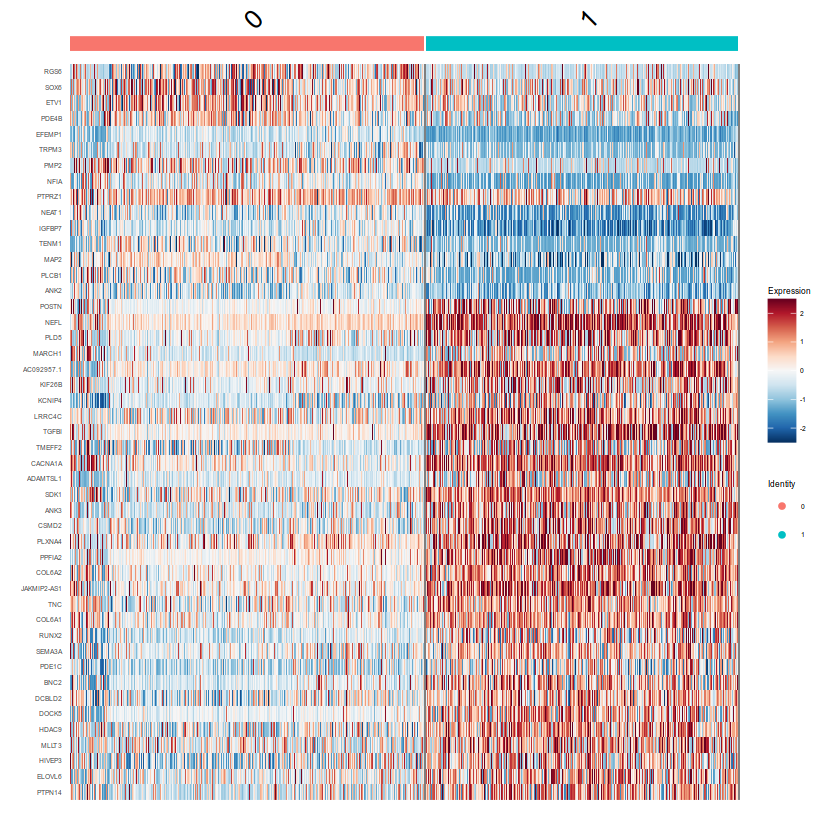

In [243]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
mapal <- colorRampPalette(RColorBrewer::brewer.pal(11,"RdBu"))(256)
#filtered_seurat<-ScaleData(filtered_seurat,features=as.character(unique(top5$gene)),assay="RNA")
DoHeatmap(subset_seurat, features = as.character(tf_rna$RNA.feature), group.by = "CCA_RNA_snn_res.0.2")+scale_fill_gradientn(colours = rev(mapal))+theme(text = element_text(size = 5))

In [244]:
pdf("core.cluster.rna.heatmap.pdf")
mapal <- colorRampPalette(RColorBrewer::brewer.pal(11,"RdBu"))(256)
#filtered_seurat<-ScaleData(filtered_seurat,features=as.character(unique(top5$gene)),assay="RNA")
DoHeatmap(subset_seurat, features = as.character(tf_rna$RNA.feature), group.by = "CCA_RNA_snn_res.0.2")+scale_fill_gradientn(colours = rev(mapal))+theme(text = element_text(size = 5))
dev.off()

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


png 
  2

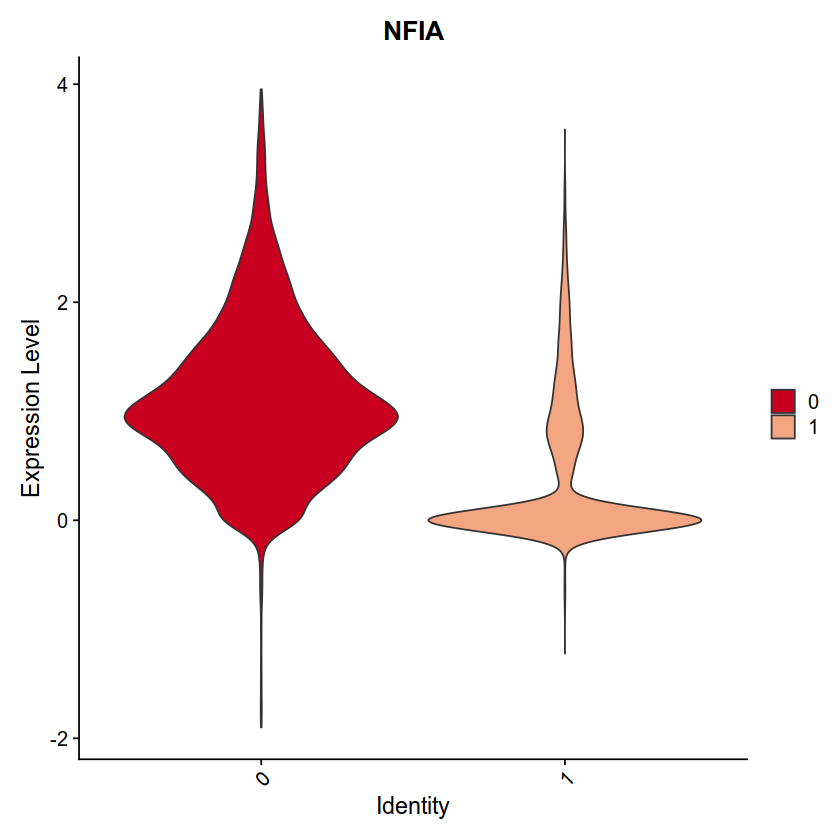

In [245]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
VlnPlot(subset_seurat, features = "NFIA",group.by = "CCA_RNA_snn_res.0.2",cols=col,pt.size=0)

Warning message:
"Could not find OSMR in the default search locations, found in RNA assay instead"


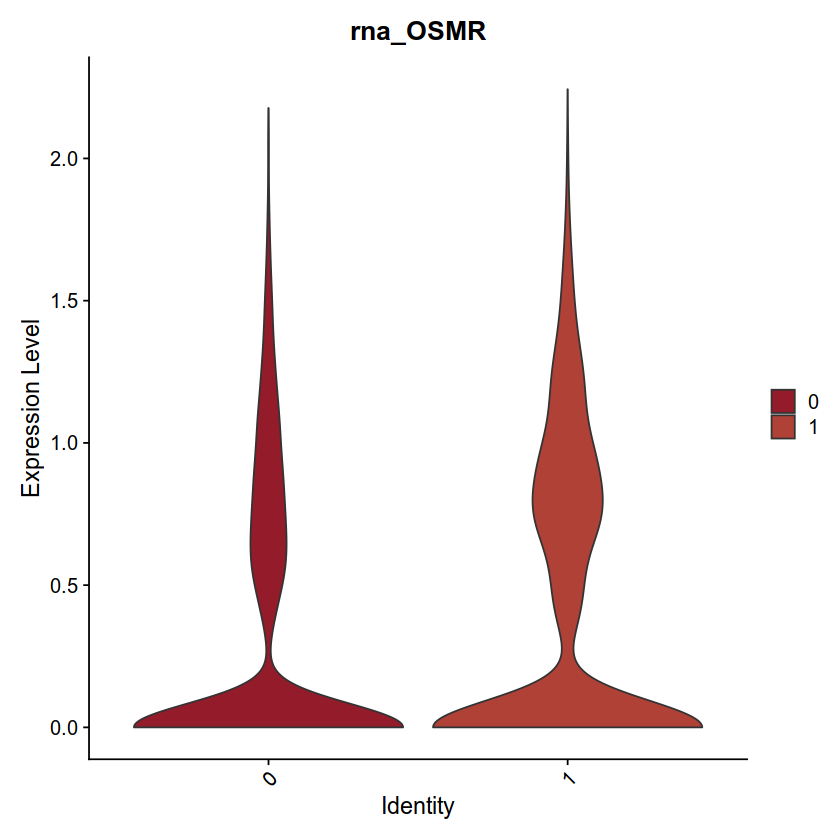

In [248]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
VlnPlot(subset_seurat, features = "OSMR",group.by = "CCA_RNA_snn_res.0.2",pt.size=0,cols = c("#941B2A","#AF4137","#A37660"))

Warning message:
"Could not find LIFR in the default search locations, found in RNA assay instead"


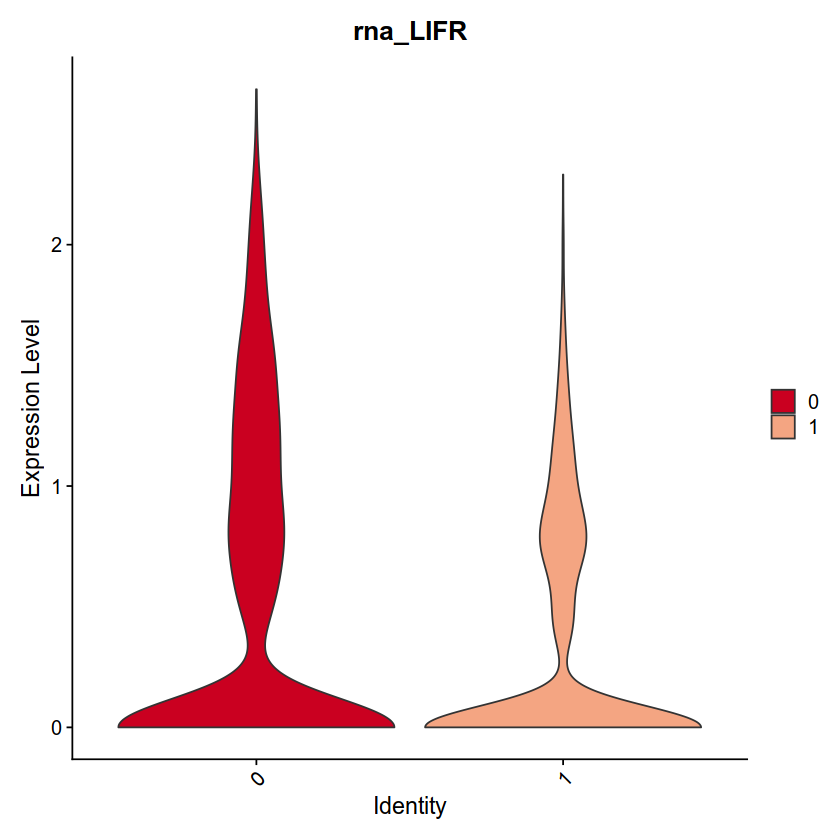

In [249]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
VlnPlot(subset_seurat, features = "LIFR",group.by = "CCA_RNA_snn_res.0.2",cols=col,pt.size=0)

Warning message:
"Could not find IL6ST in the default search locations, found in RNA assay instead"


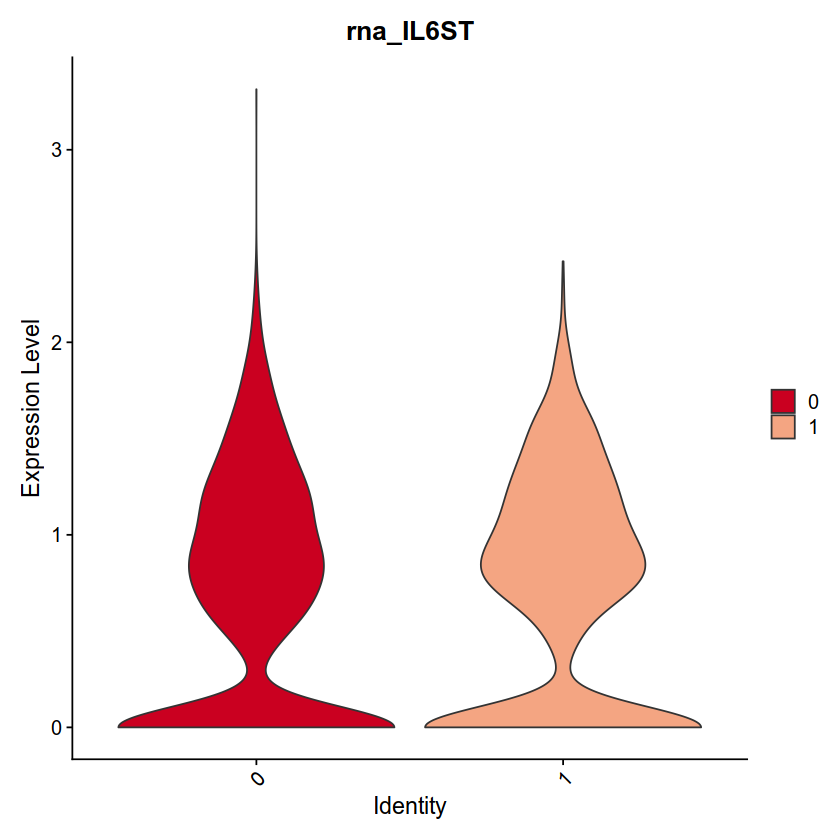

In [250]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
VlnPlot(subset_seurat, features = "IL6ST",group.by = "CCA_RNA_snn_res.0.2",cols=col,pt.size=0)

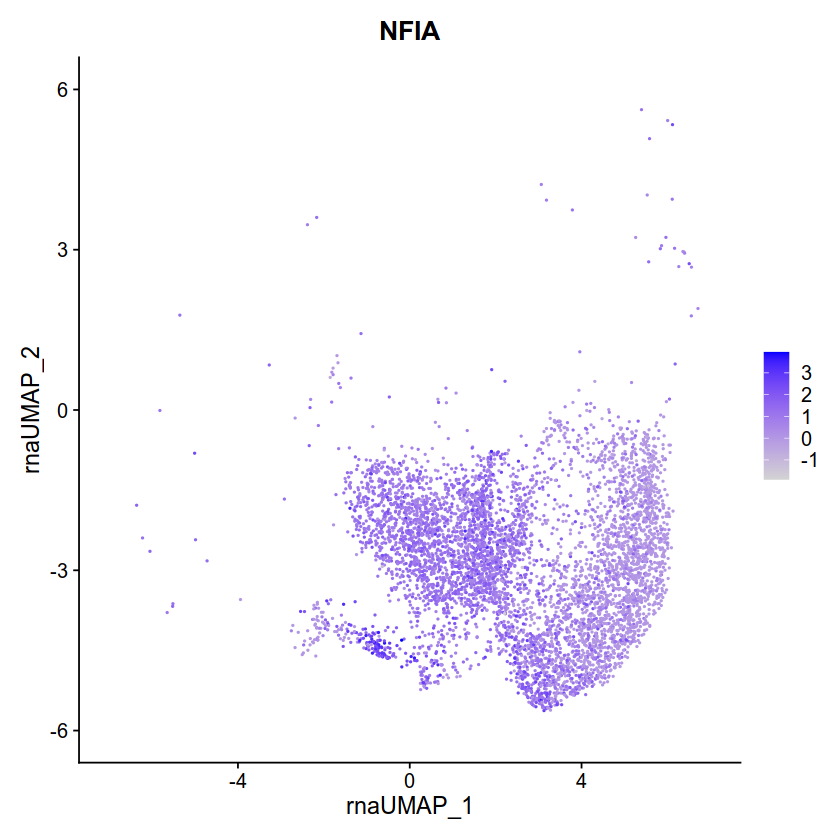

In [251]:
FeaturePlot(subset_seurat, features = 'NFIA',reduction="rna.umap")

In [252]:
library(ComplexHeatmap)
library(pheatmap)
library( "RColorBrewer" )
annotation<-data.frame(glio.int.kmeans_3=subset_seurat$`peaks_snn_res.0.3`)
rownames(annotation)<-names(subset_seurat$`peaks_snn_res.0.3`)
#annotation<-NULL
annotation$glio.int.kmeans_3<-factor(subset_seurat$`peaks_snn_res.0.3`)
#color = colorRampPalette(brewer.pal(3,"RdBu"))(21)
color <- colorRampPalette(RColorBrewer::brewer.pal(7,"RdBu"))(21)
breaks<-seq(-1.5,1.5,by=0.15)

ComplexHeatmap version 2.14.0
Bioconductor page: http://bioconductor.org/packages/ComplexHeatmap/
Github page: https://github.com/jokergoo/ComplexHeatmap
Documentation: http://jokergoo.github.io/ComplexHeatmap-reference

If you use it in published research, please cite either one:
- Gu, Z. Complex Heatmap Visualization. iMeta 2022.
- Gu, Z. Complex heatmaps reveal patterns and correlations in multidimensional 
    genomic data. Bioinformatics 2016.


The new InteractiveComplexHeatmap package can directly export static 
complex heatmaps into an interactive Shiny app with zero effort. Have a try!

This message can be suppressed by:
  suppressPackageStartupMessages(library(ComplexHeatmap))



Attaching package: 'pheatmap'


The following object is masked from 'package:ComplexHeatmap':

    pheatmap




In [253]:
annotation3<-data.frame(group=annotation[order(annotation$glio.int.kmeans_3),])
rownames(annotation3)<-rownames(annotation)[order(annotation$glio.int.kmeans_3)]
#annotation3$group<-factor(annotation3$group)


In [254]:
#chromatin 
DefaultAssay(subset_seurat) <- "peaks"

s<-as.matrix(subset_seurat@assays$peaks@data[tf_chromatin$feature,])
s2<-as.matrix(s[,rownames(annotation3)])



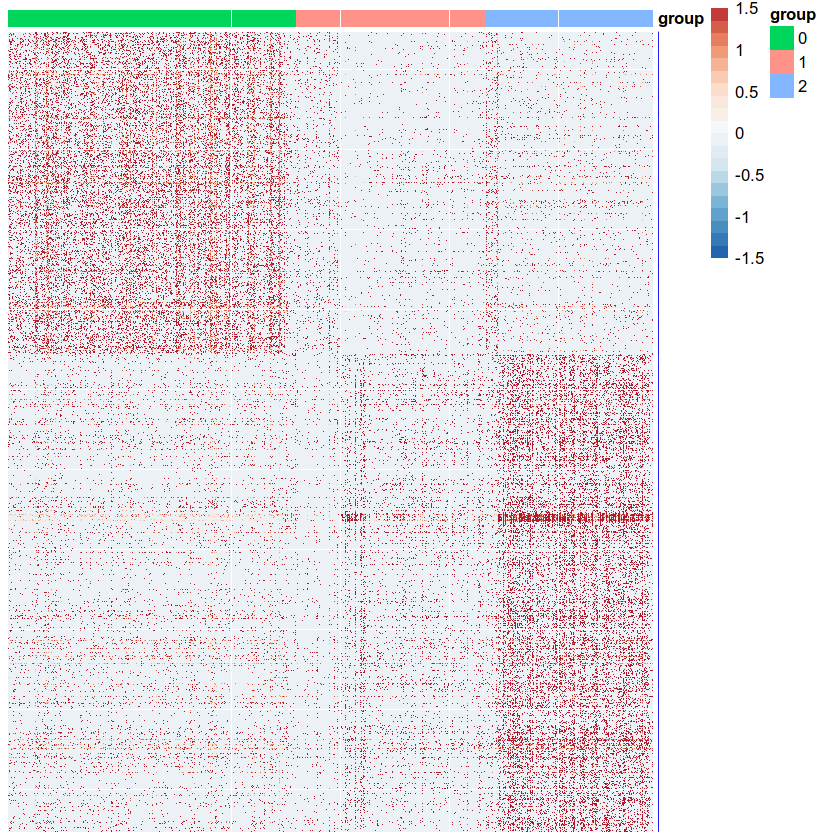

png 
  2

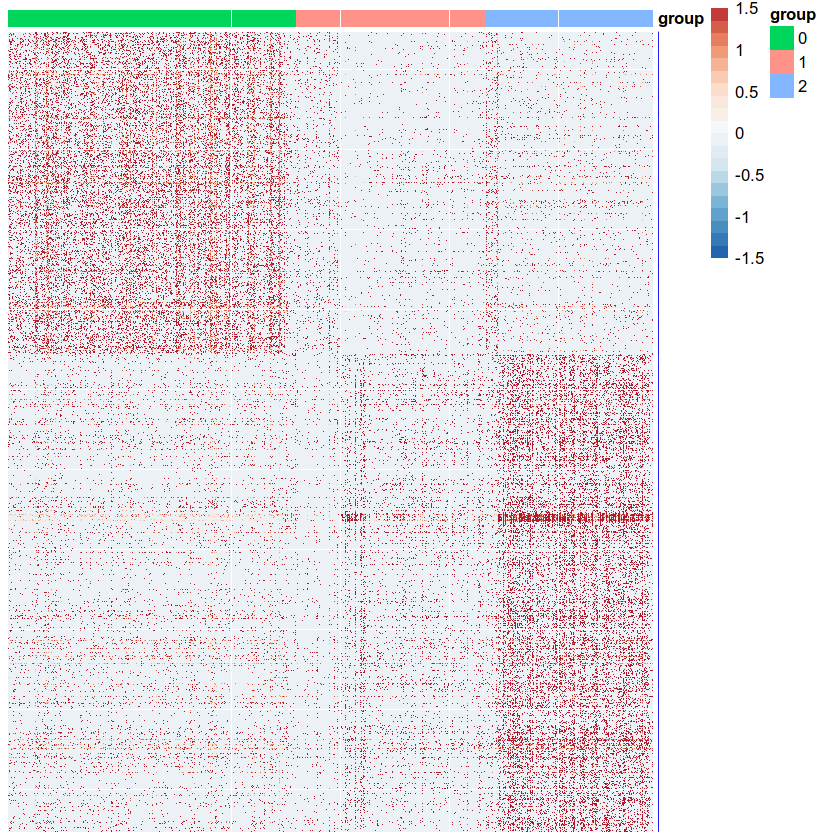

In [255]:
pheatmap(s2, show_rownames=T, cluster_rows=F,cluster_cols = F,clustering_distance_cols="euclidean",scale="none",show_colnames= F,color = rev(color),annotation_col=annotation3,clustering_distance_rows="euclidean", cex=1, clustering_method="complete", border_color=FALSE,fontsize_row=0.2,fontsize_col=4,breaks=breaks)
m<-pheatmap(s2, show_rownames=T, cluster_rows=F,cluster_cols = F,clustering_distance_cols="euclidean",scale="none",show_colnames= F,color = rev(color),annotation_col=annotation3,clustering_distance_rows="euclidean", cex=1, clustering_method="complete", border_color=FALSE,fontsize_row=0.2,fontsize_col=4,breaks=breaks)
pdf("heatmap.chroamtin.accessibility.core.pdf")
m
dev.off()

In [256]:
DefaultAssay(glio.int) <- "CCA_RNA"
markers_rna <- presto:::wilcoxauc.Seurat(X =subset_seurat , group_by = 'peaks_snn_res.0.3', assay = 'data', seurat_assay = 'CCA_RNA')
DefaultAssay(glio.int) <- "peaks"
markers_motifs <- presto:::wilcoxauc.Seurat(X = subset_seurat, group_by = 'peaks_snn_res.0.3', assay = 'data', seurat_assay = 'chromvar')
motif.names <- markers_motifs$feature
colnames(markers_rna) <- paste0("RNA.", colnames(markers_rna))
colnames(markers_motifs) <- paste0("motif.", colnames(markers_motifs))
markers_rna$gene <- markers_rna$RNA.feature
markers_motifs$gene <- ConvertMotifID(glio.int, id = motif.names)

In [257]:
topTFs_motif <- function(peaks_snn_res.0.3, padj.cutoff = 0.01) {
  ctmarkers_motif <- dplyr::filter(
    markers_motifs, motif.group == peaks_snn_res.0.3, motif.padj < padj.cutoff, motif.logFC > 0.5,motif.auc > 0.6) 
  top_tfs <- ctmarkers_motif
  return(top_tfs)
}

In [258]:
tf1_motif<-topTFs_motif("0")
tf2_motif<-topTFs_motif("1")
tf3_motif<-topTFs_motif("2")

tf_motif<-rbind(tf1_motif,tf2_motif,tf3_motif)

In [259]:
write.table(tf_motif,file="tf.motif.core.subcluster.xls",quote=F,sep="\t",row.names=F)

In [260]:
getwd()

[1] "/disk1/xilu/glioblastoma_single_cell/1.RNA/5.figure"

In [261]:
annotation3<-data.frame(group=annotation[order(annotation$glio.int.kmeans_3),])
rownames(annotation3)<-rownames(annotation)[order(annotation$glio.int.kmeans_3)]
#annotation3$group<-factor(annotation3$group)


In [262]:
s<-as.matrix(glio.int@assays$chromvar@data[tf_motif$motif.feature,])
s2<-as.matrix(s[,rownames(annotation3)])



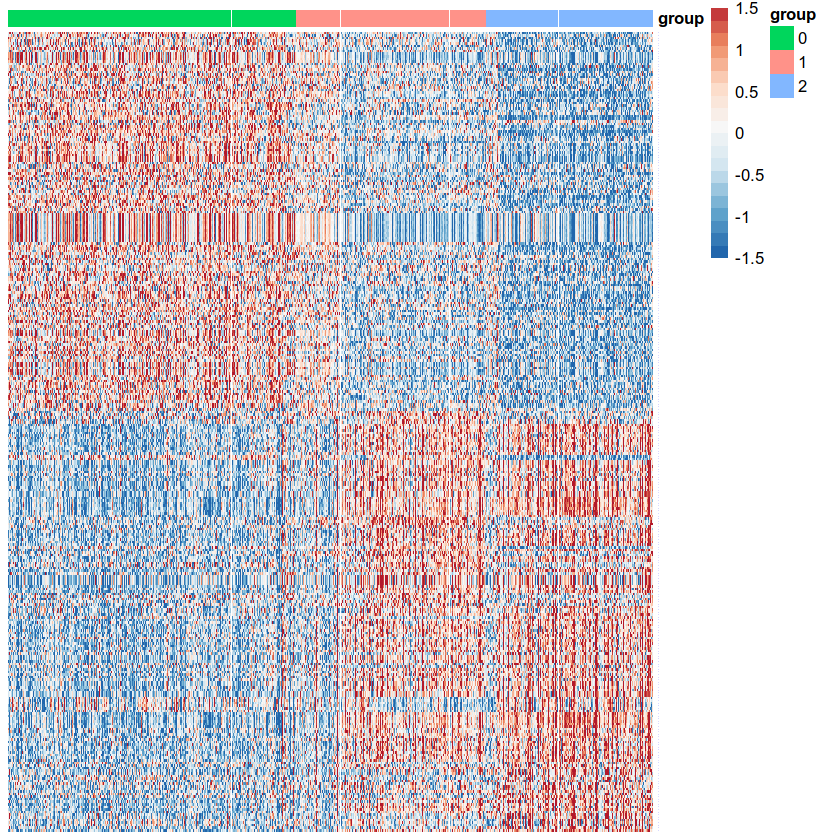

In [263]:
pheatmap(s2, show_rownames=T, cluster_rows=F,cluster_cols = F,clustering_distance_cols="euclidean",scale="row",show_colnames= F,color = rev(color),annotation_col=annotation3,clustering_distance_rows="euclidean", cex=1, clustering_method="complete", border_color=FALSE,fontsize_row=0.2,fontsize_col=4,breaks=breaks)


In [264]:
tf_motif2<-markers_motifs[which(markers_motifs$motif.group == "0"),]
tf_motif2$motif.padj<--log10(tf_motif2$motif.padj)
library(dplyr)
mydata<-tf_motif2%>%mutate(threshold = ifelse(motif.logFC>= 0.5 & motif.auc	 >0.6 ,"sig", "non-significant"))

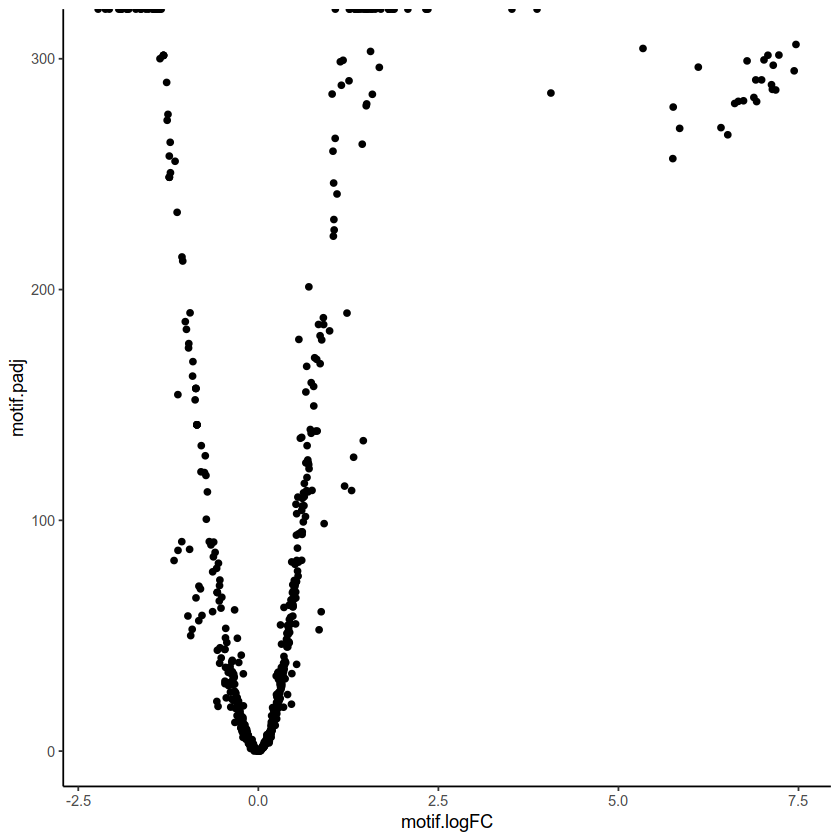

In [265]:
#tf_motif2<-tf_motif
#tf_motif2$motif.padj<--log10(tf_motif2$motif.padj)
#tf_motif2<-tf_motif2[which(tf_motif2$motif.group == "0"),]
ggplot(tf_motif2, aes(x=motif.logFC, y=motif.padj)) + geom_point()+theme_classic()

Warning message in mydata$motif.feature == head(mydata[which(mydata$threshold == :
"longer object length is not a multiple of shorter object length"


integer(0)

png 
  2

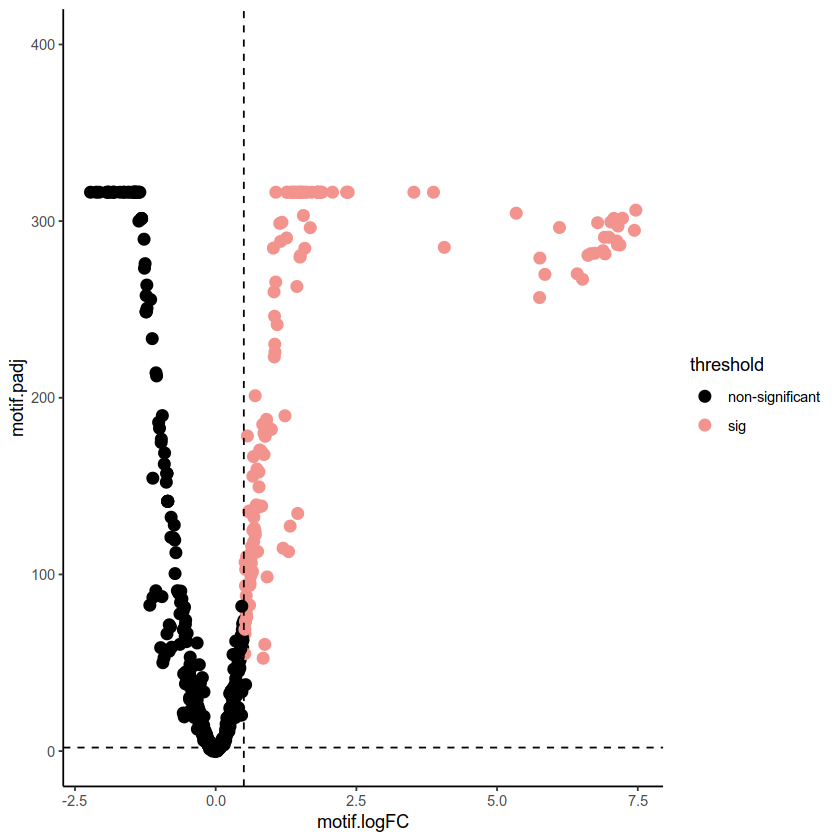

In [345]:
tf_motif2<-markers_motifs[which(markers_motifs$motif.group == "0"),]
tf_motif2$motif.padj<--log10(tf_motif2$motif.padj)
tf_motif2$motif.padj[is.infinite(tf_motif2$motif.padj)]<-306.363256720647+10
library(dplyr)
library(ggrepel)
mydata<-tf_motif2%>%mutate(threshold = ifelse(motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >2,"sig", "non-significant"))
which(mydata$motif.feature == head(mydata[which(mydata$threshold == "sig"),]$motif.feature,10))

ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+ geom_hline(yintercept = 2,linetype="dashed", color = "black", size=0.5)+geom_vline(xintercept = 0.5,linetype="dashed", color = "black", size=0.5)+ylim(c(0,400))+theme_classic()
a<-ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+ geom_hline(yintercept = 2,linetype="dashed", color = "black", size=0.5)+geom_vline(xintercept = 0.5,linetype="dashed", color = "black", size=0.5)+ylim(c(0,400))+theme_classic()
pdf("volcano.core.c0.pdf")
a
dev.off()

Warning message in mydata$motif.feature == head(mydata[which(mydata$threshold == :
"longer object length is not a multiple of shorter object length"


integer(0)

png 
  2

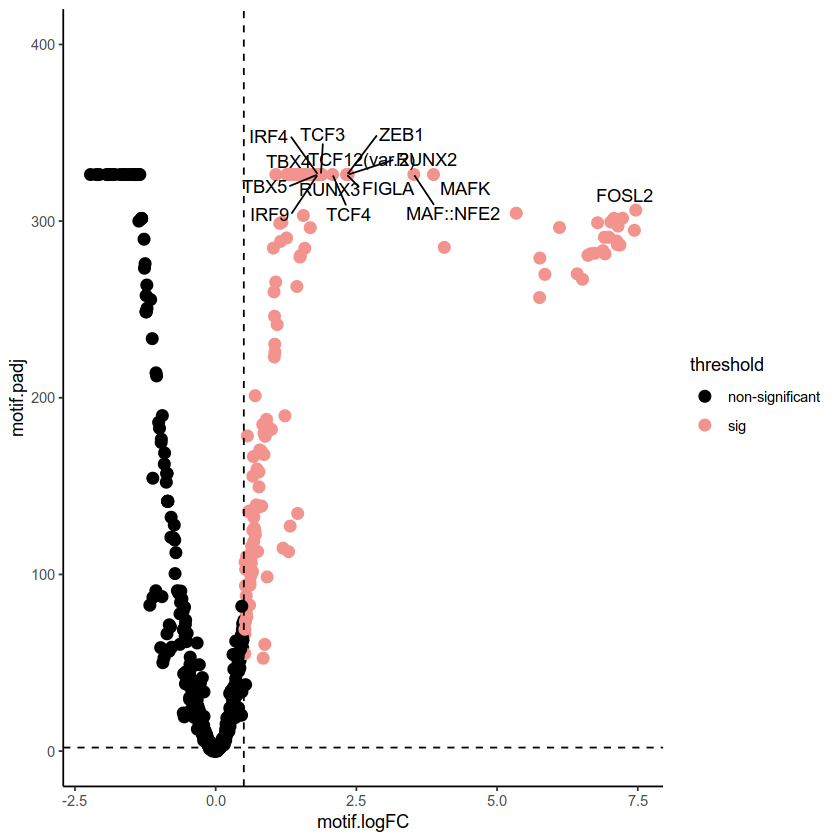

In [342]:
tf_motif2<-markers_motifs[which(markers_motifs$motif.group == "0"),]
tf_motif2$motif.padj<--log10(tf_motif2$motif.padj)
tf_motif2$motif.padj[is.infinite(tf_motif2$motif.padj)]<-306.363256720647+20
library(dplyr)
library(ggrepel)
mydata<-tf_motif2%>%mutate(threshold = ifelse(motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >2,"sig", "non-significant"))
which(mydata$motif.feature == head(mydata[which(mydata$threshold == "sig"),]$motif.feature,10))

ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+geom_text_repel(data=subset(mydata,motif.logFC>= 1.8 & motif.auc>0.6 & motif.padj >305),aes(label = gene),max.overlaps = 30)+ylim(c(0,400))+ geom_hline(yintercept = 2,linetype="dashed", color = "black", size=0.5)+geom_vline(xintercept = 0.5,linetype="dashed", color = "black", size=0.5)+theme_classic()
a<-ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+geom_text_repel(data=subset(mydata,motif.logFC>= 1.8 & motif.auc>0.6 & motif.padj >305),aes(label = gene),max.overlaps = 30)+ylim(c(0,400))+ geom_hline(yintercept = 2,linetype="dashed", color = "black", size=0.5)+geom_vline(xintercept = 0.5,linetype="dashed", color = "black", size=0.5)+theme_classic()
pdf("volcano.core.c0-add.pdf")
a
dev.off()

In [268]:
g<-subset(mydata,motif.logFC>= 1.8 & motif.auc>0.6 & motif.padj >305)
g2<-g[order(g$motif.padj,decreasing =T),]
head(g2[order(g2$motif.logFC,decreasing =T),],13)
g2[order(g2$motif.logFC,decreasing =T),]

write.table(g2[order(g2$motif.logFC,decreasing =T),],file="core1.cluster.TF.xls",quote=F,sep="\t",row.names=F)

,motif.feature,motif.group,motif.avgExpr,motif.logFC,motif.statistic,motif.auc,motif.pval,motif.padj,motif.pct_in,motif.pct_out,gene,threshold
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
32,MA0478.1,0,1.7904615,7.465024,6655295,0.7846079,5.632209e-308,306.2038,100,100,FOSL2,sig
592,MA0496.3,0,0.6237941,3.869848,6705221,0.7904938,0.000000e+00,326.3633,100,100,MAFK,sig
38,MA0501.1,0,0.6364603,3.521253,6658093,0.7849377,0.000000e+00,326.3633,100,100,MAF::NFE2,sig
221,MA0511.2,0,1.0717259,2.354709,6868034,0.8096882,0.000000e+00,326.3633,100,100,RUNX2,sig
320,MA0103.3,0,1.6705151,2.335990,7470098,0.8806668,0.000000e+00,326.3633,100,100,ZEB1,sig
241,MA0820.1,0,1.9373650,2.326509,7364825,0.8682560,0.000000e+00,326.3633,100,100,FIGLA,sig
622,MA0830.2,0,1.8768241,2.076227,7027210,0.8284538,0.000000e+00,326.3633,100,100,TCF4,sig
543,MA1648.1,0,1.7489528,1.886412,6957770,0.8202673,0.000000e+00,326.3633,100,100,TCF12(var.2),sig
621,MA0522.3,0,1.7397207,1.869804,6940197,0.8181956,0.000000e+00,326.3633,100,100,TCF3,sig


,motif.feature,motif.group,motif.avgExpr,motif.logFC,motif.statistic,motif.auc,motif.pval,motif.padj,motif.pct_in,motif.pct_out,gene,threshold
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
32,MA0478.1,0,1.7904615,7.465024,6655295,0.7846079,5.632209e-308,306.2038,100,100,FOSL2,sig
592,MA0496.3,0,0.6237941,3.869848,6705221,0.7904938,0.000000e+00,326.3633,100,100,MAFK,sig
38,MA0501.1,0,0.6364603,3.521253,6658093,0.7849377,0.000000e+00,326.3633,100,100,MAF::NFE2,sig
221,MA0511.2,0,1.0717259,2.354709,6868034,0.8096882,0.000000e+00,326.3633,100,100,RUNX2,sig
320,MA0103.3,0,1.6705151,2.335990,7470098,0.8806668,0.000000e+00,326.3633,100,100,ZEB1,sig
241,MA0820.1,0,1.9373650,2.326509,7364825,0.8682560,0.000000e+00,326.3633,100,100,FIGLA,sig
622,MA0830.2,0,1.8768241,2.076227,7027210,0.8284538,0.000000e+00,326.3633,100,100,TCF4,sig
543,MA1648.1,0,1.7489528,1.886412,6957770,0.8202673,0.000000e+00,326.3633,100,100,TCF12(var.2),sig
621,MA0522.3,0,1.7397207,1.869804,6940197,0.8181956,0.000000e+00,326.3633,100,100,TCF3,sig


Warning message in mydata$motif.feature == head(mydata[which(mydata$threshold == :
"longer object length is not a multiple of shorter object length"


[1] 34

png 
  2

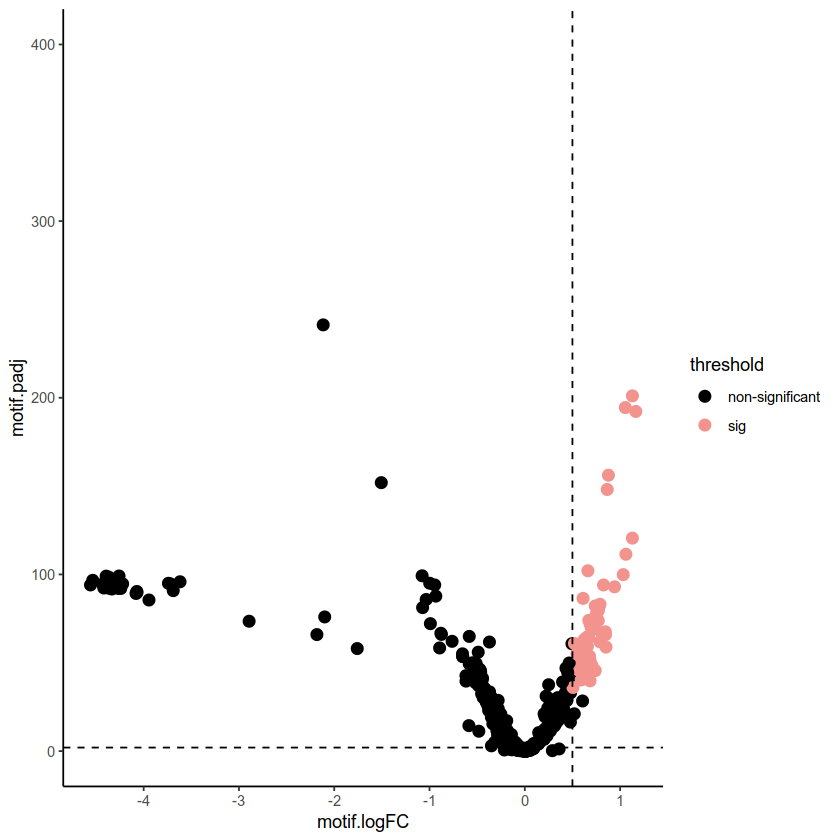

In [346]:
tf_motif2<-markers_motifs[which(markers_motifs$motif.group == "1"),]
tf_motif2$motif.padj<--log10(tf_motif2$motif.padj)
#tf_motif2$motif.padj[is.infinite(tf_motif2$motif.padj)]<-356.363256720647+10
library(dplyr)
library(ggrepel)
mydata<-tf_motif2%>%mutate(threshold = ifelse(motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >2,"sig", "non-significant"))
which(mydata$motif.feature == head(mydata[which(mydata$threshold == "sig"),]$motif.feature,10))

ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+ geom_hline(yintercept = 2,linetype="dashed", color = "black", size=0.5)+geom_vline(xintercept = 0.5,linetype="dashed", color = "black", size=0.5)+ylim(c(0,400))+theme_classic()
a<-ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+ geom_hline(yintercept = 2,linetype="dashed", color = "black", size=0.5)+geom_vline(xintercept = 0.5,linetype="dashed", color = "black", size=0.5)+ylim(c(0,400))+theme_classic()
pdf("volcano.core.c1.pdf")
a
dev.off()

Warning message in mydata$motif.feature == head(mydata[which(mydata$threshold == :
"longer object length is not a multiple of shorter object length"


[1] 34

png 
  2

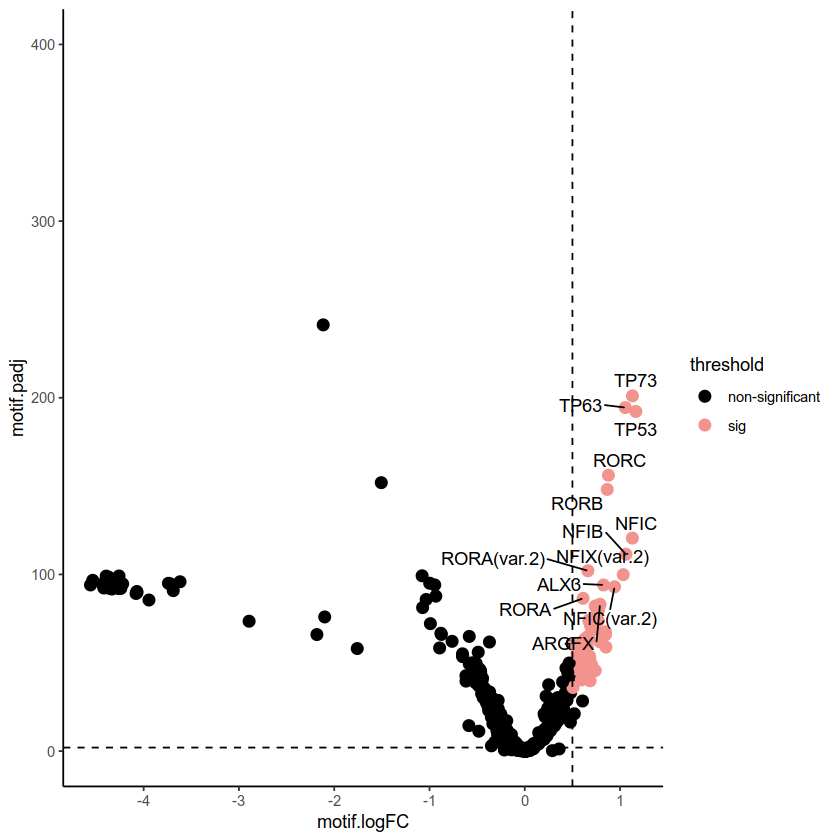

In [341]:
tf_motif2<-markers_motifs[which(markers_motifs$motif.group == "1"),]
tf_motif2$motif.padj<--log10(tf_motif2$motif.padj)
#tf_motif2$motif.padj[is.infinite(tf_motif2$motif.padj)]<-356.363256720647+10
library(dplyr)
library(ggrepel)
mydata<-tf_motif2%>%mutate(threshold = ifelse(motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >2,"sig", "non-significant"))
which(mydata$motif.feature == head(mydata[which(mydata$threshold == "sig"),]$motif.feature,10))

ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+geom_text_repel(data=subset(mydata,motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >83),aes(label = gene),max.overlaps = 30)+ylim(c(0,400))+ geom_hline(yintercept = 2,linetype="dashed", color = "black", size=0.5)+geom_vline(xintercept = 0.5,linetype="dashed", color = "black", size=0.5)+theme_classic()
a<-ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+geom_text_repel(data=subset(mydata,motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >83),aes(label = gene),max.overlaps = 30)+ylim(c(0,400))+ geom_hline(yintercept = 2,linetype="dashed", color = "black", size=0.5)+geom_vline(xintercept = 0.5,linetype="dashed", color = "black", size=0.5)+theme_classic()
pdf("volcano.core.c1-add.pdf")
a
dev.off()

In [271]:
write.table(mydata[mydata$threshold == "sig",],file="core2.tf.sig.xls",quote=F,sep="\t",row.names=F)


In [272]:
g<-subset(mydata,motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >83)
g2<-g[order(g$motif.padj,decreasing =T),]
#g2[order(g2$motif.logFC,decreasing =T),]
g2
write.table(g2,file="core2.cluster.TF.xls",quote=F,sep="\t",row.names=F)

,motif.feature,motif.group,motif.avgExpr,motif.logFC,motif.statistic,motif.auc,motif.pval,motif.padj,motif.pct_in,motif.pct_out,gene,threshold
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
901,MA0861.1,1,-0.09306995,1.1295185,5367162,0.7523105,2.673639e-204,201.07252,100,100,TP73,sig
899,MA0525.2,1,-0.10317038,1.0549551,5336674,0.7480371,1.655060e-197,194.45690,100,100,TP63,sig
900,MA0106.3,1,-0.15102822,1.1651318,5326151,0.7465621,3.436789e-195,192.26450,100,100,TP53,sig
984,MA1151.1,1,-0.05571245,0.8778136,5152743,0.7222557,5.463978e-159,156.16006,100,100,RORC,sig
983,MA1150.1,1,-0.02967463,0.8651279,5110680,0.7163597,9.004957e-151,148.08921,100,100,RORB,sig
937,MA0161.2,1,0.32285699,1.1293843,4960211,0.6952686,3.509465e-123,120.55645,100,100,NFIC,sig
1171,MA1643.1,1,0.98523379,1.0612083,4906366,0.6877212,5.418558e-114,111.41896,100,100,NFIB,sig
643,MA0072.1,1,-0.09231349,0.6623699,4848993,0.6796793,1.341409e-104,102.07104,100,100,RORA(var.2),sig
1048,MA1528.1,1,1.21613582,1.0331070,4834962,0.6777126,2.304239e-102,99.87746,100,100,NFIX(var.2),sig


Warning message in mydata$motif.feature == head(mydata[which(mydata$threshold == :
"longer object length is not a multiple of shorter object length"


[1] 41

png 
  2

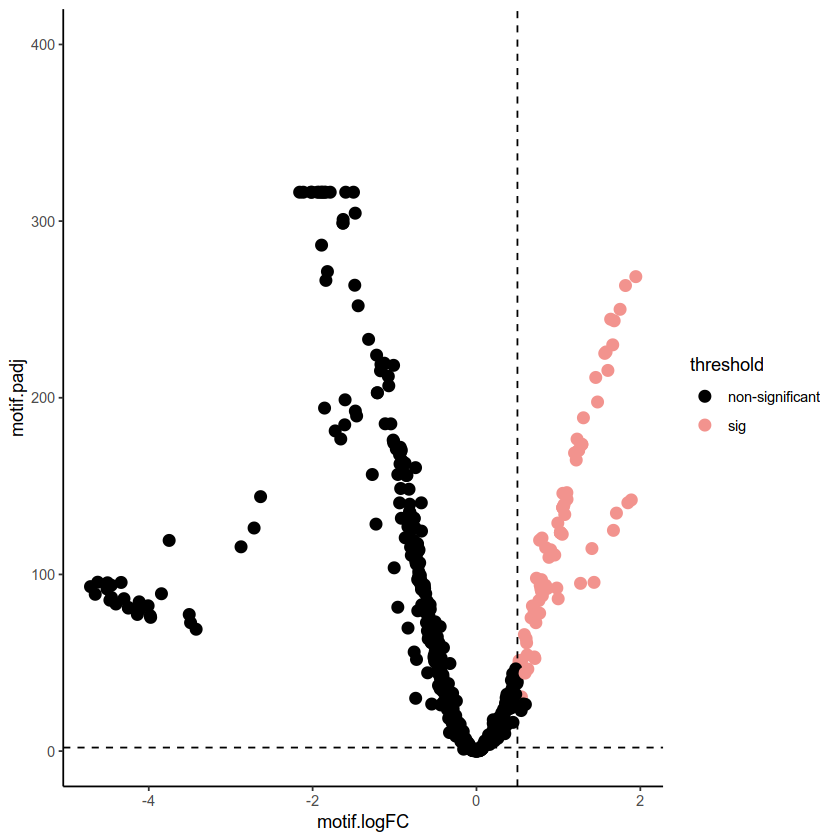

In [347]:
tf_motif2<-markers_motifs[which(markers_motifs$motif.group == "2"),]
tf_motif2$motif.padj<--log10(tf_motif2$motif.padj)
tf_motif2$motif.padj[is.infinite(tf_motif2$motif.padj)]<-306.363256720647+10
library(dplyr)
library(ggrepel)
mydata<-tf_motif2%>%mutate(threshold = ifelse(motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >2,"sig", "non-significant"))
which(mydata$motif.feature == head(mydata[which(mydata$threshold == "sig"),]$motif.feature,10))

ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+ geom_hline(yintercept = 2,linetype="dashed", color = "black", size=0.5)+geom_vline(xintercept = 0.5,linetype="dashed", color = "black", size=0.5)+ylim(c(0,400))+theme_classic()
a<-ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+ geom_hline(yintercept = 2,linetype="dashed", color = "black", size=0.5)+geom_vline(xintercept = 0.5,linetype="dashed", color = "black", size=0.5)+ylim(c(0,400))+theme_classic()
pdf("volcano.core.c2.pdf")
a
dev.off()

Warning message in mydata$motif.feature == head(mydata[which(mydata$threshold == :
"longer object length is not a multiple of shorter object length"


[1] 41

png 
  2

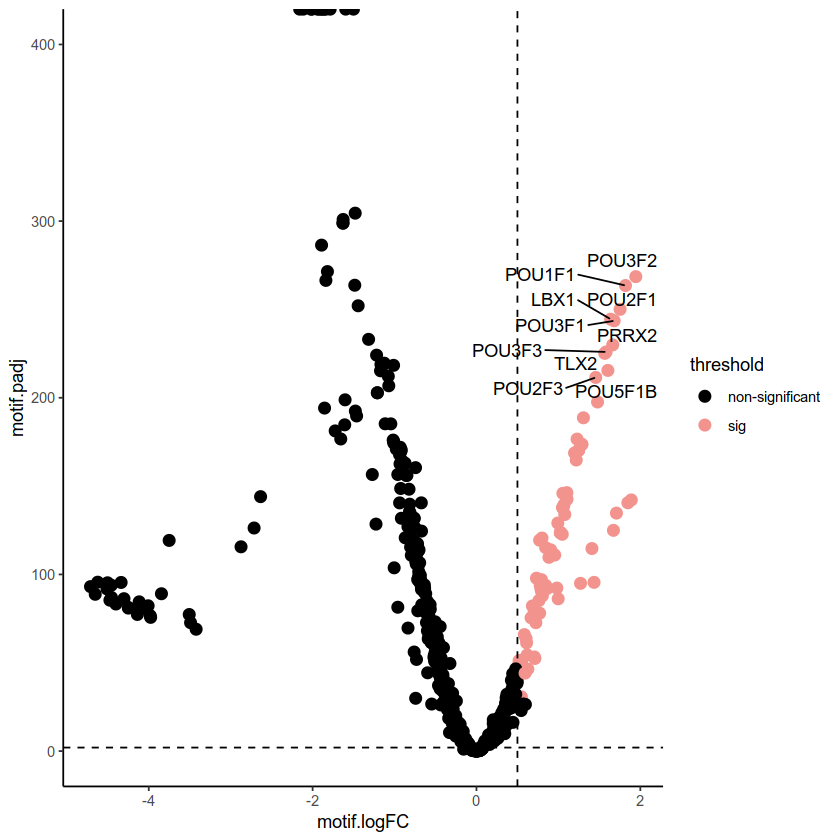

In [340]:
tf_motif2<-markers_motifs[which(markers_motifs$motif.group == "2"),]
tf_motif2$motif.padj<--log10(tf_motif2$motif.padj)
#tf_motif2$motif.padj[is.infinite(tf_motif2$motif.padj)]<-356.363256720647+10
library(dplyr)
library(ggrepel)
mydata<-tf_motif2%>%mutate(threshold = ifelse(motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >2,"sig", "non-significant"))
which(mydata$motif.feature == head(mydata[which(mydata$threshold == "sig"),]$motif.feature,10))

ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+geom_text_repel(data=subset(mydata,motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >198),aes(label = gene),max.overlaps = 30)+ylim(c(0,400))+ geom_hline(yintercept = 2,linetype="dashed", color = "black", size=0.5)+geom_vline(xintercept = 0.5,linetype="dashed", color = "black", size=0.5)+theme_classic()
a<-ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+geom_text_repel(data=subset(mydata,motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >198),aes(label = gene),max.overlaps = 30)+ylim(c(0,400))+ geom_hline(yintercept = 2,linetype="dashed", color = "black", size=0.5)+geom_vline(xintercept = 0.5,linetype="dashed", color = "black", size=0.5)+theme_classic()
pdf("volcano.core.c2-add.pdf")
a
dev.off()

In [275]:
g<-subset(mydata,motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >198)
g2<-g[order(g$motif.padj,decreasing =T),]
#g2[order(g2$motif.logFC,decreasing =T),]

g2
write.table(g2[order(g2$motif.logFC,decreasing =T),],file="core3.cluster.TF.xls",quote=F,sep="\t",row.names=F)

,motif.feature,motif.group,motif.avgExpr,motif.logFC,motif.statistic,motif.auc,motif.pval,motif.padj,motif.pct_in,motif.pct_out,gene,threshold
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
1473,MA0787.1,2,2.224724,1.944834,5278899,0.8029983,8.545693e-271,268.5679,100,100,POU3F2,sig
1470,MA0784.1,2,2.007564,1.818860,5259950,0.8001159,1.043833e-265,263.5417,100,100,POU1F1,sig
1471,MA0785.1,2,2.021742,1.752930,5208712,0.7923219,3.391927e-252,250.0661,100,100,POU2F1,sig
1326,MA0618.1,2,1.850174,1.637940,5187039,0.7890251,1.377063e-246,244.4746,100,100,LBX1,sig
1472,MA0786.1,2,1.986378,1.680603,5183489,0.7884851,1.126070e-245,243.5784,100,100,POU3F1,sig
1783,MA0075.3,2,1.892717,1.663168,5129603,0.7802882,4.954967e-232,229.9660,100,100,PRRX2,sig
1474,MA0788.1,2,1.925117,1.582136,5113371,0.7778191,5.344624e-228,225.9478,100,100,POU3F3,sig
1728,MA1577.1,2,1.784276,1.565781,5110027,0.7773104,3.583579e-227,225.1356,100,100,TLX2,sig
1478,MA0792.1,2,1.850742,1.604032,5070190,0.7712506,1.918390e-217,215.4839,100,100,POU5F1B,sig


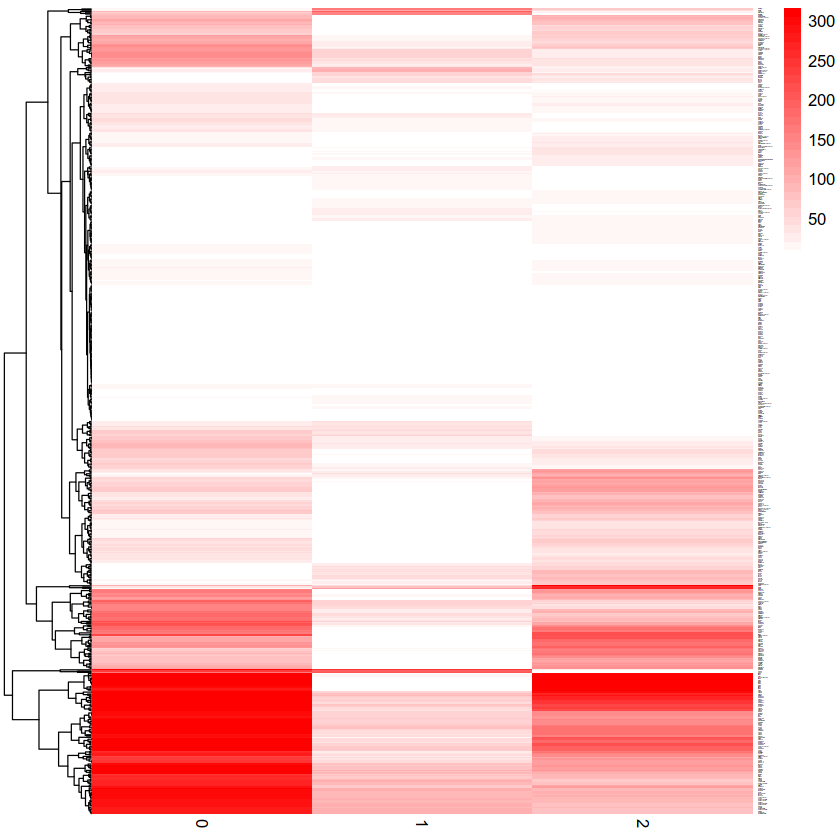

png 
  2

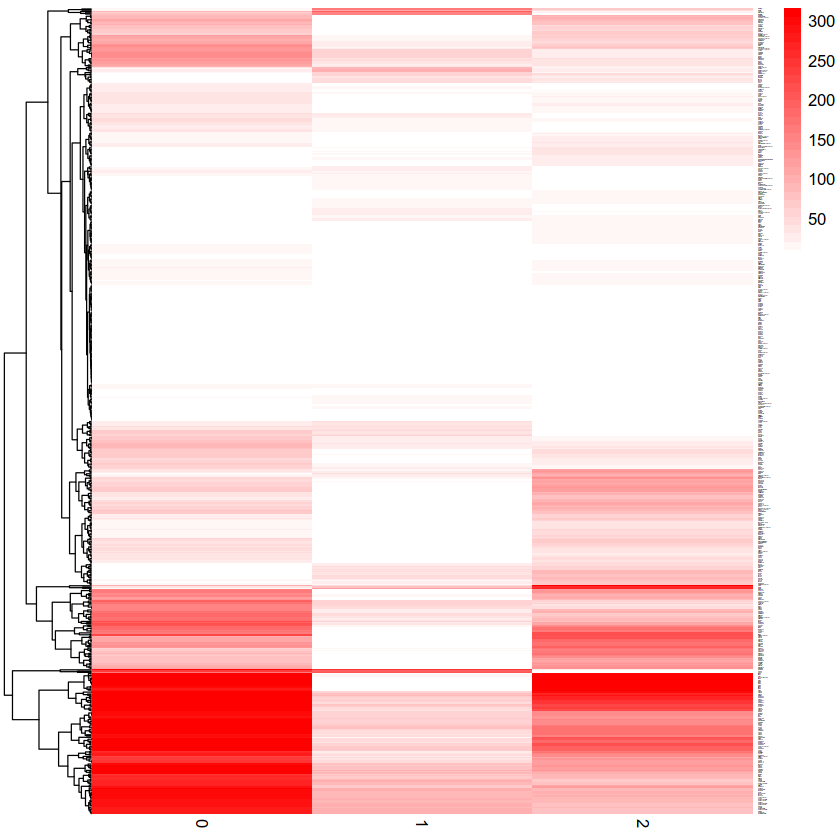

In [276]:
markers_motifs_new<-markers_motifs
markers_motifs_new$motif.pval<--log10(markers_motifs_new$motif.pval)

tf_motif22<-markers_motifs_new[which(markers_motifs_new$motif.group == "2"),]
tf_motif21<-markers_motifs_new[which(markers_motifs_new$motif.group == "1"),]
tf_motif20<-markers_motifs_new[which(markers_motifs_new$motif.group == "0"),]

tf_all<-cbind(tf_motif20[,c(7)],tf_motif21[,c(7)],tf_motif22[,c(7,11)])
colnames(tf_all)<-c("0","1","2")
tf_all2<-tf_all[,c(1,2,3)]
rownames(tf_all2)<-tf_all[,4]
#tf_all2<-tf_all2[is.finite(rowSums(tf_all2)),]
tf_all2[sapply(tf_all2, is.infinite)] <- 306.363256720647+10

library(pheatmap)
cols = colorRampPalette(c("white", "red"))(30)
pheatmap(tf_all2,color = cols,fontsize_row=1,cluster_cols = F)
a<-pheatmap(tf_all2,color = cols,fontsize_row=1,cluster_cols =F)
pdf("pvalue.core.cluster.pdf")
a
dev.off()

In [277]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
markers_rna <- presto:::wilcoxauc.Seurat(X = subset_seurat, group_by = 'CCA_RNA_snn_res.0.2', assay = 'data', seurat_assay = 'CCA_RNA')
colnames(markers_rna) <- paste0("RNA.", colnames(markers_rna))
markers_rna$gene <- markers_rna$RNA.feature

In [278]:
topTFs_rna <- function(CCA_RNA_snn_res.0.2, padj.cutoff = 0.01) {
  ctmarkers_rna <- dplyr::filter(
    markers_rna, RNA.group == CCA_RNA_snn_res.0.2, RNA.padj < 0.01, RNA.logFC > 0.2,RNA.auc>0.6 ) 
  top_tfs <- ctmarkers_rna
  return(top_tfs)
}

In [279]:
tf1_rna<-topTFs_rna("0")
tf2_rna<-topTFs_rna("1")
tf3_rna<-topTFs_rna("2")
tf4_rna<-topTFs_rna("3")
tf5_rna<-topTFs_rna("4")

tf_rna<-rbind(tf1_rna,tf2_rna,tf3_rna)


In [280]:
s<-as.matrix(glio.int@assays$CCA_RNA@scale.data[as.character(tf_rna$RNA.feature),])
s2<-as.matrix(s[,rownames(annotation3)])

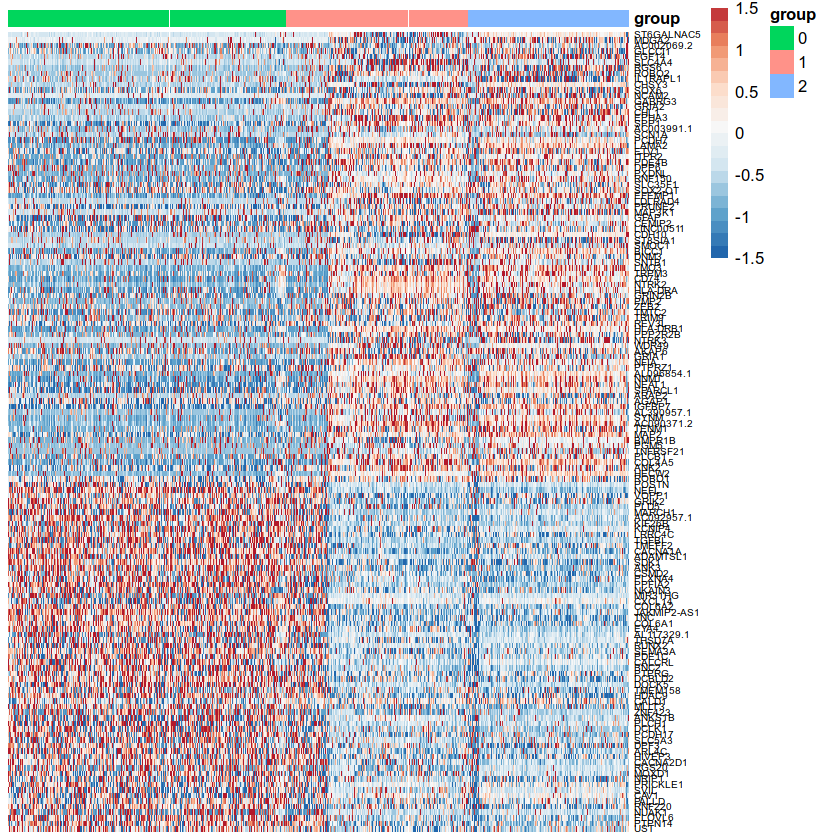

In [281]:
pheatmap(s2, show_rownames=T, cluster_rows=F,cluster_cols = F,clustering_distance_cols="euclidean",scale="row",show_colnames= F,color = rev(color),annotation_col=annotation3,clustering_distance_rows="euclidean", cex=1, clustering_method="complete", border_color=FALSE,fontsize_row=6,fontsize_col=4,breaks=breaks)


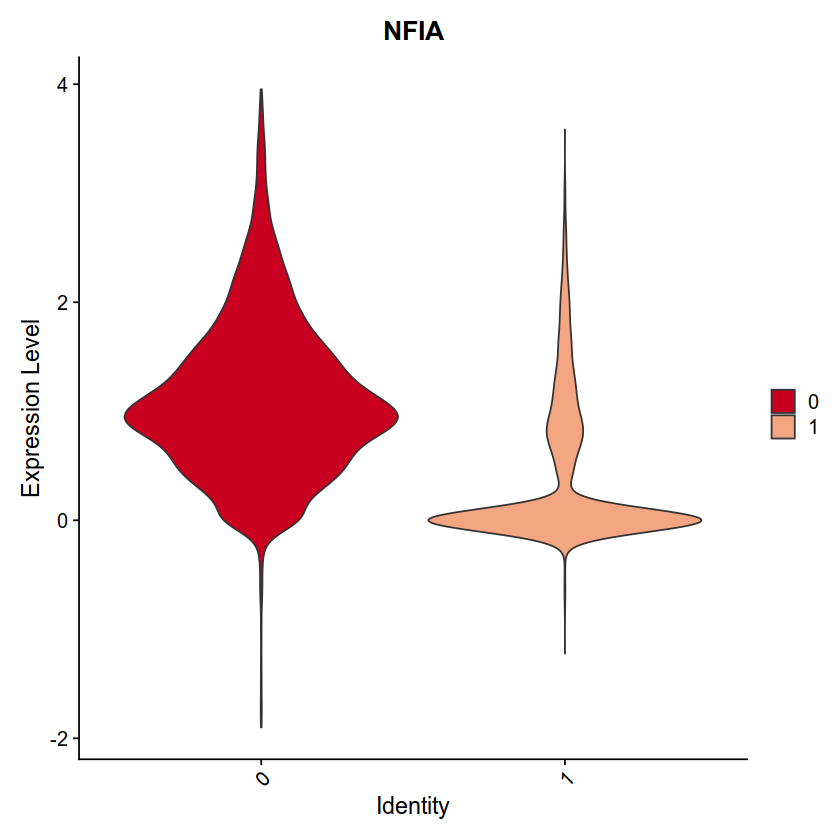

In [282]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
VlnPlot(subset_seurat, features = "NFIA",group.by = "CCA_RNA_snn_res.0.2",cols=col,pt.size=0)

In [283]:
write.table(tf_rna,file="subcluster.rna.xls",quote=F,sep="\t",row.names=F)

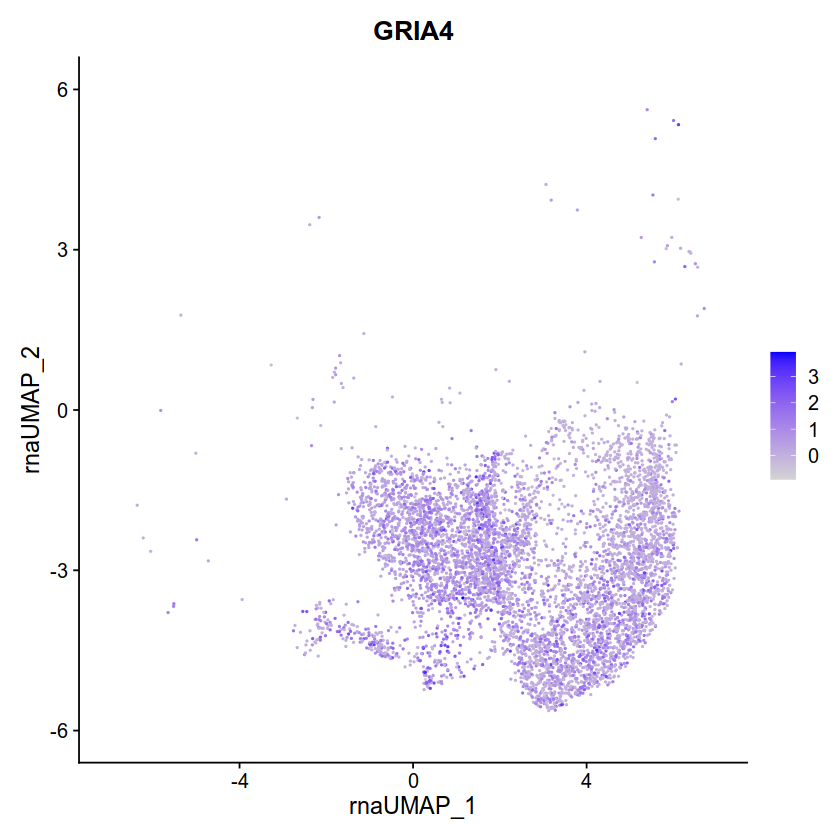

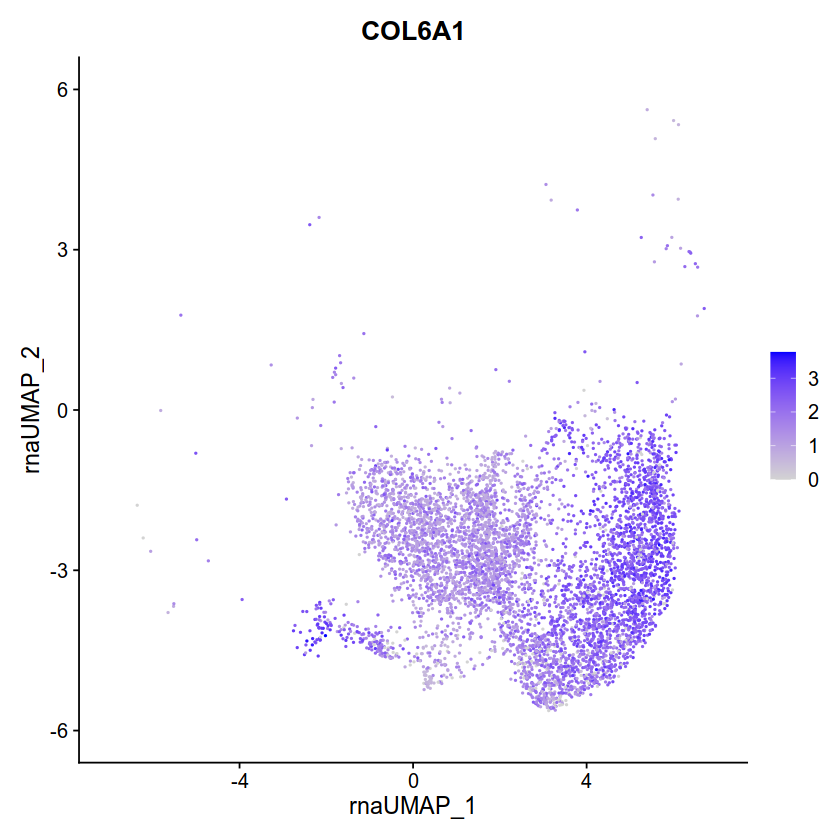

In [284]:
FeaturePlot(subset_seurat, features = 'GRIA4',reduction="rna.umap")
FeaturePlot(subset_seurat, features = 'COL6A1',reduction="rna.umap")


Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


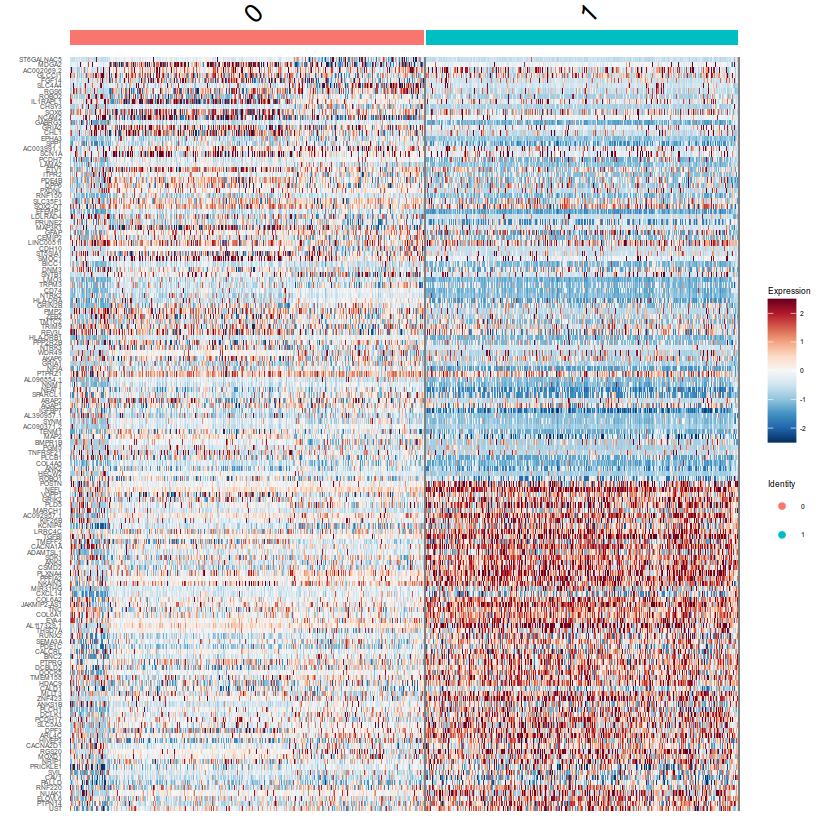

In [285]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
mapal <- colorRampPalette(RColorBrewer::brewer.pal(11,"RdBu"))(256)
#filtered_seurat<-ScaleData(filtered_seurat,features=as.character(unique(top5$gene)),assay="RNA")
DoHeatmap(subset_seurat, features = as.character(tf_rna$RNA.feature), group.by = "CCA_RNA_snn_res.0.2")+scale_fill_gradientn(colours = rev(mapal))+theme(text = element_text(size = 5))

Warning message:
"Only one identity present, the expression values will be not scaled"


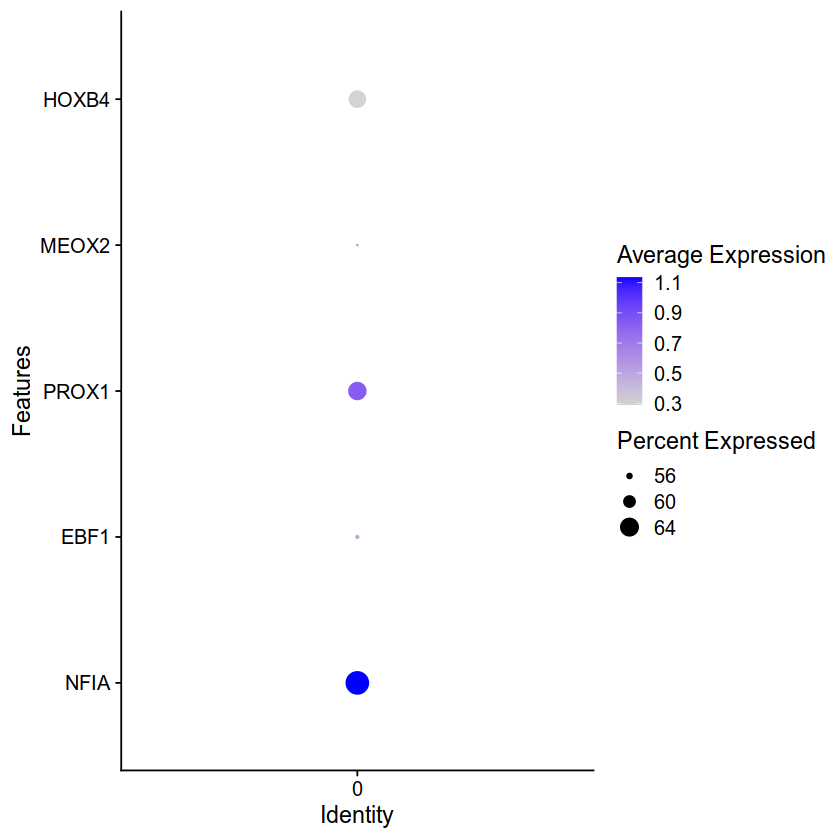

In [286]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
DotPlot(object = subset_seurat, features = unique(tf_c2$gene),group.by = "peaks_snn_res.0.1")+coord_flip() 


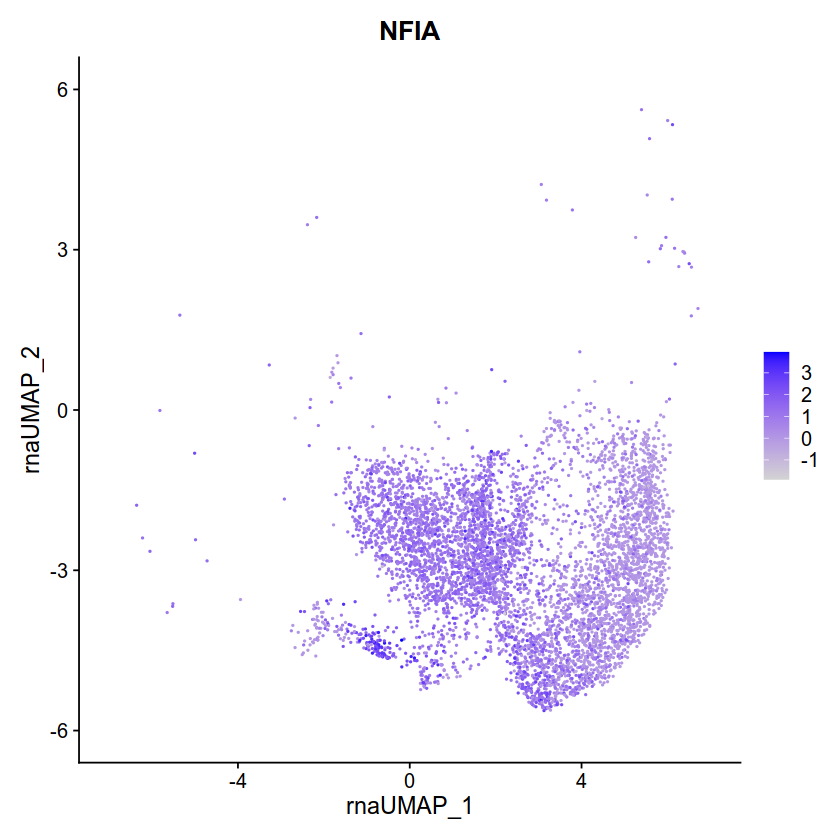

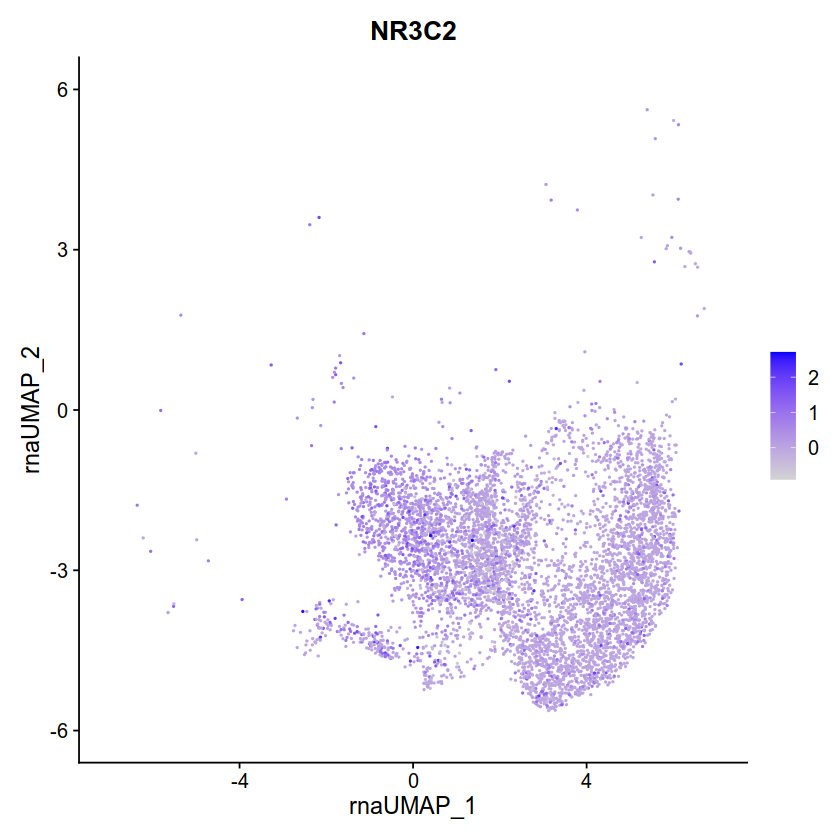

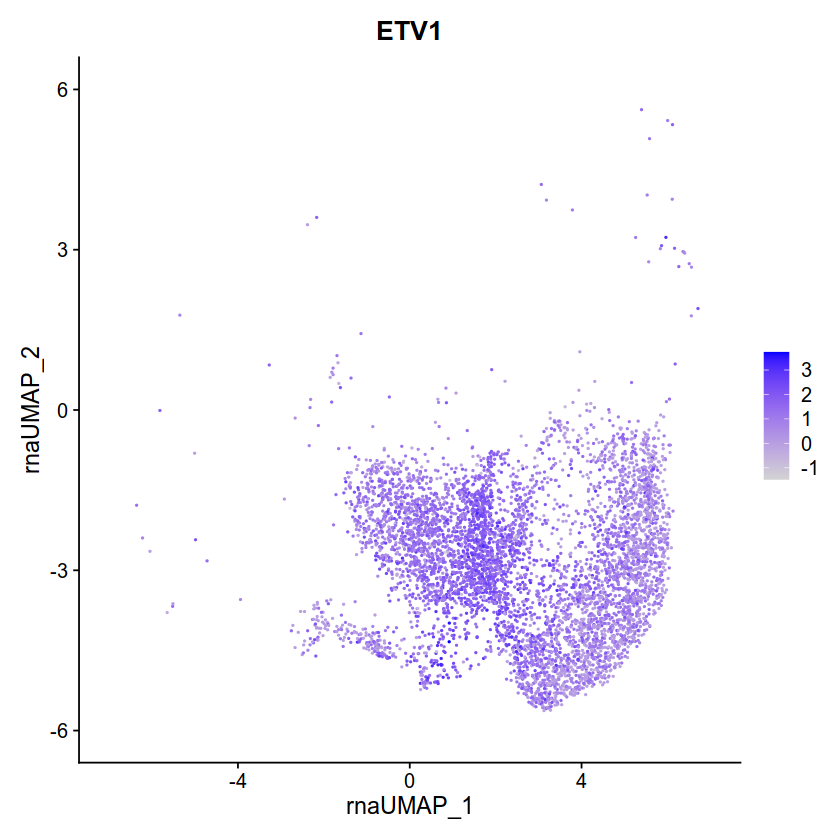

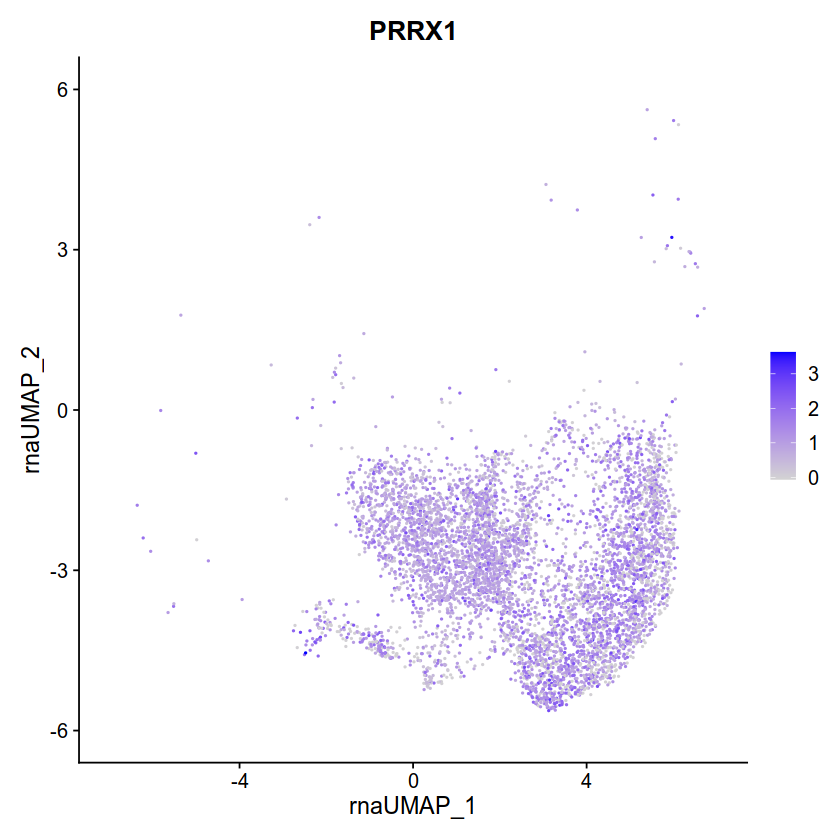

In [287]:
FeaturePlot(subset_seurat, features = 'NFIA',reduction="rna.umap")
FeaturePlot(subset_seurat, features = 'NR3C2',reduction="rna.umap")
FeaturePlot(subset_seurat, features = 'ETV1',reduction="rna.umap")
FeaturePlot(subset_seurat, features = 'PRRX1',reduction="rna.umap")


In [288]:
getwd()

[1] "/disk1/xilu/glioblastoma_single_cell/1.RNA/5.figure"

In [289]:
col<-c("#B3CDE3","#FCCDE5","#B2DF8A","#E6AB02","#FDBF6F")

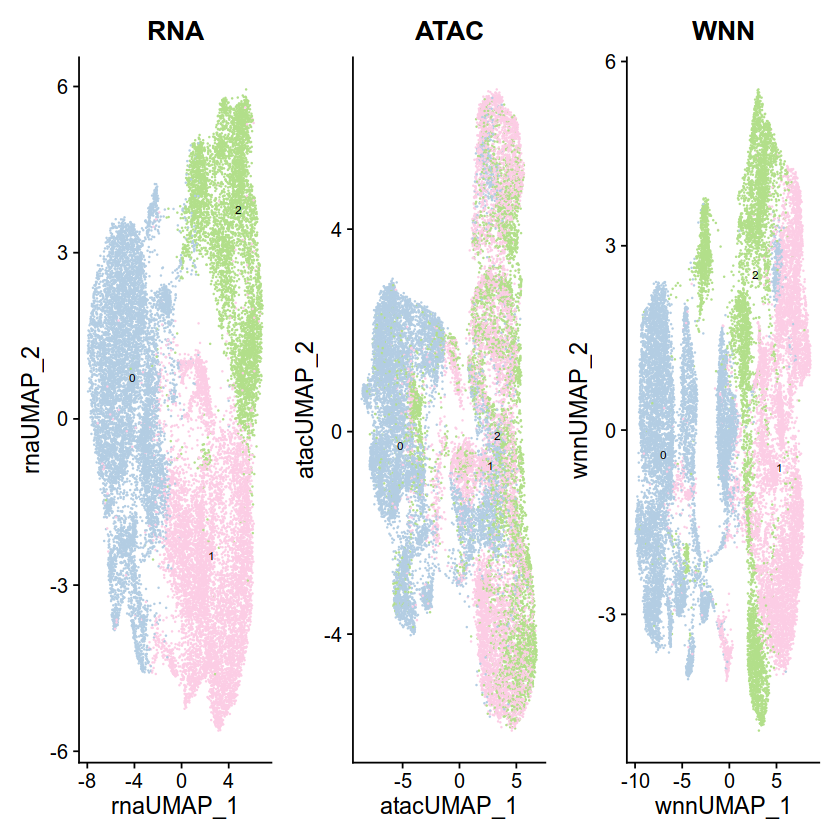

In [290]:
p1 <- DimPlot(glio.int, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.1", label = TRUE, label.size = 2.5, repel = TRUE,cols=col) + ggtitle("RNA")
p2 <- DimPlot(glio.int, reduction = "umap", group.by = "CCA_RNA_snn_res.0.1", label = TRUE, label.size = 2.5, repel = TRUE,cols=col) + ggtitle("ATAC")
p3 <- DimPlot(glio.int, reduction = "wnn.umap", group.by = "CCA_RNA_snn_res.0.1",label = TRUE, label.size = 2.5, repel = TRUE,cols=col) + ggtitle("WNN")
p1 + p2 + p3 & NoLegend() & theme(plot.title = element_text(hjust = 0.5))

In [291]:
pdf("atac.seq.umap.pdf")
DimPlot(glio.int, reduction = "umap", group.by = "type",cols = c("#D4CB92","#395C6B")) + ggtitle("louvain_1")
dev.off()

png 
  2

In [292]:
DefaultAssay(subset_seurat) <- "peaks"
subset_seurat <- RegionStats(subset_seurat, genome = BSgenome.Hsapiens.UCSC.hg38)


In [293]:
peaklink <- LinkPeaks(
  object = subset_seurat,
  peak.assay = "peaks",
  expression.assay = "CCA_RNA",
  genes.use = c("NFIA")
)

Testing 1 genes and 231504 peaks

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
as(<dgCMatrix>, "dgTMatrix") is deprecated since Matrix 1.5-0; do as(., "TsparseMatrix") instead



Warning message:
"Removed 51 rows containing non-finite values (`stat_ydensity()`)."
Warning message:
"Removed 23 rows containing missing values (`geom_segment()`)."


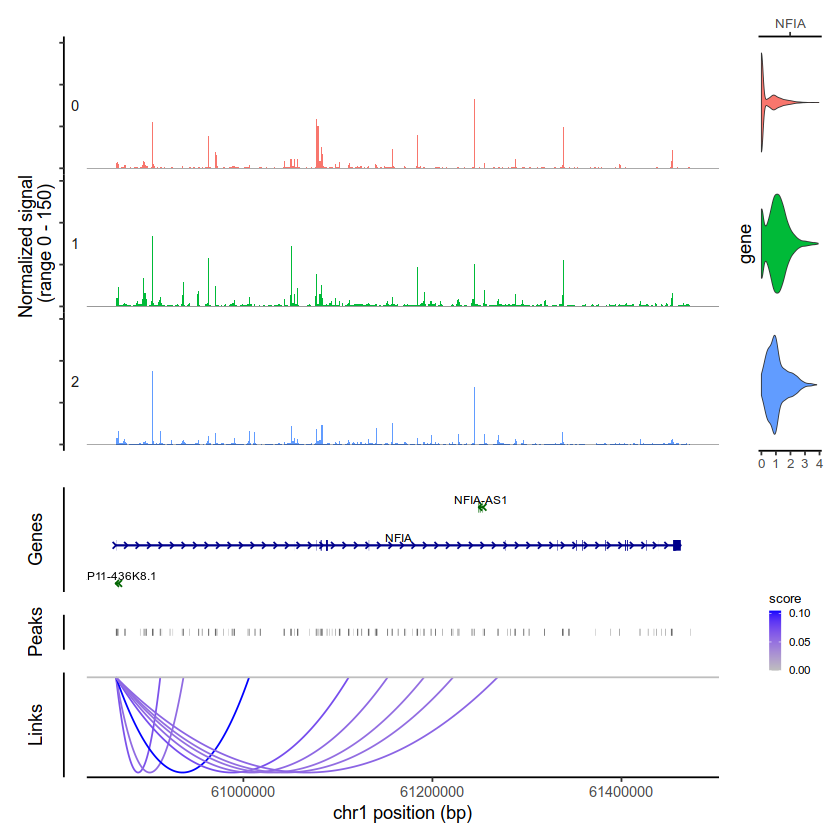

In [294]:
p1 <- CoveragePlot(
  object = peaklink,
  region = "NFIA",
  features = "NFIA",
  expression.assay = "CCA_RNA",
  group.by = "peaks_snn_res.0.3",
#  idents = c("0","1","2"),
  extend.upstream = 500,
  extend.downstream = 10000
)
patchwork::wrap_plots(p1, ncol = 1)

Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message:
"Removed 17 rows containing non-finite values (`stat_ydensity()`)."


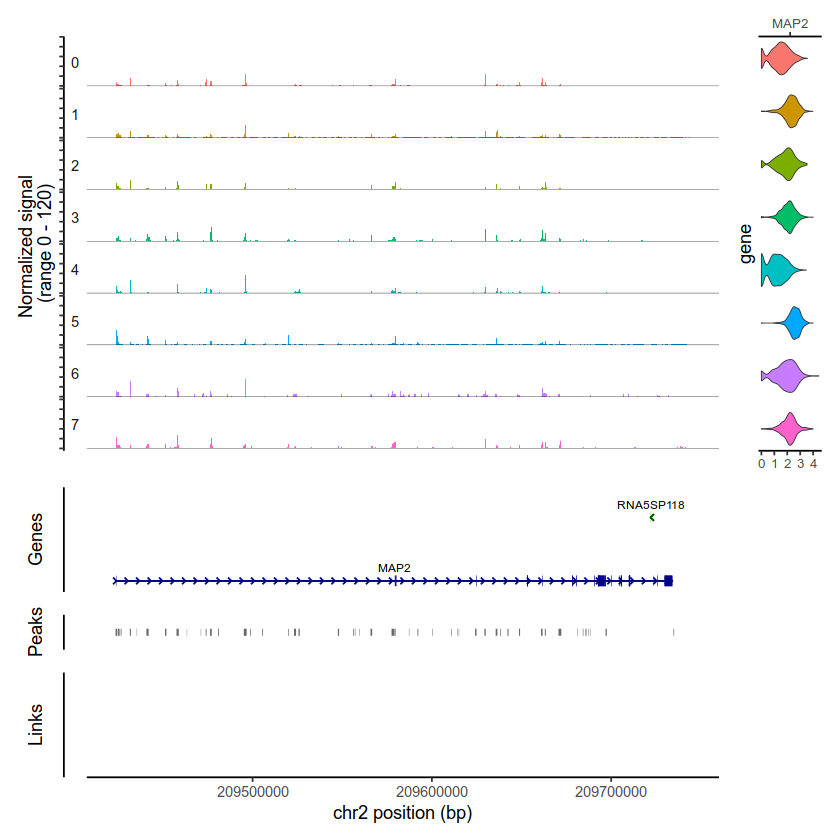

In [295]:
p2 <- CoveragePlot(
  object = peaklink,
  region = "MAP2",
  features = "MAP2",
  expression.assay = "CCA_RNA",
#  idents = c("0","1","2"),
  extend.upstream = 500,
  extend.downstream = 10000
)
patchwork::wrap_plots(p2, ncol = 1)

In [296]:
pdf("link.scatac.without.filter.pdf")
patchwork::wrap_plots(p1, ncol = 1)
patchwork::wrap_plots(p2, ncol = 1)
dev.off()

Warning message:
"Removed 51 rows containing non-finite values (`stat_ydensity()`)."
Warning message:
"Removed 23 rows containing missing values (`geom_segment()`)."
Warning message:
"Removed 17 rows containing non-finite values (`stat_ydensity()`)."


png 
  2

In [297]:
DefaultAssay(subset_seurat) <- "CCA_RNA"

variable<-FindVariableFeatures(subset_seurat,method="vst",nfeatures=8000,verbose=T)
gene_name<-VariableFeatures(variable)

Warning message in FindVariableFeatures.Assay(object = assay.data, selection.method = selection.method, :
"selection.method set to 'vst' but count slot is empty; will use data slot instead"
Warning message:
"The following arguments are not used: method"
Warning message in eval(predvars, data, env):
"NaNs produced"
Warning message in hvf.info$variance.expected[not.const] <- 10^fit$fitted:
"number of items to replace is not a multiple of replacement length"


In [298]:
peaklink2 <- LinkPeaks(
  object = subset_seurat,
    distance = 500000,
  min.cells = 1000,
  peak.assay = "peaks",
  expression.assay = "CCA_RNA",
 genes.use = gene_name
)

Testing 1720 genes and 11363 peaks

Found gene coordinates for 1319 genes

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiproces

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly sp

R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-2') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-3') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-4') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-5') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-6') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-7') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-8') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-9') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-10') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-11') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-12') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-13') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-14') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-15') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-16') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-17') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-18') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-19') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-20') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-21') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-22') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-23') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-24') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-25') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-26') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-27') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-28') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-29') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-30') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-31') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-32') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-33') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-34') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-35') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-36') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-37') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-38') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-39') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-40') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-41') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-42') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-43') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-44') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-45') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-47') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-48') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-49') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-50') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


In [299]:
table<-data.frame(peaklink2@assays$peaks@links)


In [300]:
table2<-table[which(table$pvalue < 0.01),]

In [301]:
unique(table2$gene)

[1] "ID3"         "MAN1C1"      "CSMD2"       "RNF220"      "KIF2C"      
  [6] "CACHD1"      "SLC44A5"     "CCDC18"      "F3"          "NTNG1"      
 [11] "KCND3"       "SYT6"        "KCNN3"       "C1orf61"     "FAM78B"     
 [16] "ATP1B1"      "RGS16"       "KLHDC8A"     "LEMD1"       "KCNH1"      
 [21] "SUSD4"       "LYST"        "NID1"        "PXDN"        "VSNL1"      
 [26] "LONRF2"      "CKAP2L"      "GPR39"       "GAD1"        "FN1"        
 [31] "ARL4C"       "AGAP1"       "HES6"        "SNED1"       "HRH1"       
 [36] "NEK10"       "LIMD1"       "FHIT"        "GAP43"       "POLQ"       
 [41] "MED12L"      "P2RY14"      "MECOM"       "USP53"       "MAML3"      
 [46] "SNX25"       "AHRR"        "BASP1"       "SLC1A3"      "MAP3K1"     
 [51] "ARHGEF28"    "IQGAP2"      "LOX"         "LMNB1"       "SPRY4"      
 [56] "ARHGAP26"    "KCNIP1"      "ID4"         "CASC15"      "HLA-DPA1"   
 [61] "CD24"        "MFSD4B"      "REV3L"       "UST"         "PPP1R14C"   
 [66] "RGS17"       "SDK1"        "NXPH1"       "MPP6"        "CREB5"      
 [71] "ZNRF2"       "PDE1C"       "BMPER"       "EEPD1"       "HECW1"      
 [76] "TNS3"        "ABCA13"      "GRB10"       "COBL"        "EGFR"       
 [81] "LANCL2"      "VOPP1"       "ZNF713"      "PSPH"        "CCT6A"      
 [86] "CHCHD2"      "HIP1"        "SEMA3E"      "DYNC1I1"     "SERPINE1"   
 [91] "LRRC17"      "LHFPL3"      "CDHR3"       "DOCK4"       "CAV1"       
 [96] "MET"         "PODXL"       "CALD1"       "PTN"         "DGKI"       
[101] "TMEM178B"    "EZH2"        "DPP6"        "PTPRN2"      "NEFM"       
[106] "NEFL"        "DOCK5"       "CDCA2"       "RGS20"       "NKAIN3"     
[111] "ZNF704"      "PMP2"        "RIMS2"       "COL14A1"     "COL22A1"    
[116] "RFX3-AS1"    "MLLT3"       "TPM2"        "PRUNE2"      "GADD45G"    
[121] "GABBR2"      "ABCA1"       "PALM2-AKAP2" "TNC"         "DEC1"       
[126] "PDE3B"       "NAV2"        "LGR4"        "HIPK3"       "KIAA1549L"  
[131] "SLC1A2"      "LDLRAD3"     "LRP4"        "FAM111B"     "NEAT1"      
[136] "GAB2"        "DSCAML1"     "GRIK4"       "CDON"        "TSPAN9"     
[141] "CCND2"       "METTL7B"     "NUP107"      "SLC35E3"     "MDM2"       
[146] "CPM"         "E2F7"        "CHST11"      "NUAK1"       "RFX4"       
[151] "TMEM132B"    "DCLK1"       "ENOX1"       "TRIM9"       "MEG8"       
[156] "FBN1"        "SHC4"        "NTRK3"       "CCNF"        "ARL6IP1"    
[161] "SYT17"       "ZNF423"      "LPCAT2"      "VAT1L"       "WSCD1"      
[166] "AURKB"       "MFAP4"       "SLC47A2"     "KIF18B"      "EFTUD2"     
[171] "GFAP"        "MAPT"        "HOXB4"       "ABCC3"       "CACNG5"     
[176] "LINC00511"   "ITGB4"       "EPB41L3"     "LDLRAD4"     "NOL4"       
[181] "SLC14A1"     "LIPG"        "CD226"       "RTTN"        "UHRF1"      
[186] "CACNA1A"     "TTYH1"       "SNAP25"      "KIZ"         "KIAA1755"   
[191] "NTSR1"       "NKAIN4"      "COL20A1"     "OLIG2"       "OLIG1"      
[196] "KCNJ6"       "COL6A1"      "COL6A2"      "SEZ6L"       "GTSE1"

In [302]:
num<-as.numeric(table(as.character(table2$gene)))

In [303]:
table(num)

num
  1   2   3   4   5   6   8  10  12  25 
155  21  13   2   4   1   1   1   1   1 

In [304]:
names(table(num))

[1] "1"  "2"  "3"  "4"  "5"  "6"  "8"  "10" "12" "25"

In [305]:
data.frame(name=c(names(table(num))[1:7],">8"),value=c(as.numeric(table(num))[1:7],18))
table3<-data.frame(name=as.character(c(names(table(num))[1:7],">8")),value=c(as.numeric(table(num))[1:7],18))

name,value
<chr>,<dbl>
1,155
2,21
3,13
4,2
5,4
6,1
8,1
>8,18


In [306]:
table3

name,value
<chr>,<dbl>
1,155
2,21
3,13
4,2
5,4
6,1
8,1
>8,18


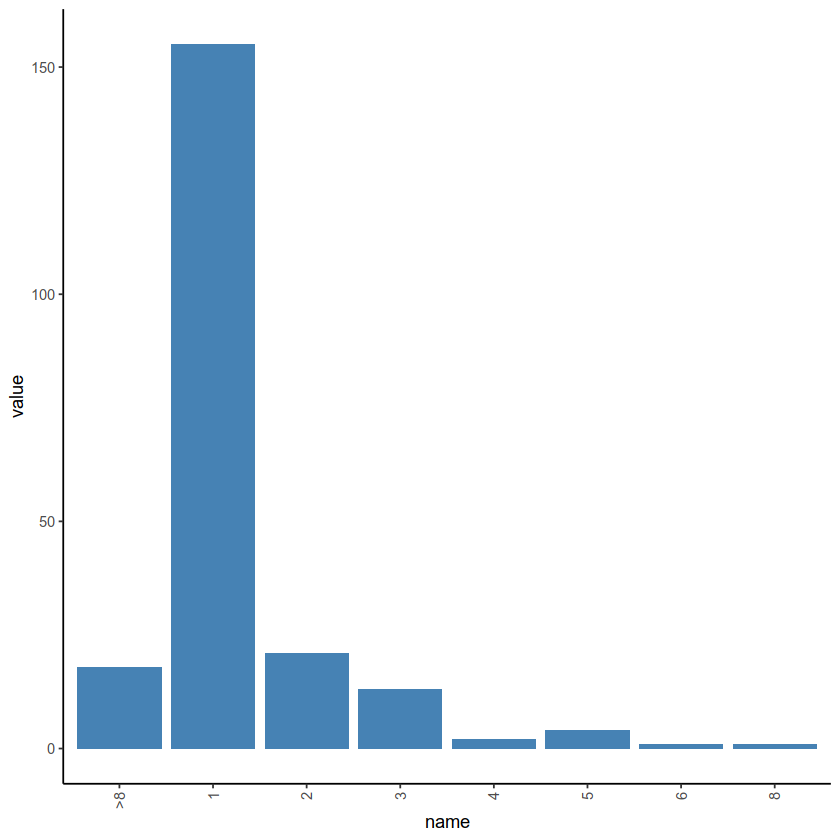

In [307]:
library(ggplot2)
ggplot(table3, aes( y=value, x=name))+geom_bar(stat="identity", fill="steelblue")+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))

In [308]:
pdf("barplot.all.pdf")
ggplot(table3, aes( y=value, x=name))+geom_bar(stat="identity", fill="steelblue")+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))
dev.off()

png 
  2